In [1]:
# Import Libraries
import pandas as pd 
import yfinance as yfin
import numpy as np
import seaborn as sns
import matplotlib as mpl
import datetime as dt
import nltk
import math
from datetime import datetime
import time
import lightgbm as lgb
import string
import tensorflow as tf
import keras_tuner as kt

# Plots
# ==============================================================================
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')
plt.rcParams['lines.linewidth'] = 1.5
%matplotlib inline
from pandas.plotting import autocorrelation_plot
from pandas.plotting import lag_plot

# Modeling and Forecasting
# ==============================================================================
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import grangercausalitytests
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.pipeline import make_pipeline
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import cross_val_score

from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.tsa.statespace.varmax import VARMAX
from dateutil.parser import parse

from skforecast.ForecasterAutoreg import ForecasterAutoreg
from skforecast.ForecasterAutoregCustom import ForecasterAutoregCustom
# from skforecast.ForecasterAutoregMultiOutput import ForecasterAutoregMultiOutput
from skforecast.model_selection import grid_search_forecaster
from skforecast.model_selection import backtesting_forecaster
from joblib import dump, load
from skforecast.utils import save_forecaster

from scipy import signal
from scipy.interpolate import interp1d

from keras.models import Sequential
from keras.layers import Dense, LSTM
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import LSTM
from tensorflow.keras.layers import Dropout


from nltk.stem import LancasterStemmer
from nltk.stem import WordNetLemmatizer
from string import punctuation
from nltk.corpus import stopwords
from nltk.sentiment import SentimentIntensityAnalyzer

#relax the display limits on columns and rows
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

from skopt.space import Real, Integer
from skopt.utils import use_named_args
from skopt import gp_minimize
from skopt.plots import plot_convergence


# Warnings configuration
# ==============================================================================
import warnings
warnings.filterwarnings('ignore')

# Read in Files 

In [3]:
AAPL_df = pd.read_csv('C:/Users/clair/Desktop/integrated-ca2-claireobrien00/Data/AAPL_Spark_SQL', parse_dates=['Date'])
AAPL_df.set_index('Date', inplace=True)
close_AAPL = AAPL_df.pop('Close')  # Remove column 'B' and store it
AAPL_df['Close'] = close_AAPL

AMZN_df = pd.read_csv('C:/Users/clair/Desktop/integrated-ca2-claireobrien00/Data/AMZN_Spark_SQL', parse_dates=['Date'])
AMZN_df.set_index('Date', inplace=True)
close_AMZN = AMZN_df.pop('Close')  # Remove column 'B' and store it
AMZN_df['Close'] = close_AMZN

BA_df = pd.read_csv('C:/Users/clair/Desktop/integrated-ca2-claireobrien00/Data/BA_Spark_SQL', parse_dates=['Date'])
BA_df.set_index('Date', inplace=True)
close_BA = BA_df.pop('Close')  # Remove column 'B' and store it
BA_df['Close'] = close_BA

DIS_df = pd.read_csv('C:/Users/clair/Desktop/integrated-ca2-claireobrien00/Data/DIS_Spark_SQL', parse_dates=['Date'])
DIS_df.set_index('Date', inplace=True)
close_DIS = DIS_df.pop('Close')  # Remove column 'B' and store it
DIS_df['Close'] = close_DIS

TSLA_df = pd.read_csv('C:/Users/clair/Desktop/integrated-ca2-claireobrien00/Data/TSLA_Spark_SQL', parse_dates=['Date'])
TSLA_df.set_index('Date', inplace=True)
close_TSLA = TSLA_df.pop('Close')  # Remove column 'B' and store it
TSLA_df['Close'] = close_TSLA

tweet_df = pd.read_csv('C:/Users/clair/Desktop/integrated-ca2-claireobrien00/Data/tweet_data_cassandra')

In [4]:
AAPL_df.head()

,Open,High,Low,Adj_Close,Volume,Close
Date,,,,,,
2019-12-31,72.4825,73.420,72.3800,71.5208,100806000.0,73.4125
2020-01-02,74.0600,75.150,73.7975,73.1526,135480000.0,75.0875
2020-01-03,74.2875,75.145,74.1250,72.4415,146323000.0,74.3575
2020-01-06,73.4475,74.990,73.1875,73.0187,118387000.0,74.9500
2020-01-07,74.9600,75.225,74.3700,72.6753,108872000.0,74.5975


In [5]:
AMZN_df.head()

,Open,High,Low,Adj_Close,Volume,Close
Date,,,,,,
2019-12-31,92.100,92.6630,91.6115,92.3920,50130000.0,92.3920
2020-01-02,93.750,94.9005,93.2075,94.9005,80580000.0,94.9005
2020-01-03,93.225,94.3100,93.2250,93.7485,75288000.0,93.7485
2020-01-06,93.000,95.1845,93.0000,95.1440,81236000.0,95.1440
2020-01-07,95.225,95.6945,94.6020,95.3430,80898000.0,95.3430


In [6]:
BA_df.head()

,Open,High,Low,Adj_Close,Volume,Close
Date,,,,,,
2019-12-31,325.41,326.57,323.32,323.833,4958800.0,325.76
2020-01-02,328.55,333.35,327.70,331.349,4544400.0,333.32
2020-01-03,330.63,334.89,330.30,330.792,3875900.0,332.76
2020-01-06,329.30,334.86,327.88,331.766,5355000.0,333.74
2020-01-07,334.26,344.19,330.71,335.285,9898600.0,337.28


In [7]:
DIS_df.head()

,Open,High,Low,Adj_Close,Volume,Close
Date,,,,,,
2019-12-31,143.67,144.77,143.26,144.160,5662900.0,144.63
2020-01-02,145.29,148.20,145.10,147.719,9502100.0,148.20
2020-01-03,146.40,147.90,146.05,146.024,7320200.0,146.50
2020-01-06,145.54,146.03,144.31,145.177,8262500.0,145.65
2020-01-07,145.99,146.87,145.42,145.227,6906500.0,145.70


In [8]:
TSLA_df.head()

,Open,High,Low,Adj_Close,Volume,Close
Date,,,,,,
2019-12-31,27.0000,28.0860,26.8053,27.8887,154286000.0,27.8887
2020-01-02,28.3000,28.7133,28.1140,28.6840,142982000.0,28.6840
2020-01-03,29.3667,30.2667,29.1280,29.5340,266678000.0,29.5340
2020-01-06,29.3647,30.1040,29.3333,30.1027,151995000.0,30.1027
2020-01-07,30.7600,31.4420,30.2240,31.2707,268232000.0,31.2707


## Global Variables/Functions

In [10]:
start_date = AAPL_df.index.min()
end_date = AAPL_df.index.max()

# Create a complete date range
full_index = pd.date_range(start=start_date, end=end_date, freq='D')

In [11]:
exog = ['compound_score', 'Open',	'High',	'Low',	'Adj_Close',	'Volume',	'Close']

In [12]:
punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [13]:
def get_text_processing(text):
    stpword = stopwords.words('english')
    no_punctuation = [char for char in text if char not in string.punctuation]
    no_punctuation = ''.join(no_punctuation)
    return ' '.join([word for word in no_punctuation.split() if word.lower() not in stpword])

In [14]:
def average_by_date(df, column_name):
    # Group by the index and calculate the mean for the specified column
    averaged_df = df.groupby(df.index.date)[column_name].mean()
    
    # Convert the Series back to a DataFrame and reset the index
    averaged_df = averaged_df.reset_index()
    
    # Rename the columns for clarity
    averaged_df.columns = ['date', column_name]
    
    # Convert the 'date' column back to datetime if needed
    averaged_df['date'] = pd.to_datetime(averaged_df['date'])
    
    # Set the date column as the index
    averaged_df.set_index('date', inplace=True)
    
    return averaged_df

In [15]:
def plot_df_trendlines(df, x, y, title="", xlabel='Date', ylabel='Value', dpi=100):
    plt.figure(figsize=(16,5), dpi=dpi)
    plt.plot(x, y, color='tab:red')
    plt.gca().set(title=title, xlabel=xlabel, ylabel=ylabel)
    plt.show()

In [16]:
def plot_df_one_graph(df, title="", xlabel='Date', ylabel='Value', dpi=100):
    plt.figure(figsize=(16, 5), dpi=dpi)
    
    # Loop through the first 5 columns to plot
    for column in df.columns[:4]:  # Only the first 5 columns
        plt.plot(df.index, df[column], label=column)  # Plot each column with a label
    
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.legend()  # Show legend   # Optional: add grid for better readability
    plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
    plt.tight_layout()  # Adjust layout to prevent clipping
    plt.show()

In [17]:
def ApEn(U, m, r):
    """Compute Aproximate entropy"""
    def _maxdist(x_i, x_j):
        return max([abs(ua - va) for ua, va in zip(x_i, x_j)])

    def _phi(m):
        x = [[U[j] for j in range(i, i + m - 1 + 1)] for i in range(N - m + 1)]
        C = [len([1 for x_j in x if _maxdist(x_i, x_j) <= r]) / (N - m + 1.0) for x_i in x]
        return (N - m + 1.0)**(-1) * sum(np.log(C))

    N = len(U)
    return abs(_phi(m+1) - _phi(m))

In [18]:
def SampEn(U, m, r):
    """Compute Sample entropy"""
    def _maxdist(x_i, x_j):
        return max([abs(ua - va) for ua, va in zip(x_i, x_j)])

    def _phi(m):
        x = [[U[j] for j in range(i, i + m - 1 + 1)] for i in range(N - m + 1)]
        C = [len([1 for j in range(len(x)) if i != j and _maxdist(x[i], x[j]) <= r]) for i in range(len(x))]
        return sum(C)

    N = len(U)
    return -np.log(_phi(m+1) / _phi(m))

# 1. Text Analysis

In [20]:
tweet_df.set_index('id', inplace=True)
tweet_df = tweet_df.sort_values(by='id', ascending=True)
tweet_df.head()

,date,ticker,tweet
id,,,
100001,01/01/2020,AMZN,$AMZN Dow futures up by 100 points already 🥳
100002,01/01/2020,TSLA,$TSLA Daddy's drinkin' eArly tonight! Here's t...
100003,01/01/2020,AAPL,$AAPL We’ll been riding since last December fr...
100004,01/01/2020,TSLA,"$TSLA happy new year, 2020, everyone🍷🎉🙏"
100005,01/01/2020,TSLA,"$TSLA haha just a collection of greats...\""Mar..."


In [21]:
sia = SentimentIntensityAnalyzer()

## 1. AAPL

In [23]:
AAPL_tweet_df = tweet_df[tweet_df['ticker'] == 'AAPL']
AAPL_tweet_df.shape

(1721, 3)

In [24]:
AAPL_tweet_df['cleaned'] = AAPL_tweet_df['tweet'].apply(get_text_processing)

In [25]:
AAPL_tweet_df['sentiment_scores'] = AAPL_tweet_df['tweet'].apply(sia.polarity_scores)
AAPL_tweet_df['compound_score'] = AAPL_tweet_df['tweet'].apply(
    lambda tweet: sia.polarity_scores(tweet)['compound']
)

In [26]:
AAPL_tweet_compound_score_df = AAPL_tweet_df[['date','compound_score']]
AAPL_tweet_compound_score_df.dtypes

date               object
compound_score    float64
dtype: object

In [27]:
AAPL_tweet_compound_score_df.loc[:, 'date'] = pd.to_datetime(AAPL_tweet_compound_score_df['date'], format='%d/%m/%Y')
AAPL_tweet_compound_score_df.set_index('date', inplace=True)

In [28]:
AAPL_tweet_compound_score_df.sort_index(inplace=True)
AAPL_tweet_compound_score_df = AAPL_tweet_compound_score_df.copy()

In [29]:
averaged_AAPL_df = average_by_date(AAPL_tweet_compound_score_df, 'compound_score')
averaged_AAPL_df = averaged_AAPL_df.reindex(full_index)
averaged_AAPL_df.fillna(0, inplace=True)

In [30]:
result_AAPL = averaged_AAPL_df.join(AAPL_df, how='outer')
result_AAPL.shape

(367, 7)

## 2. AMZN

In [32]:
AMZN_tweet_df = tweet_df[tweet_df['ticker'] == 'AMZN']
AMZN_tweet_df.shape

(406, 3)

In [33]:
AMZN_tweet_df['cleaned'] = AMZN_tweet_df['tweet'].apply(get_text_processing)

In [34]:
AMZN_tweet_df['sentiment_scores'] = AMZN_tweet_df['tweet'].apply(sia.polarity_scores)
AMZN_tweet_df['compound_score'] = AMZN_tweet_df['tweet'].apply(
    lambda tweet: sia.polarity_scores(tweet)['compound']
)

In [35]:
AMZN_tweet_compound_score_df = AMZN_tweet_df[['date','compound_score']]
AMZN_tweet_compound_score_df.dtypes

date               object
compound_score    float64
dtype: object

In [36]:
AMZN_tweet_compound_score_df.loc[:, 'date'] = pd.to_datetime(AMZN_tweet_compound_score_df['date'], format='%d/%m/%Y')
AMZN_tweet_compound_score_df.set_index('date', inplace=True)

In [37]:
AMZN_tweet_compound_score_df.sort_index(inplace=True)
AMZN_tweet_compound_score_df = AMZN_tweet_compound_score_df.copy()

In [38]:
averaged_AMZN_df = average_by_date(AMZN_tweet_compound_score_df, 'compound_score')
averaged_AMZN_df = averaged_AMZN_df.reindex(full_index)
averaged_AMZN_df.fillna(0, inplace=True)

In [39]:
result_AMZN = averaged_AMZN_df.join(AMZN_df, how='outer')

In [40]:
result_AMZN.shape

(367, 7)

## 3. BA

In [42]:
BA_tweet_df = tweet_df[tweet_df['ticker'] == 'BA']
BA_tweet_df.shape

(918, 3)

In [43]:
BA_tweet_df['cleaned'] = BA_tweet_df['tweet'].apply(get_text_processing)

In [44]:
BA_tweet_df['sentiment_scores'] = BA_tweet_df['tweet'].apply(sia.polarity_scores)
BA_tweet_df['compound_score'] = BA_tweet_df['tweet'].apply(
    lambda tweet: sia.polarity_scores(tweet)['compound']
)
BA_tweet_compound_score_df = BA_tweet_df[['date','compound_score']]
BA_tweet_compound_score_df.loc[:, 'date'] = pd.to_datetime(BA_tweet_compound_score_df['date'], format='%d/%m/%Y')
BA_tweet_compound_score_df.set_index('date', inplace=True)
BA_tweet_compound_score_df.sort_index(inplace=True)
BA_tweet_compound_score_df = BA_tweet_compound_score_df.copy()
averaged_BA_df = average_by_date(BA_tweet_compound_score_df, 'compound_score')
averaged_BA_df = averaged_BA_df.reindex(full_index)
averaged_BA_df.fillna(0, inplace=True)
result_BA = averaged_BA_df.join(BA_df, how='outer')
result_BA.shape

(367, 7)

## 4. DIS

In [46]:
DIS_tweet_df = tweet_df[tweet_df['ticker'] == 'DIS']
DIS_tweet_df.shape

(431, 3)

In [47]:
DIS_tweet_df['cleaned'] = DIS_tweet_df['tweet'].apply(get_text_processing)

In [48]:
DIS_tweet_df['sentiment_scores'] = DIS_tweet_df['tweet'].apply(sia.polarity_scores)
DIS_tweet_df['compound_score'] = DIS_tweet_df['tweet'].apply(
    lambda tweet: sia.polarity_scores(tweet)['compound']
)
DIS_tweet_compound_score_df = DIS_tweet_df[['date','compound_score']]
DIS_tweet_compound_score_df.loc[:, 'date'] = pd.to_datetime(DIS_tweet_compound_score_df['date'], format='%d/%m/%Y')
DIS_tweet_compound_score_df.set_index('date', inplace=True)
DIS_tweet_compound_score_df.sort_index(inplace=True)
DIS_tweet_compound_score_df = DIS_tweet_compound_score_df.copy()
averaged_DIS_df = average_by_date(DIS_tweet_compound_score_df, 'compound_score')
averaged_DIS_df = averaged_DIS_df.reindex(full_index)
averaged_DIS_df.fillna(0, inplace=True)
result_DIS = averaged_DIS_df.join(DIS_df, how='outer')
result_DIS.shape

(367, 7)

## 5. TSLA

In [50]:
TSLA_tweet_df = tweet_df[tweet_df['ticker'] == 'TSLA']
TSLA_tweet_df.shape

(4332, 3)

In [51]:
TSLA_tweet_df['cleaned'] = TSLA_tweet_df['tweet'].apply(get_text_processing)

In [52]:
TSLA_tweet_df['sentiment_scores'] = TSLA_tweet_df['tweet'].apply(sia.polarity_scores)
TSLA_tweet_df['compound_score'] = TSLA_tweet_df['tweet'].apply(
    lambda tweet: sia.polarity_scores(tweet)['compound']
)
TSLA_tweet_compound_score_df = TSLA_tweet_df[['date','compound_score']]
TSLA_tweet_compound_score_df.loc[:, 'date'] = pd.to_datetime(TSLA_tweet_compound_score_df['date'], format='%d/%m/%Y')
TSLA_tweet_compound_score_df.set_index('date', inplace=True)
TSLA_tweet_compound_score_df.sort_index(inplace=True)
TSLA_tweet_compound_score_df = TSLA_tweet_compound_score_df.copy()
averaged_TSLA_df = average_by_date(TSLA_tweet_compound_score_df, 'compound_score')
averaged_TSLA_df = averaged_TSLA_df.reindex(full_index)
averaged_TSLA_df.fillna(0, inplace=True)
result_TSLA = averaged_TSLA_df.join(TSLA_df, how='outer')
result_TSLA.head()

,compound_score,Open,High,Low,Adj_Close,Volume,Close
2019-12-31,0.000000,27.0000,28.0860,26.8053,27.8887,154286000.0,27.8887
2020-01-01,0.118400,NaN,NaN,NaN,NaN,NaN,NaN
2020-01-02,-0.329100,28.3000,28.7133,28.1140,28.6840,142982000.0,28.6840
2020-01-03,0.046483,29.3667,30.2667,29.1280,29.5340,266678000.0,29.5340
2020-01-04,-0.318200,NaN,NaN,NaN,NaN,NaN,NaN


# 2. EDA and Visualisations 

## 1. AAPL

In [55]:
AAPL_df.isnull().sum() # No Null values in any of the datasets

Open         0
High         0
Low          0
Adj_Close    0
Volume       0
Close        0
dtype: int64

In [56]:
AAPL_df.dtypes

Open         float64
High         float64
Low          float64
Adj_Close    float64
Volume       float64
Close        float64
dtype: object

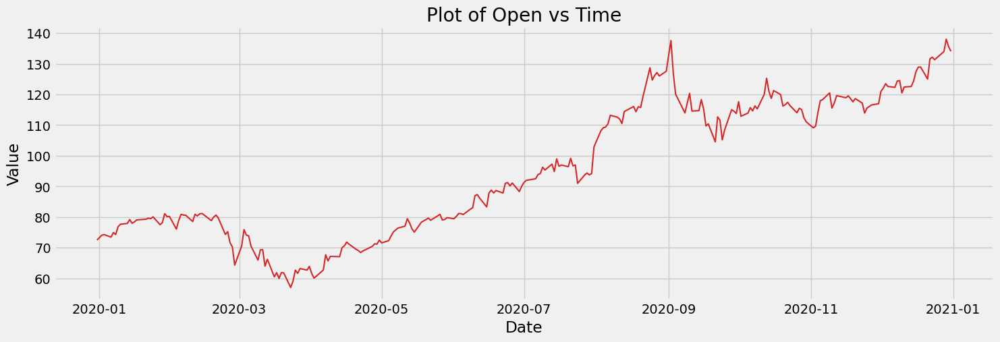

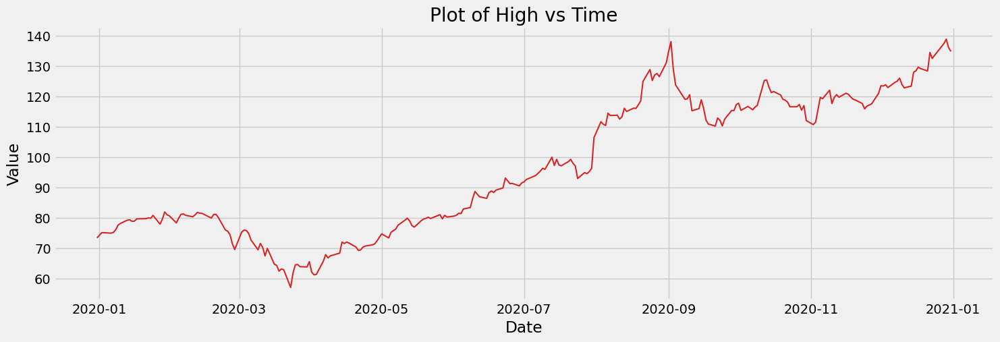

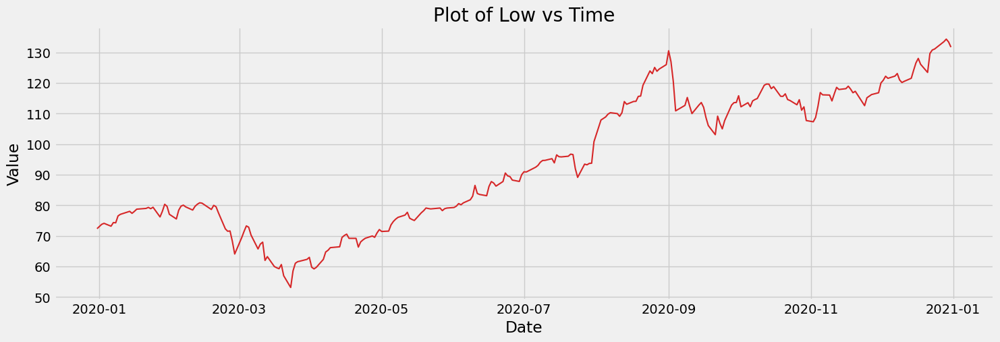

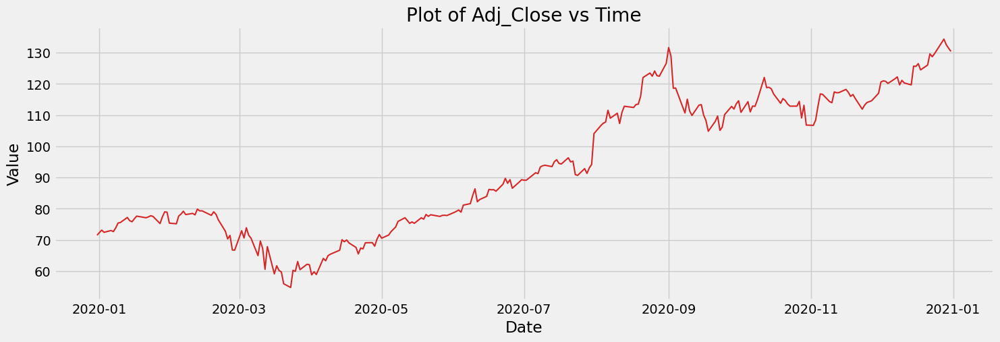

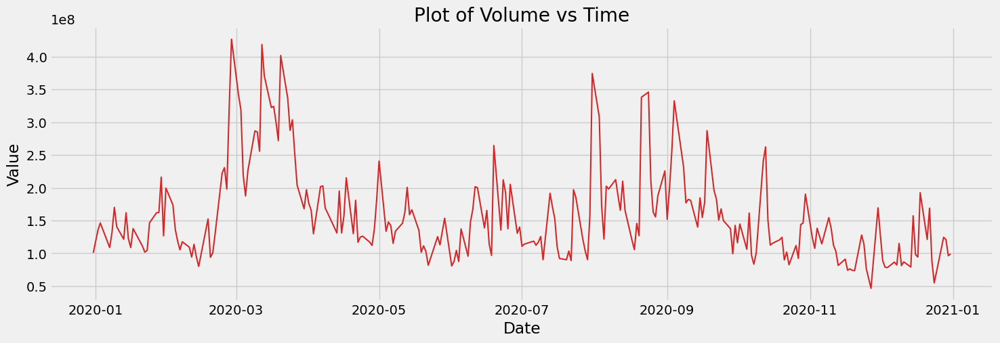

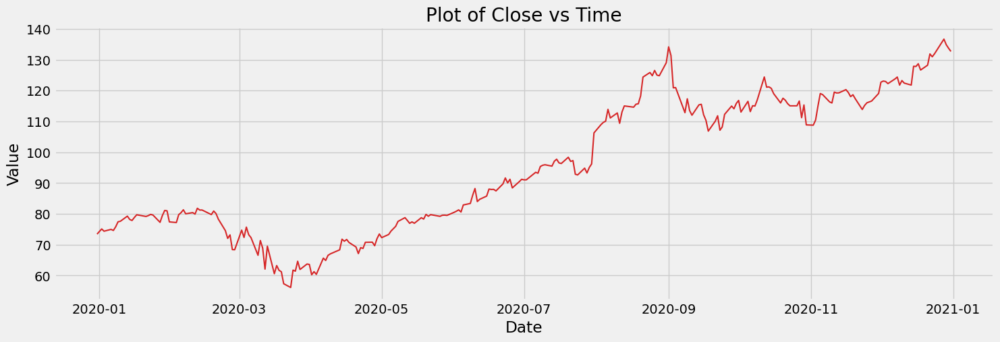

In [57]:
for column in AAPL_df.columns:
    plot_df_trendlines(AAPL_df, x=AAPL_df.index, y=AAPL_df[column], title=f'Plot of {column} vs Time')

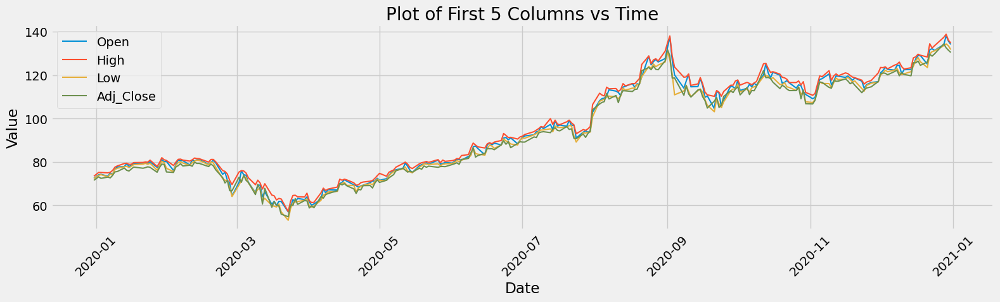

In [58]:
plot_df_one_graph(AAPL_df, title='Plot of First 5 Columns vs Time')

matplotlib.category INFO  Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
matplotlib.category INFO  Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


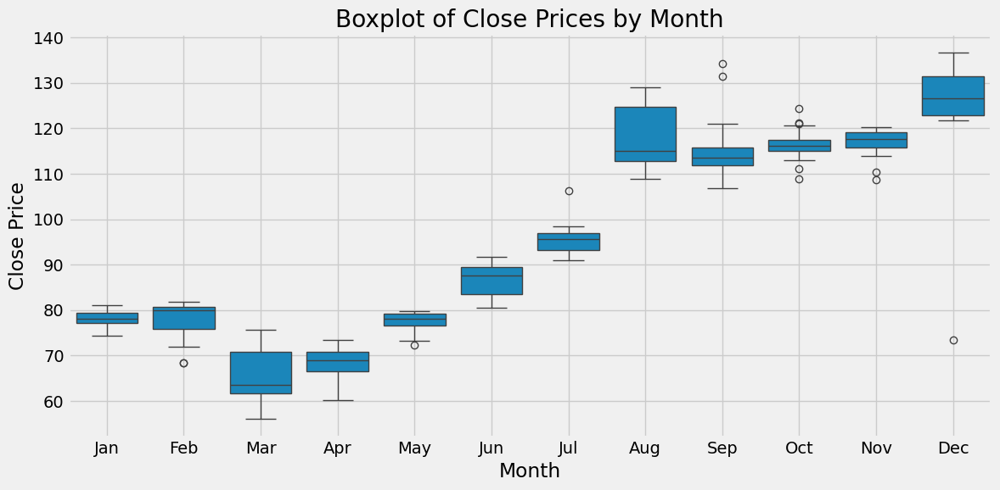

In [59]:
AAPL_df['month'] = AAPL_df.index.month

# Create boxplot
plt.figure(figsize=(12, 6))
sns.boxplot(x='month', y='Close', data=AAPL_df)
plt.title('Boxplot of Close Prices by Month')
plt.xlabel('Month')
plt.ylabel('Close Price')
plt.xticks(ticks=range(12), labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 
                                      'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
plt.tight_layout()
plt.show()
AAPL_df = AAPL_df.drop('month', axis=1)

<Axes: title={'center': 'Seasonal Mean'}>

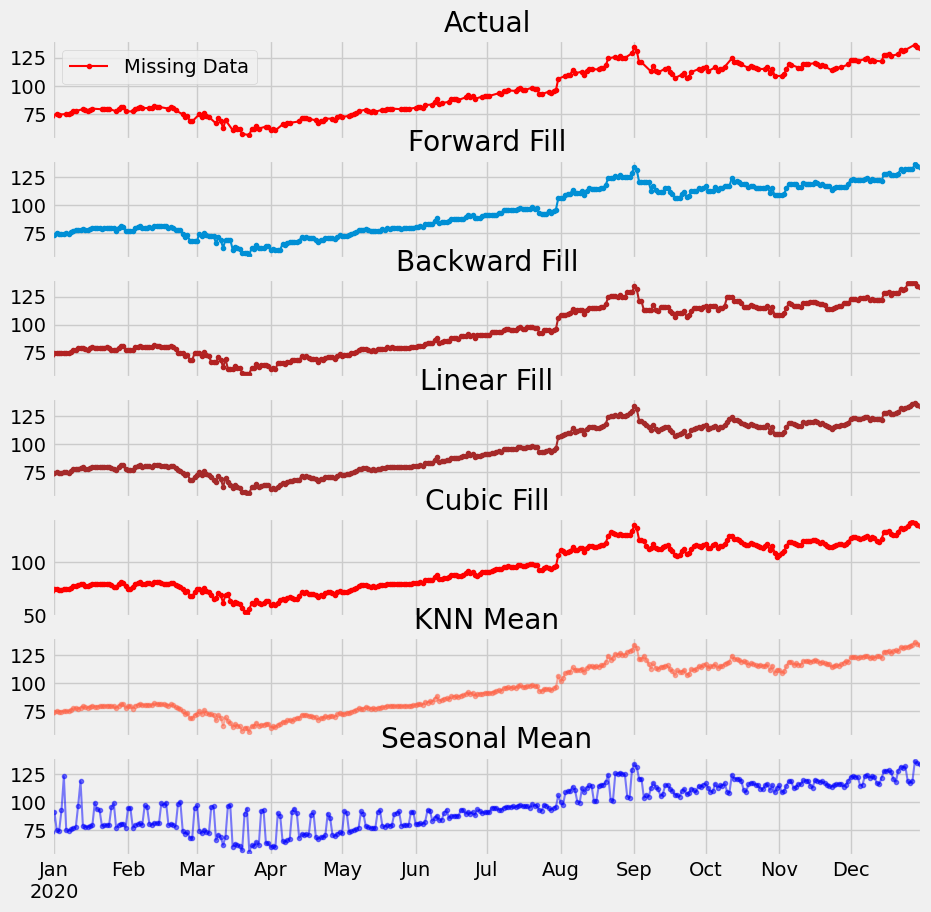

In [60]:
fig, axes = plt.subplots(7, 1, sharex=True, figsize=(10, 12))
plt.rcParams.update({'xtick.bottom' : False})


## 1. Actual -------------------------------
AAPL_Close_df = pd.DataFrame(AAPL_df['Close'])
AAPL_Close_df.plot(title='Actual', ax=axes[0], label='Actual', color='red', style=".-")
axes[0].legend(["Missing Data", "Available Data"])

## 2. Forward Fill --------------------------
df_ffill = result_AAPL.ffill()
# error = np.round(mean_squared_error(AAPL_Close_all_dates_df['Close'], df_ffill['Close']), 2)
df_ffill['Close'].plot(title='Forward Fill', ax=axes[1], label='Forward Fill', style=".-")


# 3. Backward Fill -------------------------
df_bfill = result_AAPL.bfill()
# error = np.round(mean_squared_error(df_orig['value'], df_bfill['value']), 2)
df_bfill['Close'].plot(title="Backward Fill", ax=axes[2], label='Back Fill', color='firebrick', style=".-")

## 4. Linear Interpolation ------------------
result_AAPL['rownum'] = range(1, len(result_AAPL) + 1)

result_AAPL['rownum'] = np.arange(result_AAPL.shape[0])
df_nona = result_AAPL.dropna(subset = ['Close'])
f = interp1d(df_nona['rownum'], df_nona['Close'])
result_AAPL['linear_fill'] = f(result_AAPL['rownum'])
# error = np.round(mean_squared_error(df_orig['value'], df['linear_fill']), 2)
result_AAPL['linear_fill'].plot(title="Linear Fill", ax=axes[3], label='Cubic Fill', color='brown', style=".-")

## 5. Cubic Interpolation --------------------
f2 = interp1d(df_nona['rownum'], df_nona['Close'], kind='cubic')
result_AAPL['cubic_fill'] = f2(result_AAPL['rownum'])
# error = np.round(mean_squared_error(df_orig['value'], df['cubic_fill']), 2)
result_AAPL['cubic_fill'].plot(title="Cubic Fill", ax=axes[4], label='Cubic Fill', color='red', style=".-")

# Interpolation References:
# https://docs.scipy.org/doc/scipy/reference/tutorial/interpolate.html
# https://docs.scipy.org/doc/scipy/reference/interpolate.html

## 6. Mean of 'n' Nearest Past Neighbors ------
def knn_mean(ts, n):
    out = np.copy(ts)
    for i, val in enumerate(ts):
        if np.isnan(val):
            n_by_2 = np.ceil(n/2)
            lower = np.max([0, int(i-n_by_2)])
            upper = np.min([len(ts)+1, int(i+n_by_2)])
            ts_near = np.concatenate([ts[lower:i], ts[i:upper]])
            out[i] = np.nanmean(ts_near)
    return out

result_AAPL['knn_mean'] = knn_mean(result_AAPL['Close'].values, 8)
# error = np.round(mean_squared_error(df_orig['value'], df['knn_mean']), 2)
result_AAPL['knn_mean'].plot(title="KNN Mean", ax=axes[5], label='KNN Mean', color='tomato', alpha=0.5, style=".-")

## 7. Seasonal Mean ----------------------------
def seasonal_mean(ts, n, lr=0.7):
    """
    Compute the mean of corresponding seasonal periods
    ts: 1D array-like of the time series
    n: Seasonal window length of the time series
    """
    out = np.copy(ts)
    for i, val in enumerate(ts):
        if np.isnan(val):
            ts_seas = ts[i-1::-n]  # previous seasons only
            if np.isnan(np.nanmean(ts_seas)):
                ts_seas = np.concatenate([ts[i-1::-n], ts[i::n]])  # previous and forward
            out[i] = np.nanmean(ts_seas) * lr
    return out

result_AAPL['seasonal_mean'] = seasonal_mean(result_AAPL['Close'], n=12, lr=1.25)
# error = np.round(mean_squared_error(df_orig['value'], df['seasonal_mean']), 2)
result_AAPL['seasonal_mean'].plot(title="Seasonal Mean", ax=axes[6], label='Seasonal Mean', color='blue', alpha=0.5, style=".-")

In [61]:
AAPL_all_dates_KNN_df = result_AAPL.apply(lambda col: knn_mean(col.values, 8), axis=0)
AAPL_all_dates_KNN_df = AAPL_all_dates_KNN_df.drop(['rownum', 'linear_fill',	'cubic_fill', 'knn_mean', 'seasonal_mean'], axis=1)

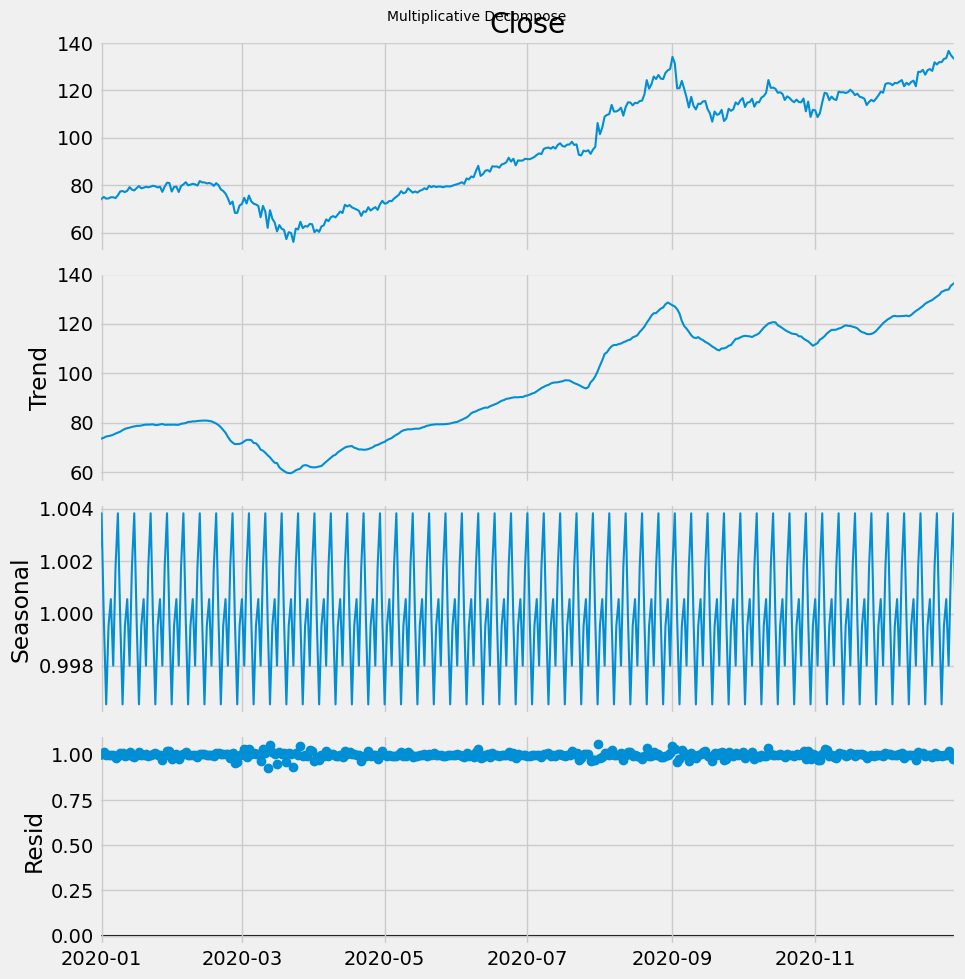

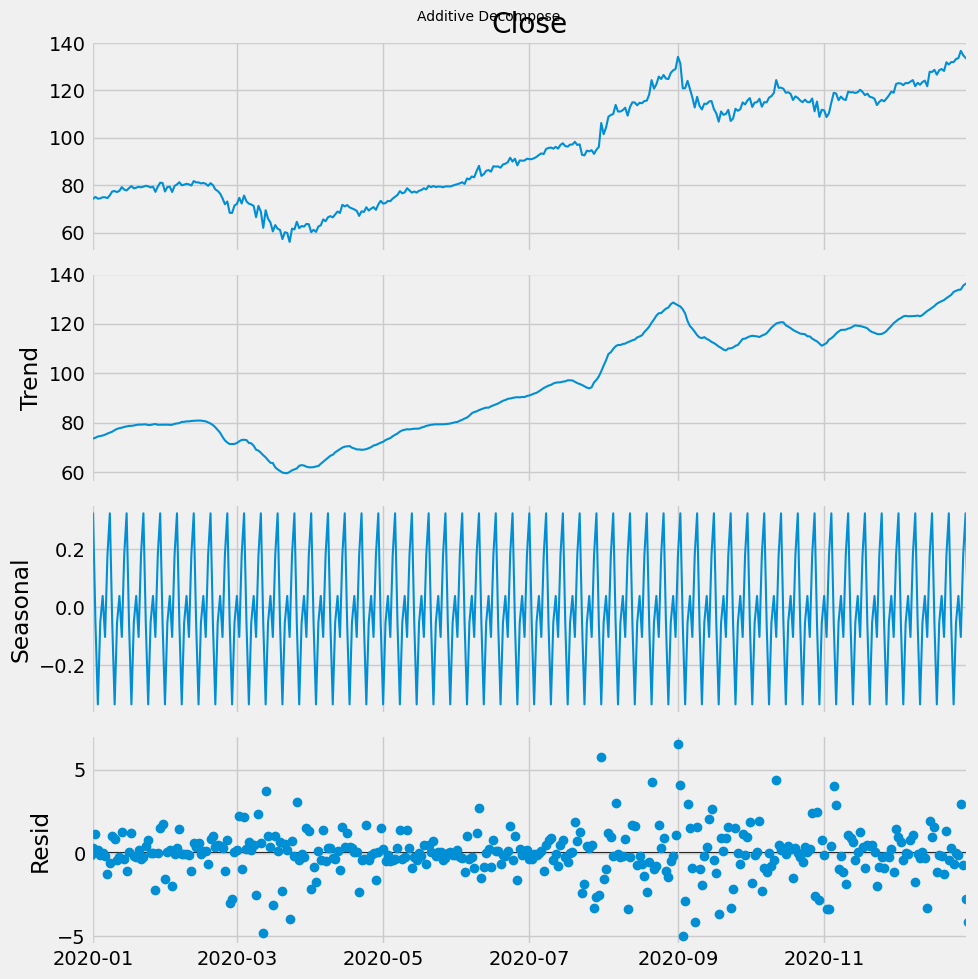

In [62]:
# Multiplicative Decomposition 
result_mul_AAPL = seasonal_decompose(AAPL_all_dates_KNN_df['Close'], model='multiplicative', extrapolate_trend='freq')

# Additive Decomposition
result_add_AAPL = seasonal_decompose(AAPL_all_dates_KNN_df['Close'], model='additive', extrapolate_trend='freq')

# Plot
plt.rcParams.update({'figure.figsize': (10,10)})
result_mul_AAPL.plot().suptitle('Multiplicative Decompose', fontsize=10)
result_add_AAPL.plot().suptitle('Additive Decompose', fontsize=10)
plt.show()

In [63]:
# Extract the Components ----
# Actual Values = Product of (Seasonal * Trend * Resid), Multiplicative is random, therefore using it 
AAPL_df_reconstructed = pd.concat([result_add_AAPL.seasonal, result_add_AAPL.trend, result_add_AAPL.resid, result_add_AAPL.observed], axis=1)
AAPL_df_reconstructed.columns = ['seas', 'trend', 'resid', 'actual_values']
AAPL_df_reconstructed.head()

,seas,trend,resid,actual_values
2019-12-31,0.180231,73.340656,-0.108386,73.412500
2020-01-01,0.323907,73.676284,0.285643,74.285833
2020-01-02,-0.055325,74.011912,1.130914,75.087500
2020-01-03,-0.334118,74.504619,0.186999,74.357500
2020-01-04,-0.052126,74.673905,-0.140779,74.481000


<Axes: xlabel='Lag', ylabel='Autocorrelation'>

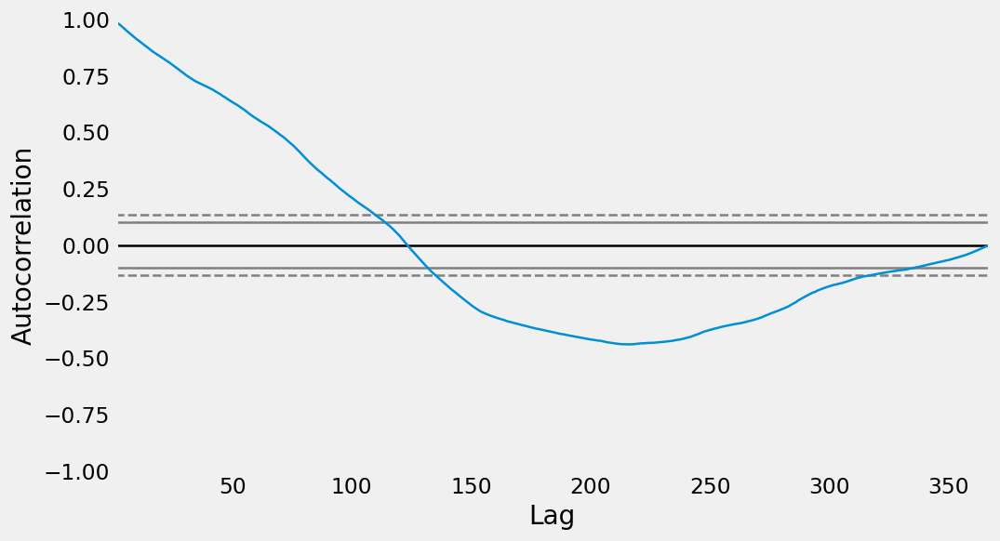

In [64]:
# Draw Plot - shows seasonality
plt.rcParams.update({'figure.figsize':(9,5), 'figure.dpi':120})
autocorrelation_plot(AAPL_all_dates_KNN_df['Close'].tolist())

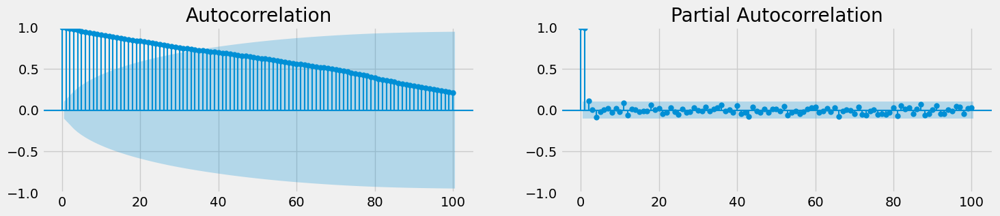

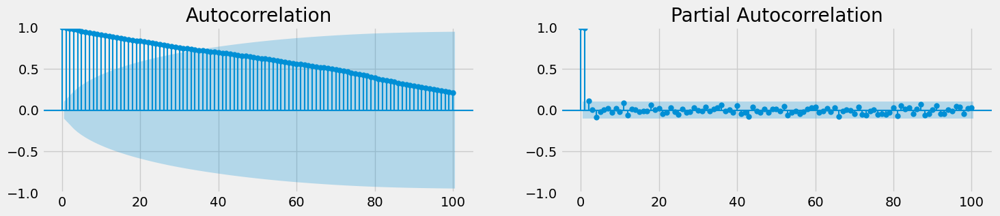

In [65]:
# Calculate ACF and PACF upto 50 lags
acf_50 = acf(AAPL_all_dates_KNN_df['Close'], nlags=100)
pacf_50 = pacf(AAPL_all_dates_KNN_df['Close'], nlags=100)

# Draw Plot
fig, axes = plt.subplots(1,2,figsize=(16,3), dpi= 100)
plot_acf(AAPL_all_dates_KNN_df['Close'].tolist(), lags=100, ax=axes[0])
plot_pacf(AAPL_all_dates_KNN_df['Close'].tolist(), lags=100, ax=axes[1])

Text(0.5, 1.15, '')

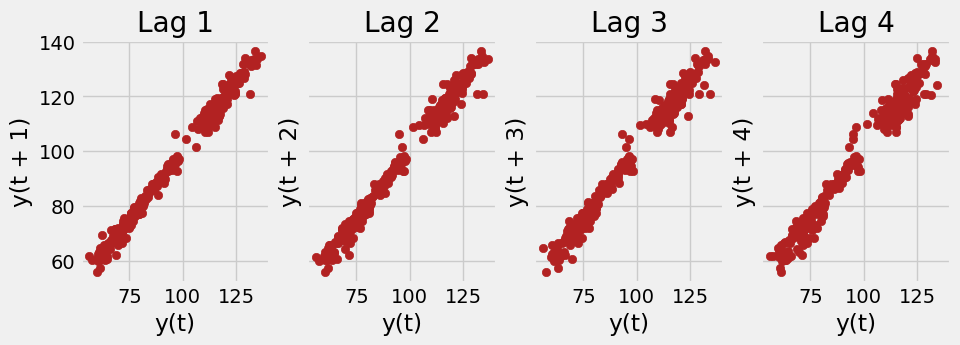

In [66]:
# Plot
fig, axes = plt.subplots(1, 4, figsize=(10,3), sharex=True, sharey=True, dpi=100)
for i, ax in enumerate(axes.flatten()[:4]):
    lag_plot(AAPL_all_dates_KNN_df['Close'], lag=i+1, ax=ax, c='firebrick')
    ax.set_title('Lag ' + str(i+1))

fig.suptitle('', y=1.15)    

In [67]:
# ADF Test - Stationary, p < 0.05 
result = adfuller(AAPL_all_dates_KNN_df['Close'].values, autolag='AIC')
print(f'ADF Statistic: {result[0]}')
print(f'p-value: {result[1]}')
for key, value in result[4].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

# KPSS Test - Stationary, p > 0.05
result = kpss(AAPL_all_dates_KNN_df['Close'].values, regression='c')
print('\nKPSS Statistic: %f' % result[0])
print('p-value: %f' % result[1])
for key, value in result[3].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

ADF Statistic: -0.15906226760835468
p-value: 0.9432286052425939
Critial Values:
   1%, -3.448544133483233
Critial Values:
   5%, -2.8695574079525565
Critial Values:
   10%, -2.5710411593052713

KPSS Statistic: 2.800987
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


Non-stationary, take the first difference to make it stationary

In [69]:
AAPL_all_dates_KNN_stationary_df = AAPL_all_dates_KNN_df.diff().dropna()
# Integration to go back to original 
# AAPL_all_dates_KNN_df = AAPL_all_dates_KNN_df.iloc[0] + AAPL_all_dates_KNN_stationary_df.cumsum()

start = AAPL_all_dates_KNN_stationary_df.index.min()
end= AAPL_all_dates_KNN_stationary_df.index.max()

# Create a complete date range
index = pd.date_range(start=start, end=end, freq='D')
AAPL_all_dates_KNN_stationary_df.index =index

# ADF Test - Stationary, p < 0.05 
result = adfuller(AAPL_all_dates_KNN_stationary_df['Close'].values, autolag='AIC')
print(f'ADF Statistic: {result[0]}')
print(f'p-value: {result[1]}')
for key, value in result[4].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

# KPSS Test - Stationary, p > 0.05
result = kpss(AAPL_all_dates_KNN_stationary_df['Close'].values, regression='c')
print('\nKPSS Statistic: %f' % result[0])
print('p-value: %f' % result[1])
for key, value in result[3].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

ADF Statistic: -8.674812000123982
p-value: 4.4457115621370705e-14
Critial Values:
   1%, -3.448544133483233
Critial Values:
   5%, -2.8695574079525565
Critial Values:
   10%, -2.5710411593052713

KPSS Statistic: 0.129902
p-value: 0.100000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


Stationary, test1 p < 0.05, test2 p > 0.05

In [71]:
print(ApEn(AAPL_all_dates_KNN_df['Close'], m=2, r=0.2*np.std(AAPL_all_dates_KNN_df['Close'])))    
print(SampEn(AAPL_all_dates_KNN_df['Close'], m=2, r=0.2*np.std(AAPL_all_dates_KNN_df['Close'])))     

0.2219371062063611
0.16811571041996978


Both small, can be predicted using past results (time-wsie)

In [73]:
columns = [AAPL_all_dates_KNN_df.columns]
results_list = []

for col in AAPL_all_dates_KNN_df.columns:
    if col != 'Close':  # Ensure we don't test 'Close' against itself
        test_result = grangercausalitytests(AAPL_all_dates_KNN_df[['Close', col]], maxlag=10, verbose=False)
        
        for lag, result in test_result.items():
            f_statistic = result[0]['ssr_ftest'][0]  # Extract F-statistic
            p_value = result[0]['ssr_ftest'][1]      # Extract p-value
            
            # Append the results to the list
            results_list.append({
                'Variable': col,
                'Lag': lag,
                'F-Statistic': f_statistic,
                'P-Value': p_value
            })

# Convert the list of results to a DataFrame
results_df = pd.DataFrame(results_list)

In [74]:
results_df = pd.DataFrame(results_list)
results_df

,Variable,Lag,F-Statistic,P-Value
0,compound_score,1,1.258065,0.262759
1,compound_score,2,1.377732,0.253476
2,compound_score,3,1.071745,0.361040
3,compound_score,4,1.232969,0.296485
4,compound_score,5,2.145752,0.059616
5,compound_score,6,2.071341,0.055983
6,compound_score,7,2.094483,0.043551
7,compound_score,8,1.853245,0.066532
8,compound_score,9,1.728293,0.081402
9,compound_score,10,1.581144,0.110619


Text(0.5, 1.0, 'Detrended Plot')

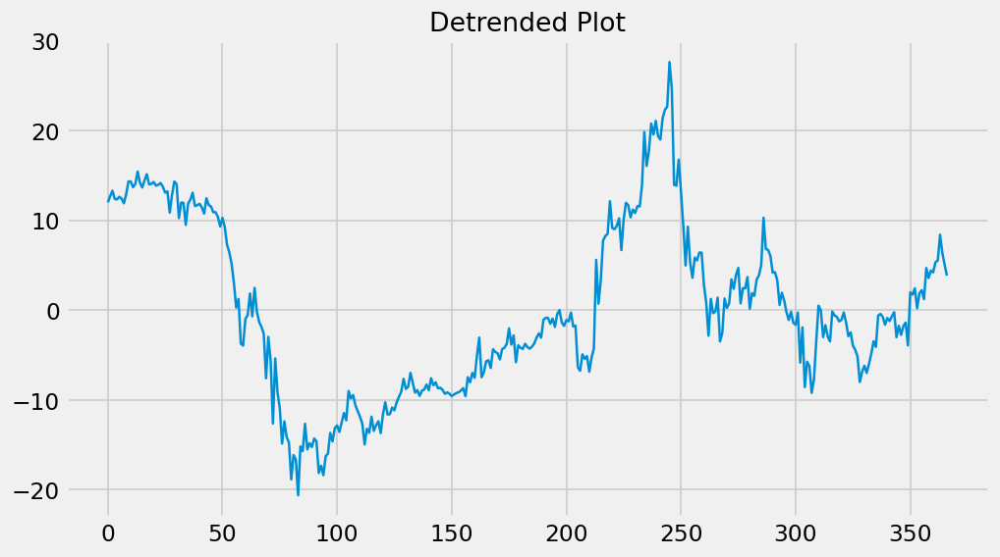

In [75]:
detrended_AAPL = signal.detrend(AAPL_all_dates_KNN_df['Close'])
plt.plot(detrended_AAPL)
plt.title('Detrended Plot', fontsize=16)

In [76]:
detrended_AAPL_list = []

for col in AAPL_all_dates_KNN_stationary_df.columns:
    detrended = signal.detrend(AAPL_all_dates_KNN_stationary_df[col])
    
    detrended_AAPL_list.append(detrended)

AAPL_detrended_stationary = pd.DataFrame(detrended_AAPL_list).T  # Transpose to keep the structure

AAPL_detrended_stationary.index = AAPL_all_dates_KNN_stationary_df.index

AAPL_detrended_stationary.columns = AAPL_all_dates_KNN_stationary_df.columns
start = AAPL_detrended_stationary.index.min()
end= AAPL_detrended_stationary.index.max()

# Create a complete date range
index = pd.date_range(start=start, end=end, freq='D')
AAPL_detrended_stationary.index =index

## 2. AMZN

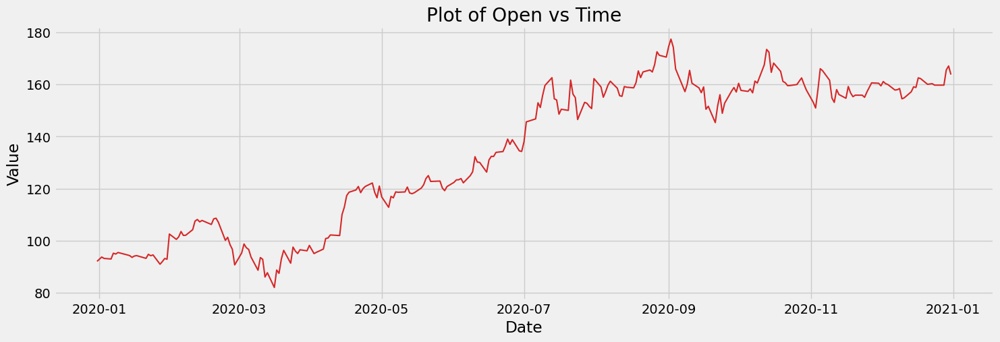

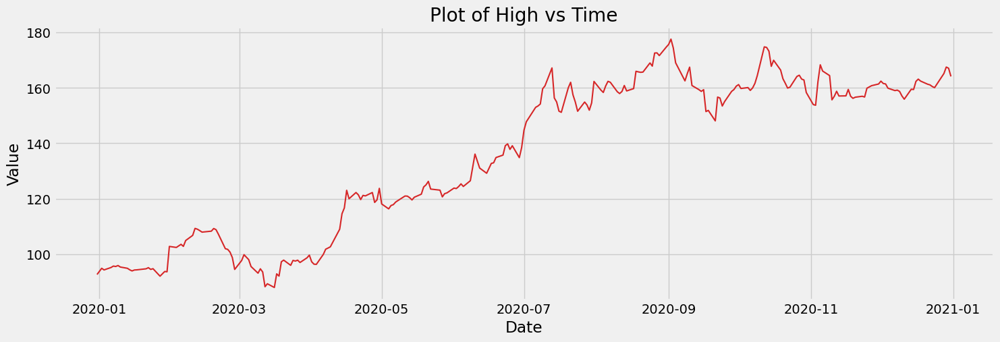

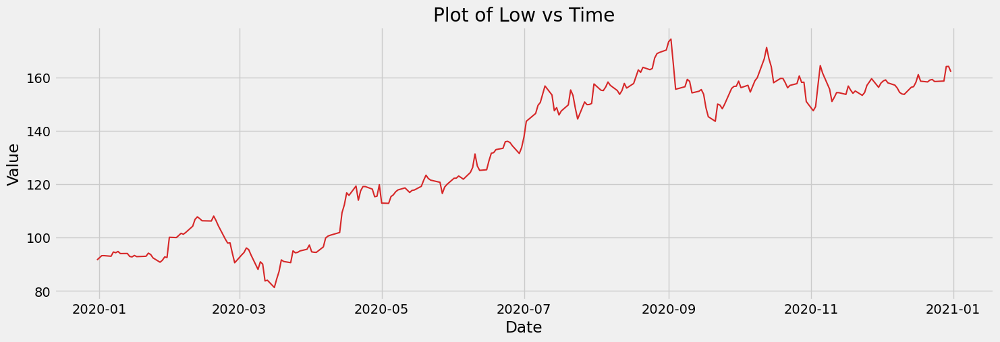

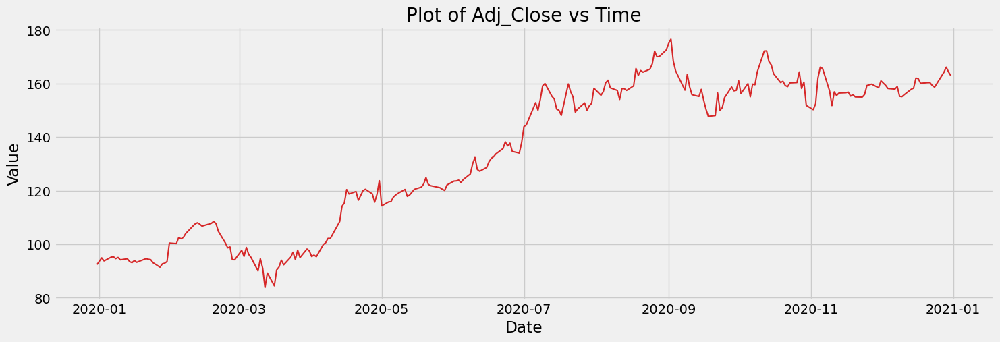

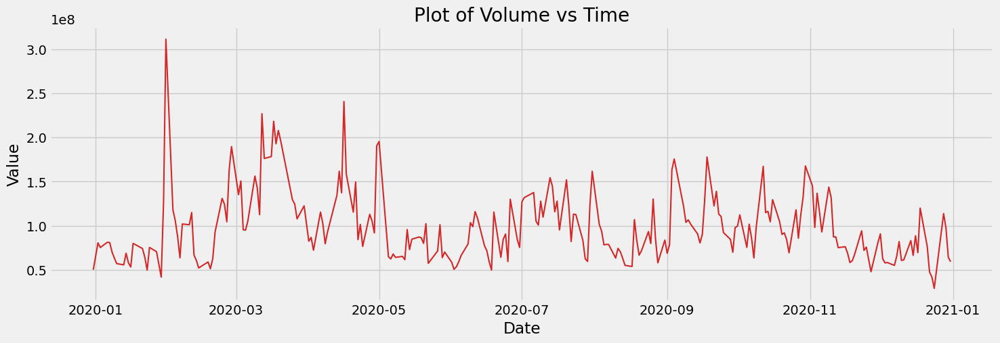

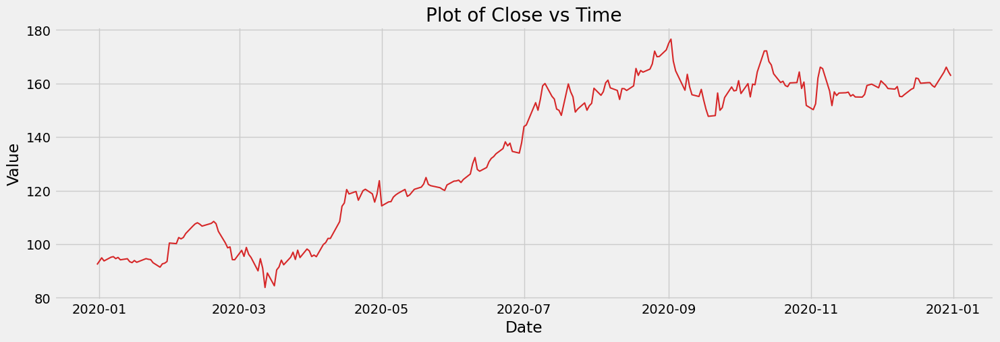

In [78]:
for column in AMZN_df.columns:
    plot_df_trendlines(AMZN_df, x=AMZN_df.index, y=AMZN_df[column], title=f'Plot of {column} vs Time')

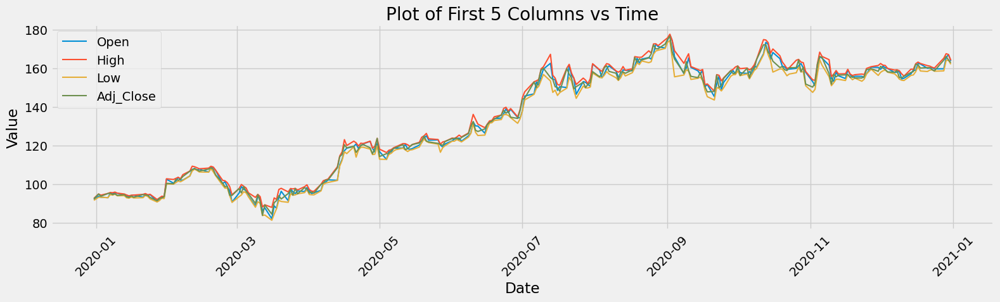

In [79]:
plot_df_one_graph(AMZN_df, title='Plot of First 5 Columns vs Time')

matplotlib.category INFO  Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
matplotlib.category INFO  Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


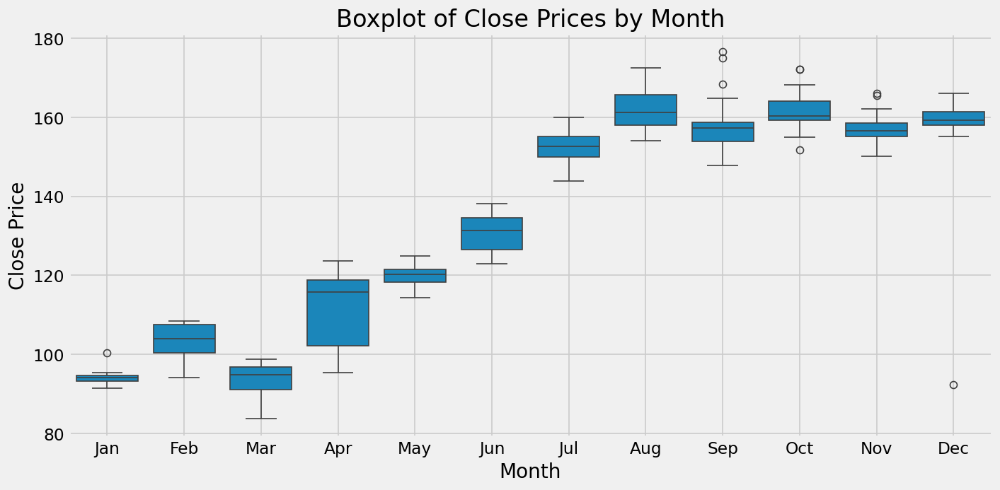

In [80]:
AMZN_df['month'] = AMZN_df.index.month

# Create boxplot
plt.figure(figsize=(12, 6))
sns.boxplot(x='month', y='Close', data=AMZN_df)
plt.title('Boxplot of Close Prices by Month')
plt.xlabel('Month')
plt.ylabel('Close Price')
plt.xticks(ticks=range(12), labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 
                                      'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
plt.tight_layout()
plt.show()
AMZN_df = AMZN_df.drop('month', axis=1)

<Axes: title={'center': 'Seasonal Mean'}>

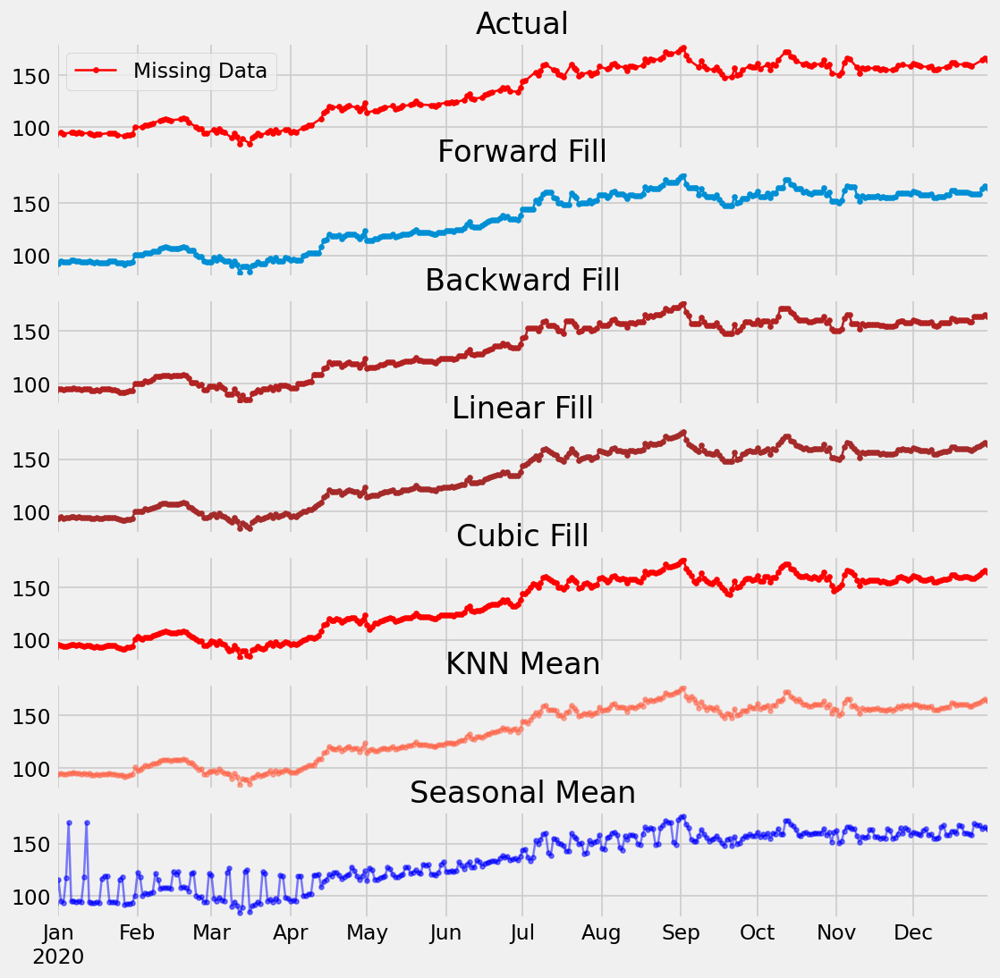

In [81]:
fig, axes = plt.subplots(7, 1, sharex=True, figsize=(10, 12))
plt.rcParams.update({'xtick.bottom' : False})


## 1. Actual -------------------------------
AMZN_Close_df = pd.DataFrame(AMZN_df['Close'])
AMZN_Close_df.plot(title='Actual', ax=axes[0], label='Actual', color='red', style=".-")
axes[0].legend(["Missing Data", "Available Data"])

## 2. Forward Fill --------------------------
df_ffill = result_AMZN.ffill()
df_ffill['Close'].plot(title='Forward Fill', ax=axes[1], label='Forward Fill', style=".-")


# 3. Backward Fill -------------------------
df_bfill = result_AMZN.bfill()
df_bfill['Close'].plot(title="Backward Fill", ax=axes[2], label='Back Fill', color='firebrick', style=".-")

## 4. Linear Interpolation ------------------
result_AAPL['rownum'] = range(1, len(result_AAPL) + 1)

result_AMZN['rownum'] = np.arange(result_AMZN.shape[0])
df_nona = result_AMZN.dropna(subset = ['Close'])
f = interp1d(df_nona['rownum'], df_nona['Close'])
result_AMZN['linear_fill'] = f(result_AMZN['rownum'])
result_AMZN['linear_fill'].plot(title="Linear Fill", ax=axes[3], label='Cubic Fill', color='brown', style=".-")

## 5. Cubic Interpolation --------------------
f2 = interp1d(df_nona['rownum'], df_nona['Close'], kind='cubic')
result_AMZN['cubic_fill'] = f2(result_AMZN['rownum'])
result_AMZN['cubic_fill'].plot(title="Cubic Fill", ax=axes[4], label='Cubic Fill', color='red', style=".-")

# Interpolation References:
# https://docs.scipy.org/doc/scipy/reference/tutorial/interpolate.html
# https://docs.scipy.org/doc/scipy/reference/interpolate.html

## 6. Mean of 'n' Nearest Past Neighbors ------
def knn_mean(ts, n):
    out = np.copy(ts)
    for i, val in enumerate(ts):
        if np.isnan(val):
            n_by_2 = np.ceil(n/2)
            lower = np.max([0, int(i-n_by_2)])
            upper = np.min([len(ts)+1, int(i+n_by_2)])
            ts_near = np.concatenate([ts[lower:i], ts[i:upper]])
            out[i] = np.nanmean(ts_near)
    return out

result_AMZN['knn_mean'] = knn_mean(result_AMZN['Close'].values, 8)
# error = np.round(mean_squared_error(df_orig['value'], df['knn_mean']), 2)
result_AMZN['knn_mean'].plot(title="KNN Mean", ax=axes[5], label='KNN Mean', color='tomato', alpha=0.5, style=".-")

## 7. Seasonal Mean ----------------------------
def seasonal_mean(ts, n, lr=0.7):
    """
    Compute the mean of corresponding seasonal periods
    ts: 1D array-like of the time series
    n: Seasonal window length of the time series
    """
    out = np.copy(ts)
    for i, val in enumerate(ts):
        if np.isnan(val):
            ts_seas = ts[i-1::-n]  # previous seasons only
            if np.isnan(np.nanmean(ts_seas)):
                ts_seas = np.concatenate([ts[i-1::-n], ts[i::n]])  # previous and forward
            out[i] = np.nanmean(ts_seas) * lr
    return out

result_AMZN['seasonal_mean'] = seasonal_mean(result_AMZN['Close'], n=12, lr=1.25)
result_AMZN['seasonal_mean'].plot(title="Seasonal Mean", ax=axes[6], label='Seasonal Mean', color='blue', alpha=0.5, style=".-")

In [82]:
AMZN_all_dates_KNN_df = result_AMZN.apply(lambda col: knn_mean(col.values, 8), axis=0)
AMZN_all_dates_KNN_df = AMZN_all_dates_KNN_df.drop(['rownum', 'linear_fill',	'cubic_fill', 'knn_mean', 'seasonal_mean'], axis=1)

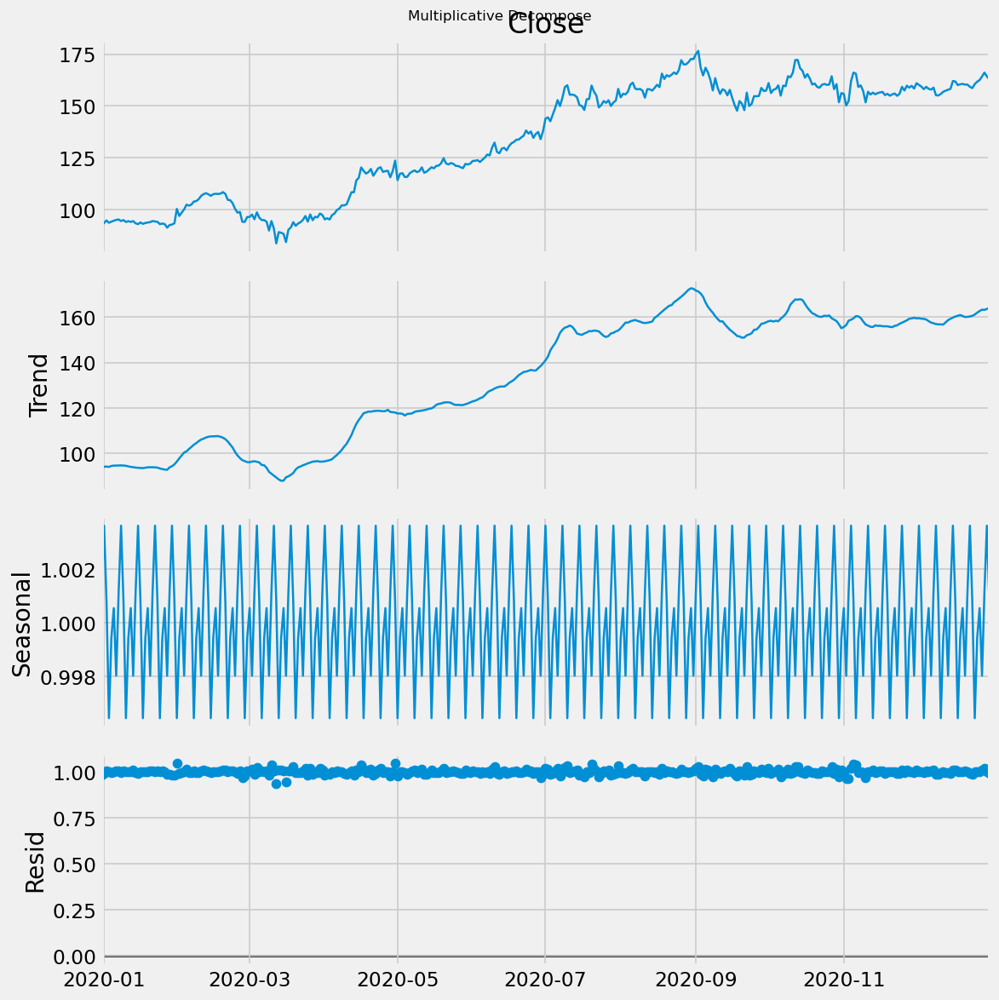

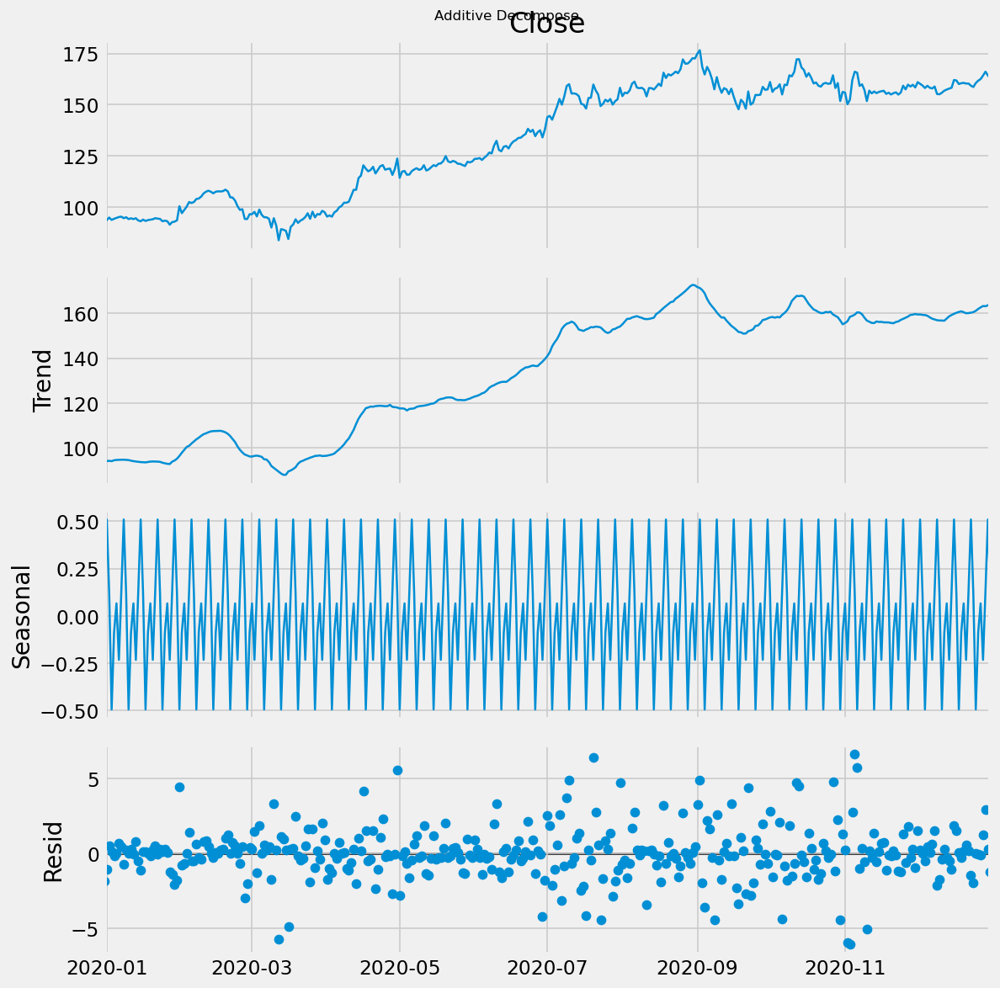

In [83]:
# Multiplicative Decomposition 
result_mul_AMZN = seasonal_decompose(AMZN_all_dates_KNN_df['Close'], model='multiplicative', extrapolate_trend='freq')

# Additive Decomposition
result_add_AMZN = seasonal_decompose(AMZN_all_dates_KNN_df['Close'], model='additive', extrapolate_trend='freq')

# Plot
plt.rcParams.update({'figure.figsize': (10,10)})
result_mul_AMZN.plot().suptitle('Multiplicative Decompose', fontsize=10)
result_add_AMZN.plot().suptitle('Additive Decompose', fontsize=10)
plt.show()

In [84]:
# Extract the Components ----
# Actual Values = Product of (Seasonal * Trend * Resid), Multiplicative is random, therefore using it 
AMZN_df_reconstructed = pd.concat([result_add_AMZN.seasonal, result_add_AMZN.trend, result_add_AMZN.resid, result_add_AMZN.observed], axis=1)
AMZN_df_reconstructed.columns = ['seas', 'trend', 'resid', 'actual_values']
AMZN_df_reconstructed.head()

,seas,trend,resid,actual_values
2019-12-31,0.128737,94.125678,-1.862415,92.392000
2020-01-01,0.509060,94.208204,-1.036930,93.680333
2020-01-02,0.113837,94.290730,0.495933,94.900500
2020-01-03,-0.495471,94.131119,0.112852,93.748500
2020-01-04,-0.088840,94.552690,-0.158250,94.305600


<Axes: xlabel='Lag', ylabel='Autocorrelation'>

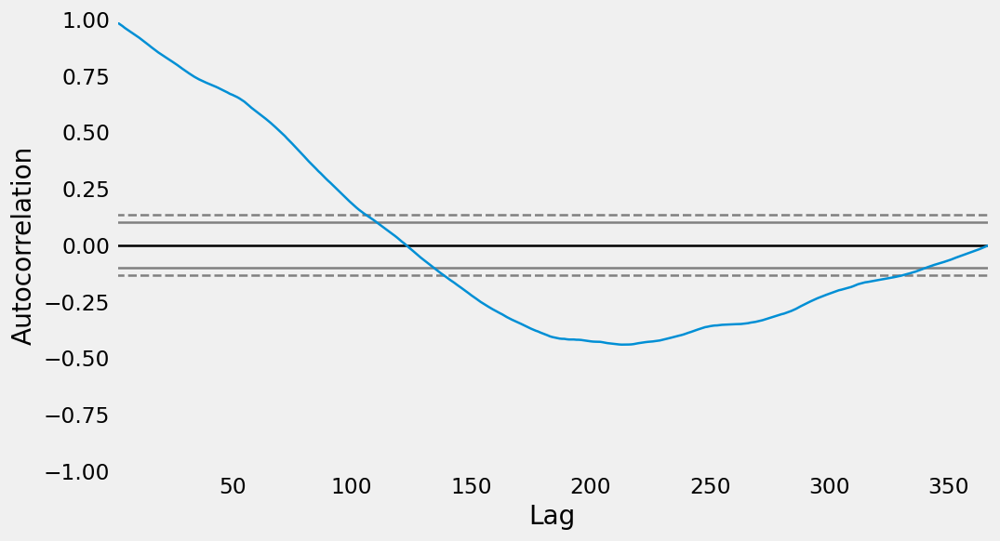

In [85]:
# Draw Plot - shows seasonality
plt.rcParams.update({'figure.figsize':(9,5), 'figure.dpi':120})
autocorrelation_plot(AMZN_all_dates_KNN_df['Close'].tolist())

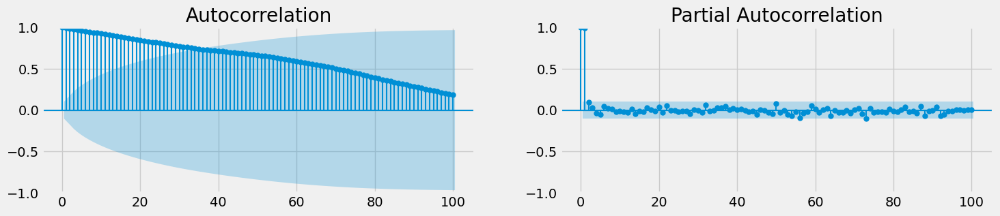

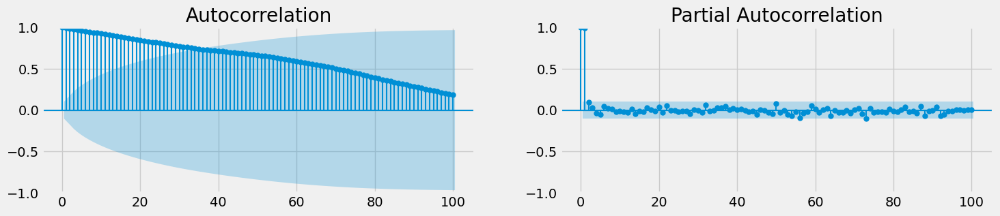

In [86]:
# Calculate ACF and PACF upto 50 lags
acf_50 = acf(AMZN_all_dates_KNN_df['Close'], nlags=100)
pacf_50 = pacf(AMZN_all_dates_KNN_df['Close'], nlags=100)

# Draw Plot
fig, axes = plt.subplots(1,2,figsize=(16,3), dpi= 100)
plot_acf(AMZN_all_dates_KNN_df['Close'].tolist(), lags=100, ax=axes[0])
plot_pacf(AMZN_all_dates_KNN_df['Close'].tolist(), lags=100, ax=axes[1])

Text(0.5, 1.15, '')

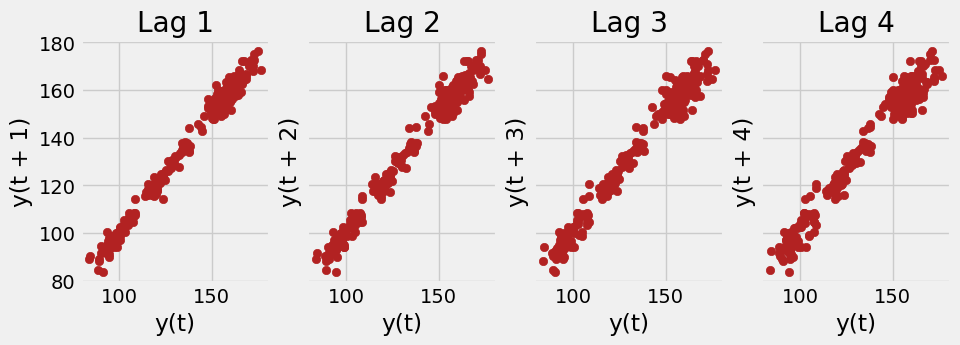

In [87]:
# Plot
fig, axes = plt.subplots(1, 4, figsize=(10,3), sharex=True, sharey=True, dpi=100)
for i, ax in enumerate(axes.flatten()[:4]):
    lag_plot(AMZN_all_dates_KNN_df['Close'], lag=i+1, ax=ax, c='firebrick')
    ax.set_title('Lag ' + str(i+1))

fig.suptitle('', y=1.15) 

In [88]:
# ADF Test - Stationary, p < 0.05 
result = adfuller(AMZN_all_dates_KNN_df['Close'].values, autolag='AIC')
print(f'ADF Statistic: {result[0]}')
print(f'p-value: {result[1]}')
for key, value in result[4].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

# KPSS Test - Stationary, p > 0.05
result = kpss(AMZN_all_dates_KNN_df['Close'].values, regression='c')
print('\nKPSS Statistic: %f' % result[0])
print('p-value: %f' % result[1])
for key, value in result[3].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

ADF Statistic: -1.1085542832057946
p-value: 0.7116485274302308
Critial Values:
   1%, -3.448544133483233
Critial Values:
   5%, -2.8695574079525565
Critial Values:
   10%, -2.5710411593052713

KPSS Statistic: 2.877745
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


In [89]:
AMZN_all_dates_KNN_stationary_df = AMZN_all_dates_KNN_df.diff().dropna()
# Integration to go back to original 
# AAPL_all_dates_KNN_df = AAPL_all_dates_KNN_df.iloc[0] + AAPL_all_dates_KNN_stationary_df.cumsum()

start = AAPL_all_dates_KNN_stationary_df.index.min()
end= AAPL_all_dates_KNN_stationary_df.index.max()

# Create a complete date range
index = pd.date_range(start=start, end=end, freq='D')
AMZN_all_dates_KNN_stationary_df.index =index

# ADF Test - Stationary, p < 0.05 
result = adfuller(AMZN_all_dates_KNN_stationary_df['Close'].values, autolag='AIC')
print(f'ADF Statistic: {result[0]}')
print(f'p-value: {result[1]}')
for key, value in result[4].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

# KPSS Test - Stationary, p > 0.05
result = kpss(AMZN_all_dates_KNN_stationary_df['Close'].values, regression='c')
print('\nKPSS Statistic: %f' % result[0])
print('p-value: %f' % result[1])
for key, value in result[3].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

ADF Statistic: -8.60403514526753
p-value: 6.747783965513725e-14
Critial Values:
   1%, -3.448544133483233
Critial Values:
   5%, -2.8695574079525565
Critial Values:
   10%, -2.5710411593052713

KPSS Statistic: 0.105442
p-value: 0.100000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


In [90]:
print(ApEn(AMZN_all_dates_KNN_df['Close'], m=2, r=0.2*np.std(AMZN_all_dates_KNN_df['Close'])))    
print(SampEn(AMZN_all_dates_KNN_df['Close'], m=2, r=0.2*np.std(AMZN_all_dates_KNN_df['Close'])))  

0.24123997400656227
0.19445889872770888


In [91]:
columns = [AMZN_all_dates_KNN_df.columns]
results_list_AMZN = []

for col in AMZN_all_dates_KNN_df.columns:
    if col != 'Close':  # Ensure we don't test 'Close' against itself
        test_result = grangercausalitytests(AMZN_all_dates_KNN_df[['Close', col]], maxlag=10, verbose=False)
        
        for lag, result in test_result.items():
            f_statistic = result[0]['ssr_ftest'][0]  # Extract F-statistic
            p_value = result[0]['ssr_ftest'][1]      # Extract p-value
            
            # Append the results to the list
            results_list_AMZN.append({
                'Variable': col,
                'Lag': lag,
                'F-Statistic': f_statistic,
                'P-Value': p_value
            })

# Convert the list of results to a DataFrame
results_df_AMZN = pd.DataFrame(results_list_AMZN)
results_df_AMZN

,Variable,Lag,F-Statistic,P-Value
0,compound_score,1,1.666602e-02,0.897352
1,compound_score,2,3.997860e-01,0.670761
2,compound_score,3,5.729041e-01,0.633164
3,compound_score,4,5.681599e-01,0.685915
4,compound_score,5,1.307901e+00,0.259967
5,compound_score,6,1.040569e+00,0.398624
6,compound_score,7,9.363520e-01,0.478306
7,compound_score,8,8.718489e-01,0.540420
8,compound_score,9,9.369610e-01,0.492918
9,compound_score,10,8.722863e-01,0.559487


Text(0.5, 1.0, 'Detrended Plot')

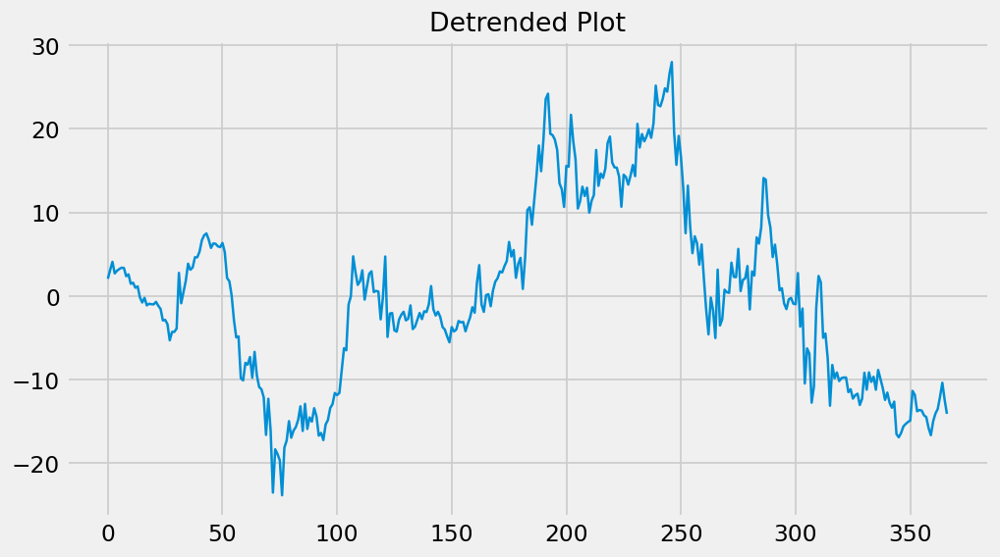

In [92]:
detrended_AMZN = signal.detrend(AMZN_all_dates_KNN_df['Close'])
plt.plot(detrended_AMZN)
plt.title('Detrended Plot', fontsize=16)

In [93]:
detrended__AMZN_list = []

for col in AMZN_all_dates_KNN_stationary_df.columns:
    detrended = signal.detrend(AMZN_all_dates_KNN_stationary_df[col])
    
    detrended__AMZN_list.append(detrended_AMZN)

AMZN_detrended_stationary = pd.DataFrame(detrended__AMZN_list).T  # Transpose to keep the structure


# Create a complete date range
index = pd.date_range(start='2019-12-31', end='2020-12-31', freq='D')
AMZN_detrended_stationary.index =index
AMZN_detrended_stationary.columns = AMZN_all_dates_KNN_stationary_df.columns

## 3. BA

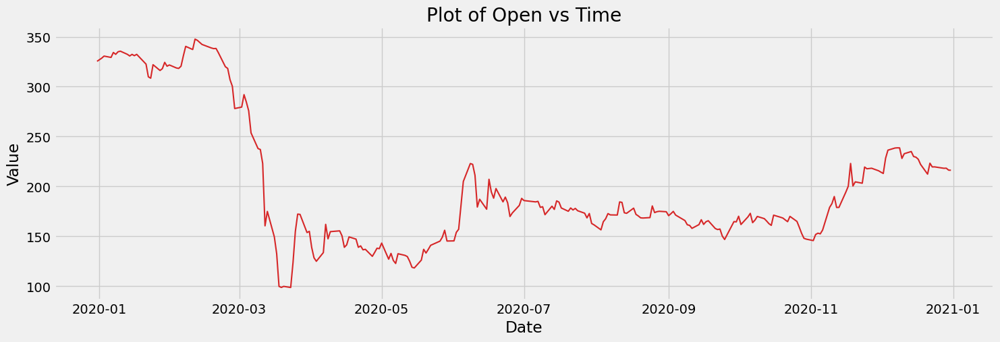

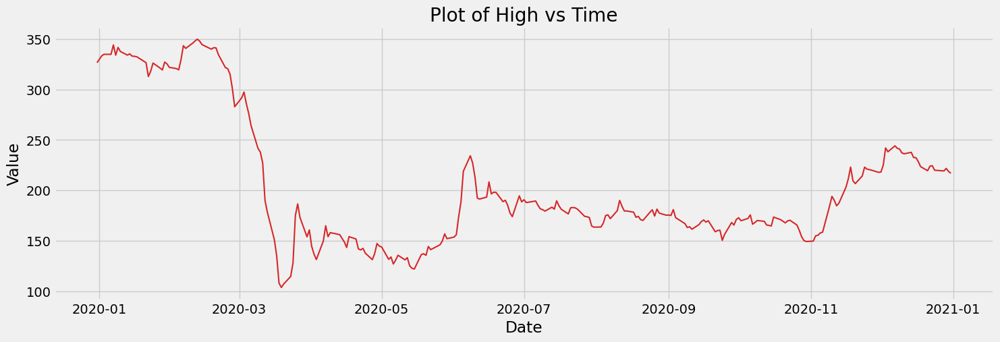

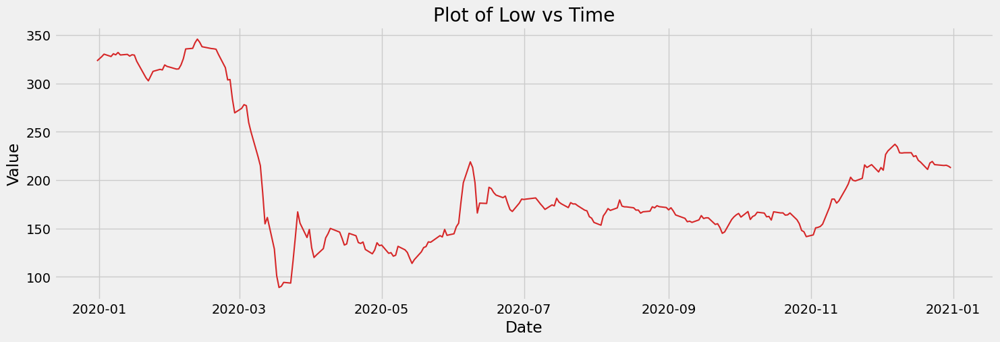

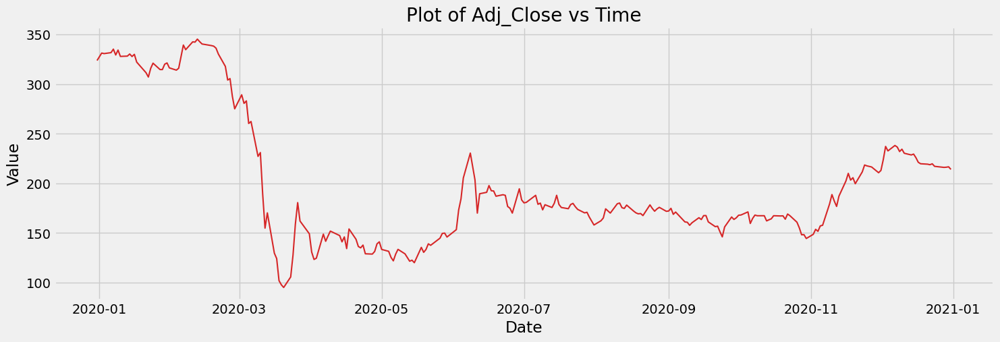

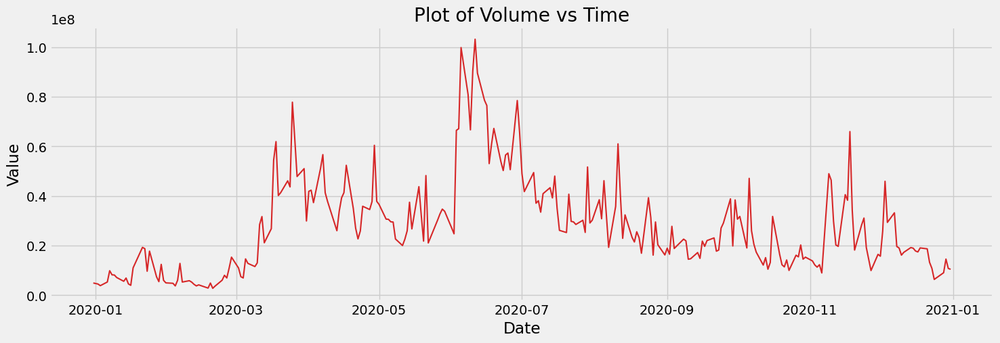

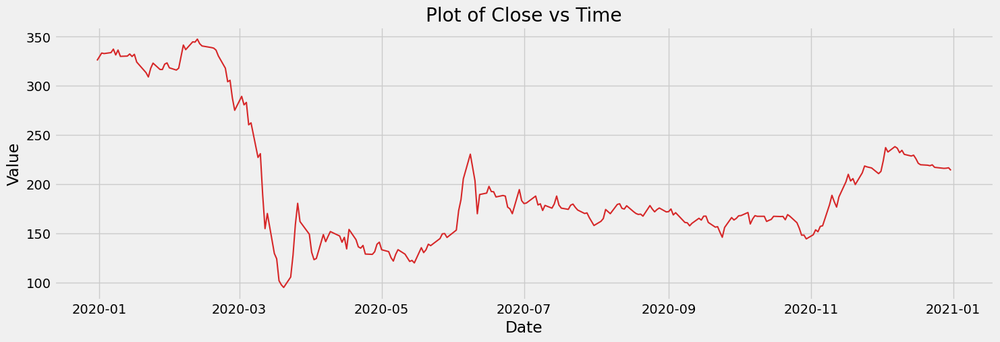

In [95]:
for column in BA_df.columns:
    plot_df_trendlines(BA_df, x=BA_df.index, y=BA_df[column], title=f'Plot of {column} vs Time')

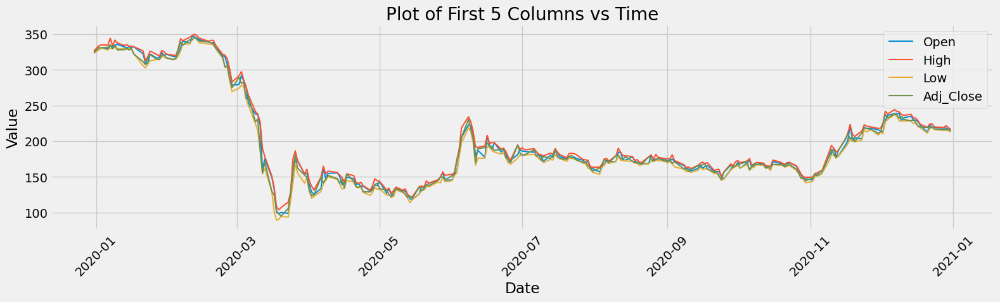

In [96]:
plot_df_one_graph(BA_df, title='Plot of First 5 Columns vs Time')

matplotlib.category INFO  Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
matplotlib.category INFO  Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


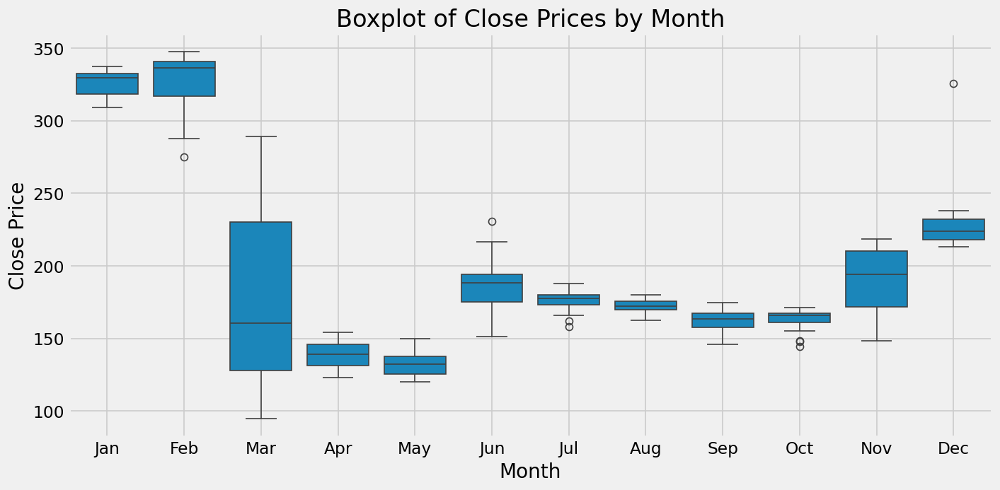

In [97]:
BA_df['month'] = BA_df.index.month

# Create boxplot
plt.figure(figsize=(12, 6))
sns.boxplot(x='month', y='Close', data=BA_df)
plt.title('Boxplot of Close Prices by Month')
plt.xlabel('Month')
plt.ylabel('Close Price')
plt.xticks(ticks=range(12), labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 
                                      'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
plt.tight_layout()
plt.show()
BA_df = BA_df.drop('month', axis=1)

<Axes: title={'center': 'Seasonal Mean'}>

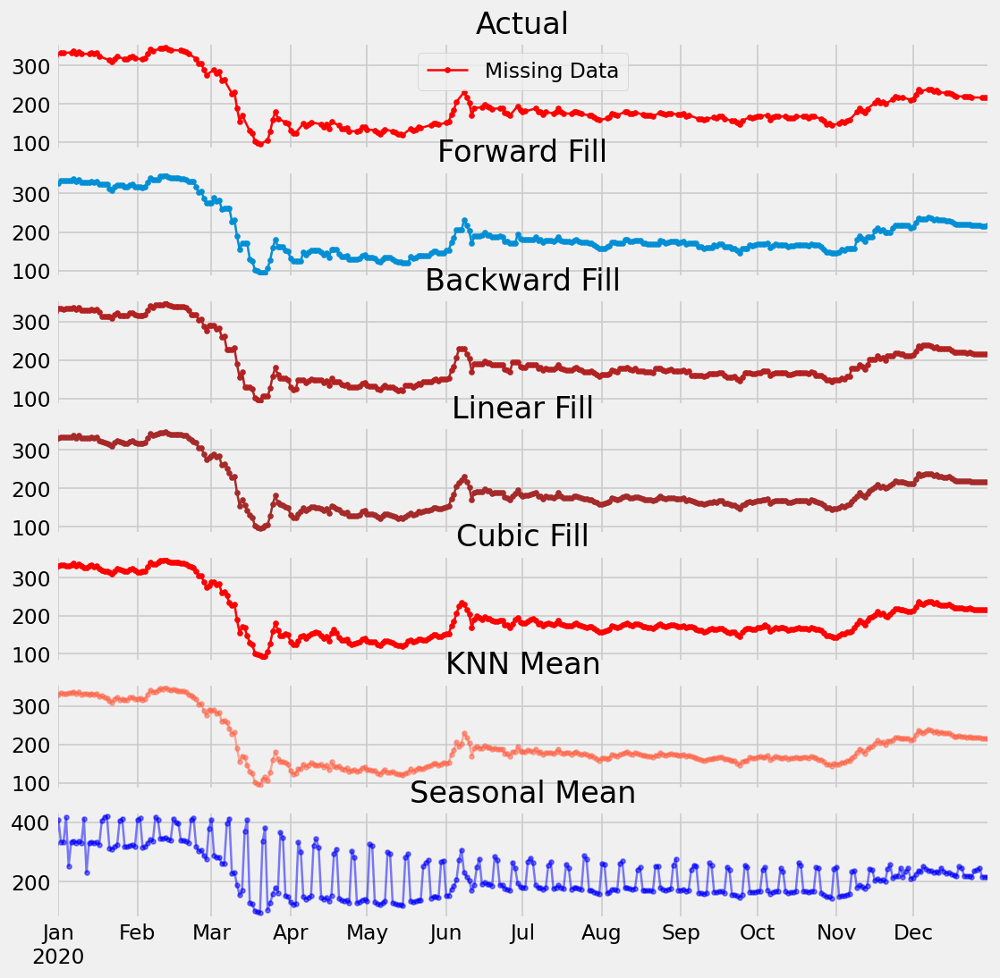

In [98]:
fig, axes = plt.subplots(7, 1, sharex=True, figsize=(10, 12))
plt.rcParams.update({'xtick.bottom' : False})


## 1. Actual -------------------------------
BA_Close_df = pd.DataFrame(BA_df['Close'])
BA_Close_df.plot(title='Actual', ax=axes[0], label='Actual', color='red', style=".-")
axes[0].legend(["Missing Data", "Available Data"])

## 2. Forward Fill --------------------------
df_ffill = result_BA.ffill()
df_ffill['Close'].plot(title='Forward Fill', ax=axes[1], label='Forward Fill', style=".-")


# 3. Backward Fill -------------------------
df_bfill = result_BA.bfill()
df_bfill['Close'].plot(title="Backward Fill", ax=axes[2], label='Back Fill', color='firebrick', style=".-")

## 4. Linear Interpolation ------------------
result_BA['rownum'] = range(1, len(result_AAPL) + 1)

result_BA['rownum'] = np.arange(result_BA.shape[0])
df_nona = result_BA.dropna(subset = ['Close'])
f = interp1d(df_nona['rownum'], df_nona['Close'])
result_BA['linear_fill'] = f(result_BA['rownum'])
result_BA['linear_fill'].plot(title="Linear Fill", ax=axes[3], label='Cubic Fill', color='brown', style=".-")

## 5. Cubic Interpolation --------------------
f2 = interp1d(df_nona['rownum'], df_nona['Close'], kind='cubic')
result_BA['cubic_fill'] = f2(result_BA['rownum'])
result_BA['cubic_fill'].plot(title="Cubic Fill", ax=axes[4], label='Cubic Fill', color='red', style=".-")

# Interpolation References:
# https://docs.scipy.org/doc/scipy/reference/tutorial/interpolate.html
# https://docs.scipy.org/doc/scipy/reference/interpolate.html

## 6. Mean of 'n' Nearest Past Neighbors ------
def knn_mean(ts, n):
    out = np.copy(ts)
    for i, val in enumerate(ts):
        if np.isnan(val):
            n_by_2 = np.ceil(n/2)
            lower = np.max([0, int(i-n_by_2)])
            upper = np.min([len(ts)+1, int(i+n_by_2)])
            ts_near = np.concatenate([ts[lower:i], ts[i:upper]])
            out[i] = np.nanmean(ts_near)
    return out

result_BA['knn_mean'] = knn_mean(result_BA['Close'].values, 8)
result_BA['knn_mean'].plot(title="KNN Mean", ax=axes[5], label='KNN Mean', color='tomato', alpha=0.5, style=".-")

## 7. Seasonal Mean ----------------------------
def seasonal_mean(ts, n, lr=0.7):
    """
    Compute the mean of corresponding seasonal periods
    ts: 1D array-like of the time series
    n: Seasonal window length of the time series
    """
    out = np.copy(ts)
    for i, val in enumerate(ts):
        if np.isnan(val):
            ts_seas = ts[i-1::-n]  # previous seasons only
            if np.isnan(np.nanmean(ts_seas)):
                ts_seas = np.concatenate([ts[i-1::-n], ts[i::n]])  # previous and forward
            out[i] = np.nanmean(ts_seas) * lr
    return out

result_BA['seasonal_mean'] = seasonal_mean(result_BA['Close'], n=12, lr=1.25)
result_BA['seasonal_mean'].plot(title="Seasonal Mean", ax=axes[6], label='Seasonal Mean', color='blue', alpha=0.5, style=".-")

In [99]:
BA_all_dates_KNN_df = result_BA.apply(lambda col: knn_mean(col.values, 8), axis=0)
BA_all_dates_KNN_df = BA_all_dates_KNN_df.drop(['rownum', 'linear_fill','cubic_fill', 'knn_mean', 'seasonal_mean'], axis=1)

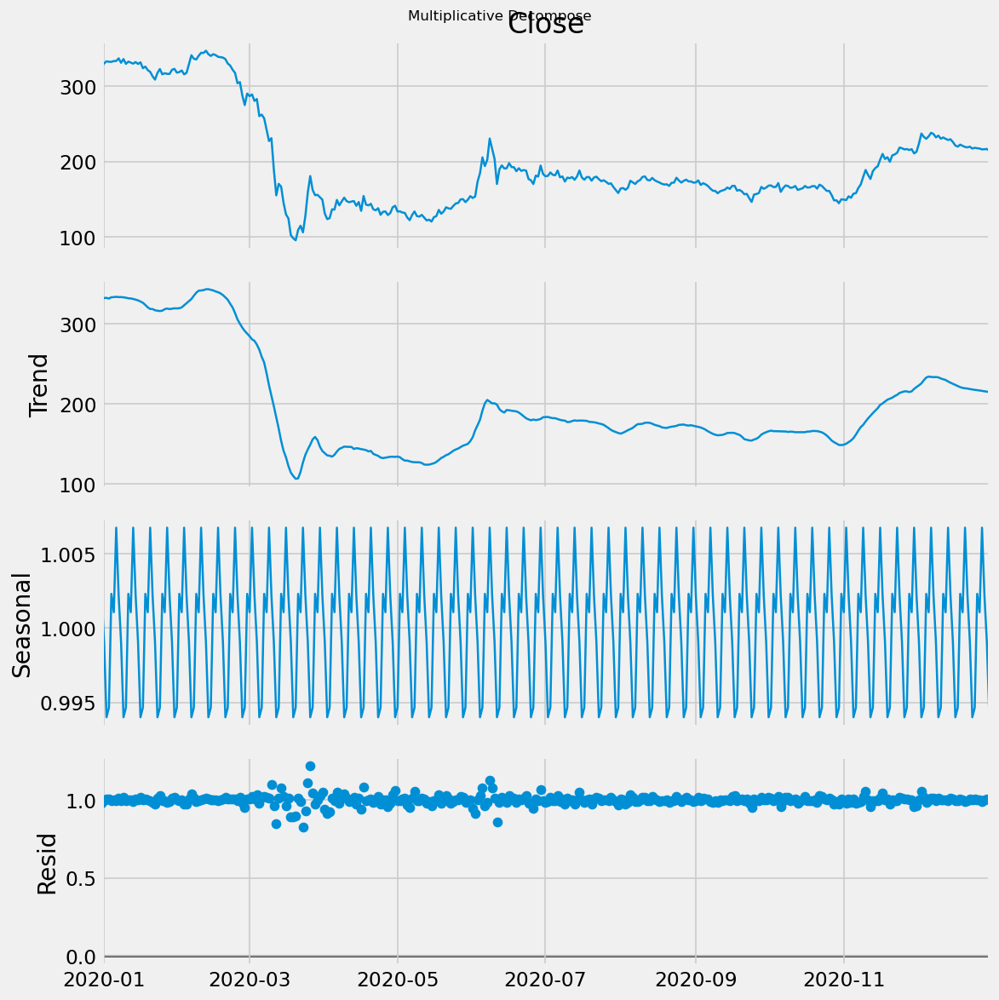

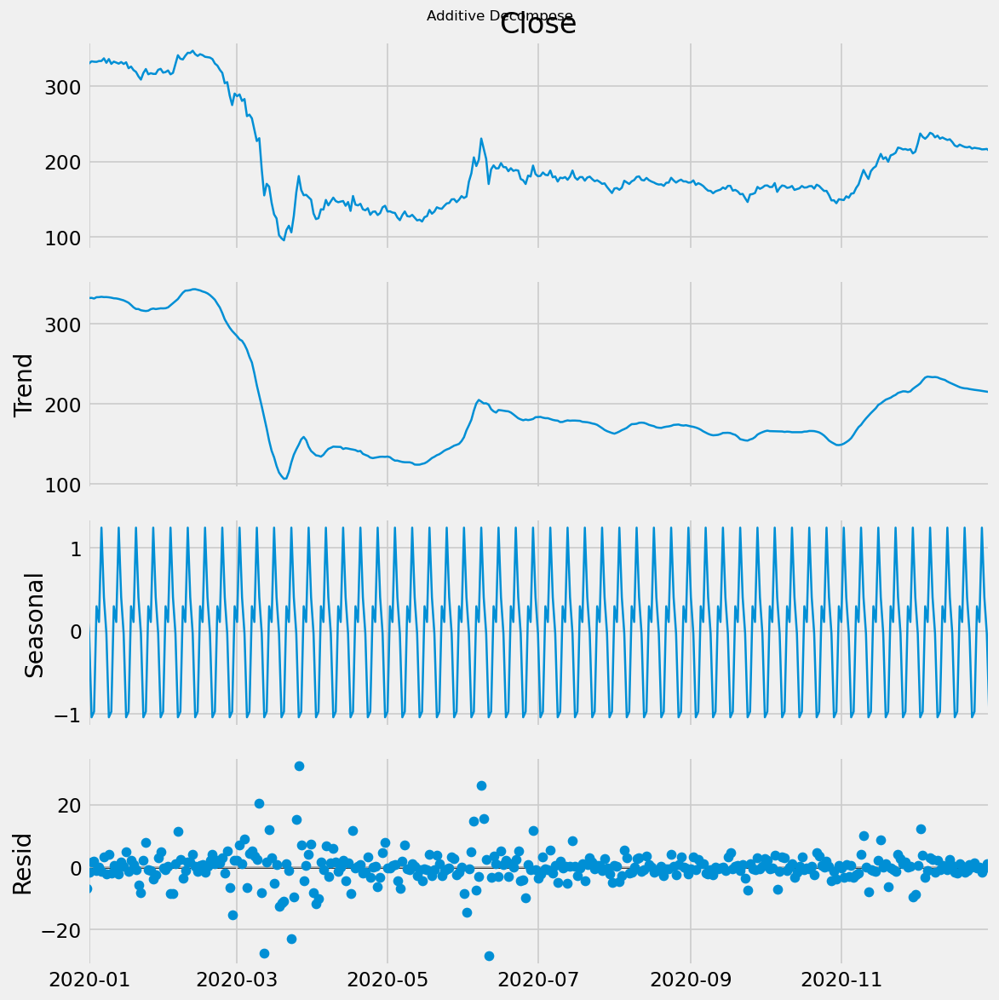

In [100]:
# Multiplicative Decomposition 
result_mul_BA = seasonal_decompose(BA_all_dates_KNN_df['Close'], model='multiplicative', extrapolate_trend='freq')

# Additive Decomposition
result_add_BA = seasonal_decompose(BA_all_dates_KNN_df['Close'], model='additive', extrapolate_trend='freq')

# Plot
plt.rcParams.update({'figure.figsize': (10,10)})
result_mul_BA.plot().suptitle('Multiplicative Decompose', fontsize=10)
result_add_BA.plot().suptitle('Additive Decompose', fontsize=10)
plt.show()

In [101]:
# Extract the Components ----
# Actual Values = Product of (Seasonal * Trend * Resid), Multiplicative is random, therefore using it 
BA_df_reconstructed = pd.concat([result_add_BA.seasonal, result_add_BA.trend, result_add_BA.resid, result_add_BA.observed], axis=1)
BA_df_reconstructed.columns = ['seas', 'trend', 'resid', 'actual_values']
BA_df_reconstructed.head()

,seas,trend,resid,actual_values
2019-12-31,0.401598,332.240041,-6.881638,325.760000
2020-01-01,-0.033565,332.418857,-1.771959,330.613333
2020-01-02,-1.037285,332.597673,1.759612,333.320000
2020-01-03,-0.969880,331.779905,1.949976,332.760000
2020-01-04,0.294798,333.425619,-1.148417,332.572000


<Axes: xlabel='Lag', ylabel='Autocorrelation'>

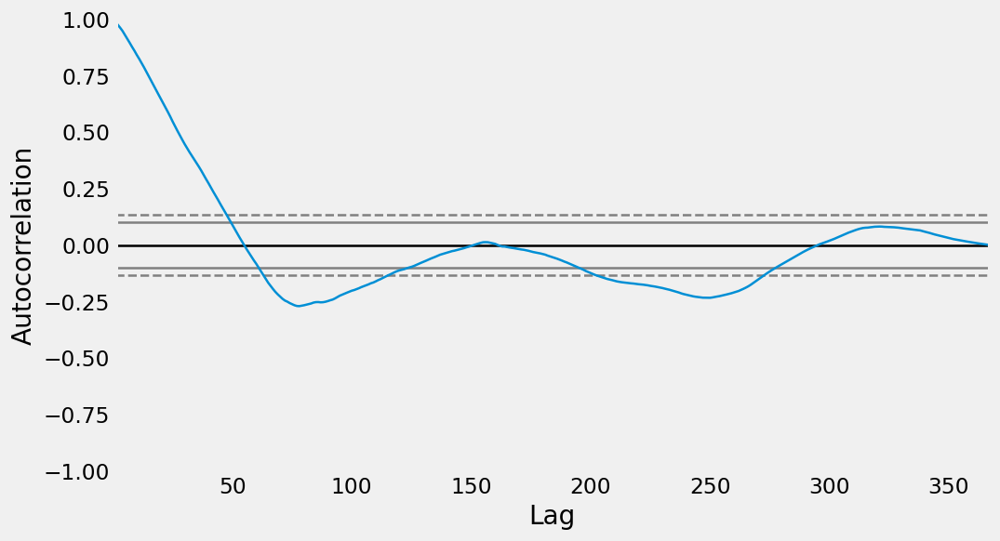

In [102]:
# Draw Plot - shows seasonality
plt.rcParams.update({'figure.figsize':(9,5), 'figure.dpi':120})
autocorrelation_plot(BA_all_dates_KNN_df['Close'].tolist())

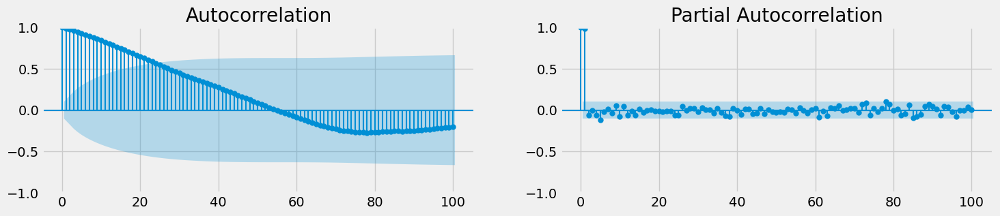

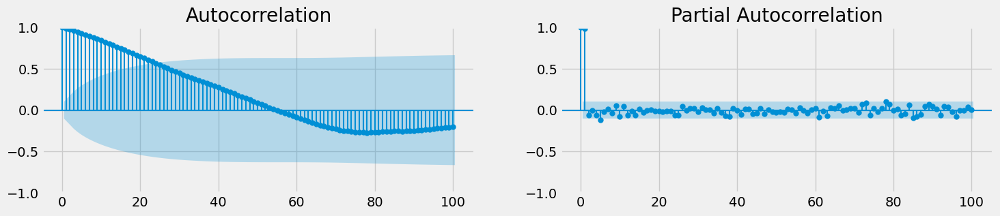

In [103]:
# Calculate ACF and PACF upto 50 lags
acf_50 = acf(BA_all_dates_KNN_df['Close'], nlags=100)
pacf_50 = pacf(BA_all_dates_KNN_df['Close'], nlags=100)

# Draw Plot
fig, axes = plt.subplots(1,2,figsize=(16,3), dpi= 100)
plot_acf(BA_all_dates_KNN_df['Close'].tolist(), lags=100, ax=axes[0])
plot_pacf(BA_all_dates_KNN_df['Close'].tolist(), lags=100, ax=axes[1])

Text(0.5, 1.15, '')

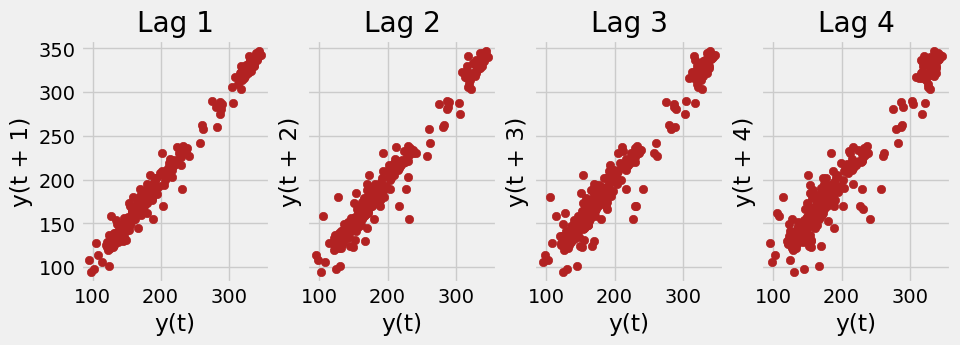

In [104]:
# Plot
fig, axes = plt.subplots(1, 4, figsize=(10,3), sharex=True, sharey=True, dpi=100)
for i, ax in enumerate(axes.flatten()[:4]):
    lag_plot(BA_all_dates_KNN_df['Close'], lag=i+1, ax=ax, c='firebrick')
    ax.set_title('Lag ' + str(i+1))

fig.suptitle('', y=1.15)   

In [105]:
# ADF Test - Stationary, p < 0.05 
result = adfuller(BA_all_dates_KNN_df['Close'].values, autolag='AIC')
print(f'ADF Statistic: {result[0]}')
print(f'p-value: {result[1]}')
for key, value in result[4].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

# KPSS Test - Stationary, p > 0.05
result = kpss(BA_all_dates_KNN_df['Close'].values, regression='c')
print('\nKPSS Statistic: %f' % result[0])
print('p-value: %f' % result[1])
for key, value in result[3].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

ADF Statistic: -2.3080760747380618
p-value: 0.16937650511715518
Critial Values:
   1%, -3.448544133483233
Critial Values:
   5%, -2.8695574079525565
Critial Values:
   10%, -2.5710411593052713

KPSS Statistic: 0.900853
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


In [106]:
BA_all_dates_KNN_stationary_df = BA_all_dates_KNN_df.diff().diff().dropna() #Differentiate 

BA_all_dates_KNN_stationary_df = np.log(BA_all_dates_KNN_stationary_df) #Find the log
BA_all_dates_KNN_stationary_df = BA_all_dates_KNN_stationary_df.replace([np.inf, -np.inf], 0)
BA_all_dates_KNN_stationary_df.fillna(0, inplace=True)

# Integration to go back to original 
# AAPL_all_dates_KNN_df = AAPL_all_dates_KNN_df.iloc[0] + AAPL_all_dates_KNN_stationary_df.cumsum()


type(BA_all_dates_KNN_stationary_df)
index = pd.date_range(start='2020-01-02', end='2020-12-31', freq='D')
BA_all_dates_KNN_stationary_df.index = index
# ADF Test - Stationary, p < 0.05 
result = adfuller(BA_all_dates_KNN_stationary_df['Close'].values, autolag='AIC')
print(f'ADF Statistic: {result[0]}')
print(f'p-value: {result[1]}')
for key, value in result[4].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

# KPSS Test - Stationary, p > 0.05
result = kpss(BA_all_dates_KNN_stationary_df['Close'].values, regression='c')
print('\nKPSS Statistic: %f' % result[0])
print('p-value: %f' % result[1])
for key, value in result[3].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

ADF Statistic: -3.661962167659694
p-value: 0.004681140664216556
Critial Values:
   1%, -3.448853029339765
Critial Values:
   5%, -2.869693115704379
Critial Values:
   10%, -2.571113512498422

KPSS Statistic: 1.248351
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


In [107]:
print(ApEn(BA_all_dates_KNN_df['Close'], m=2, r=0.2*np.std(BA_all_dates_KNN_df['Close'])))    
print(SampEn(BA_all_dates_KNN_df['Close'], m=2, r=0.2*np.std(BA_all_dates_KNN_df['Close'])))   

0.3041017993871704
0.20752730830166316


In [108]:
columns = [BA_all_dates_KNN_df.columns]
results_BA_list = []

for col in BA_all_dates_KNN_df.columns:
    if col != 'Close':  # Ensure we don't test 'Close' against itself
        test_result = grangercausalitytests(BA_all_dates_KNN_df[['Close', col]], maxlag=10, verbose=False)
        
        for lag, result in test_result.items():
            f_statistic = result[0]['ssr_ftest'][0]  # Extract F-statistic
            p_value = result[0]['ssr_ftest'][1]      # Extract p-value
            
            # Append the results to the list
            results_BA_list.append({
                'Variable': col,
                'Lag': lag,
                'F-Statistic': f_statistic,
                'P-Value': p_value
            })

# Convert the list of results to a DataFrame
results_BA_df = pd.DataFrame(results_BA_list)
results_BA_df

,Variable,Lag,F-Statistic,P-Value
0,compound_score,1,0.008553,9.263674e-01
1,compound_score,2,0.273166,7.611243e-01
2,compound_score,3,0.214193,8.865452e-01
3,compound_score,4,0.205463,9.353092e-01
4,compound_score,5,0.331275,8.939590e-01
5,compound_score,6,0.453676,8.422470e-01
6,compound_score,7,0.515678,8.226890e-01
7,compound_score,8,0.458632,8.846626e-01
8,compound_score,9,0.703495,7.057171e-01
9,compound_score,10,0.638161,7.809082e-01


Text(0.5, 1.0, 'Detrended Plot')

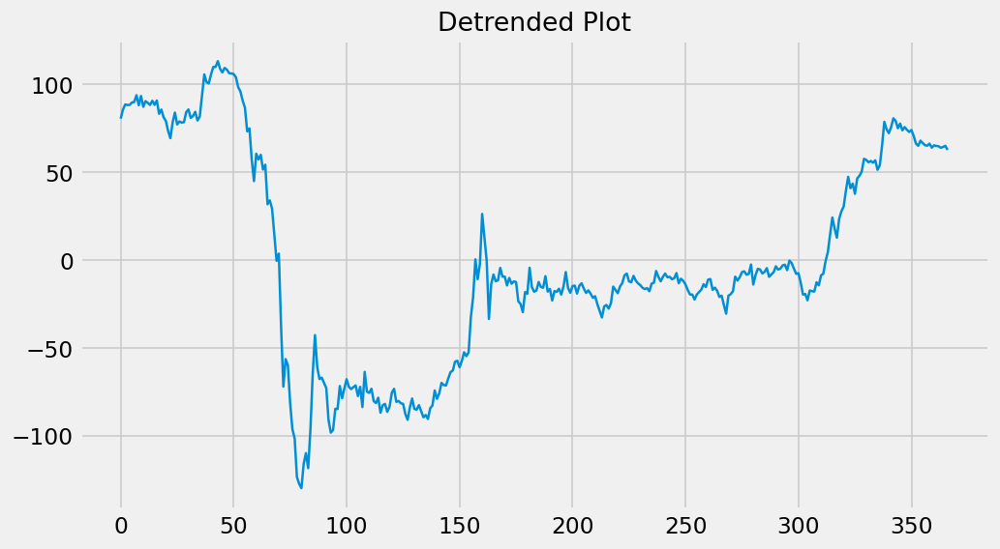

In [109]:
detrended_BA = signal.detrend(BA_all_dates_KNN_df['Close'])
plt.plot(detrended_BA)
plt.title('Detrended Plot', fontsize=16)

[]

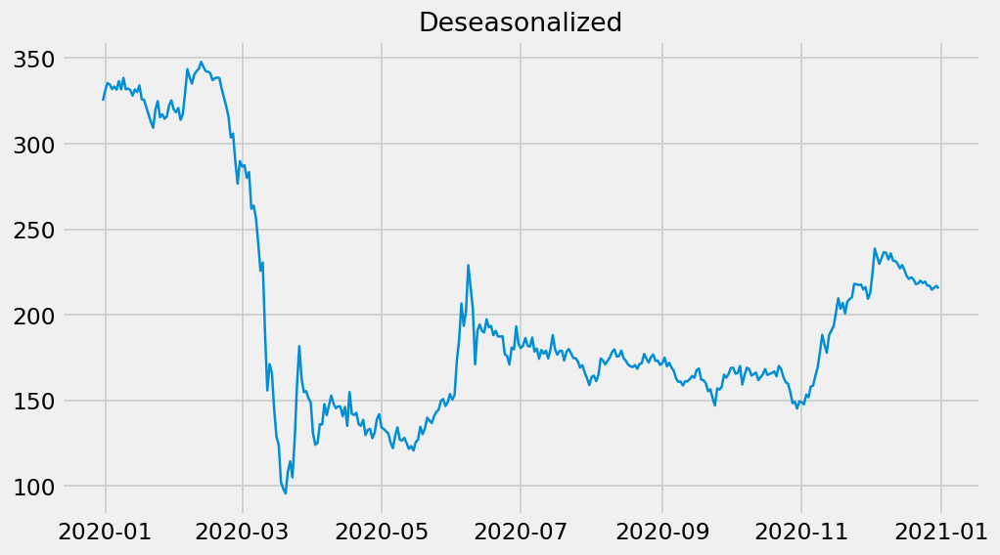

In [110]:
# Time Series Decomposition
# result_mul = seasonal_decompose(df['value'], model='multiplicative', extrapolate_trend='freq')

# Deseasonalize
deseasonalized = BA_all_dates_KNN_df['Close'].values / result_mul_BA.seasonal

# Plot
plt.plot(deseasonalized)
plt.title('Deseasonalized', fontsize=16)
plt.plot()

In [111]:
deseasonalised_BA_list = []

for col in BA_all_dates_KNN_stationary_df.columns:
    deseasonalised = BA_all_dates_KNN_df[col].values / result_mul_BA.seasonal 
    
    deseasonalised_BA_list.append(deseasonalised)

BA_deseasonalised_stationary = pd.DataFrame(deseasonalised_BA_list).T  # Transpose to keep the structure

BA_deseasonalised_stationary.index =  pd.date_range(start='2019-12-31', end='2020-12-31', freq='D')

BA_deseasonalised_stationary.columns = BA_all_dates_KNN_stationary_df.columns

## 4. DIS

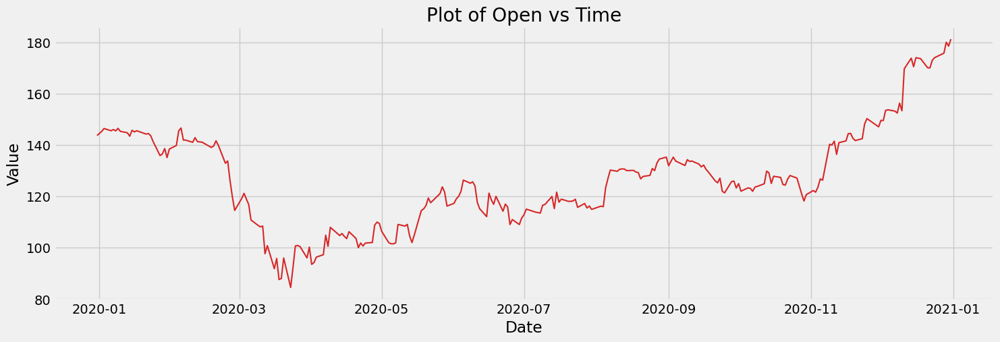

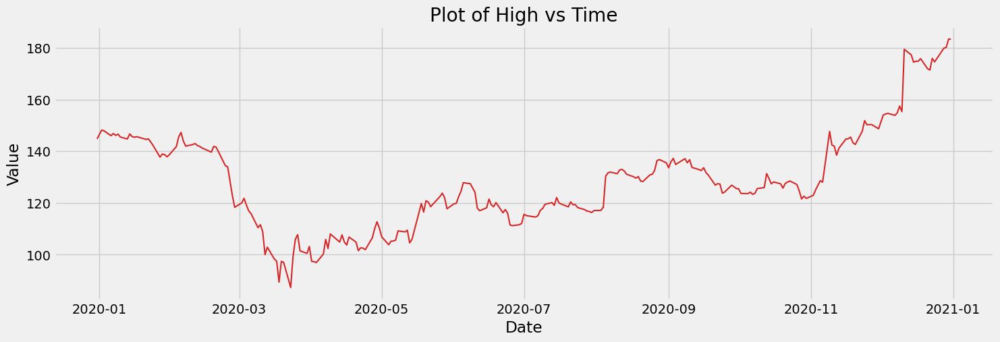

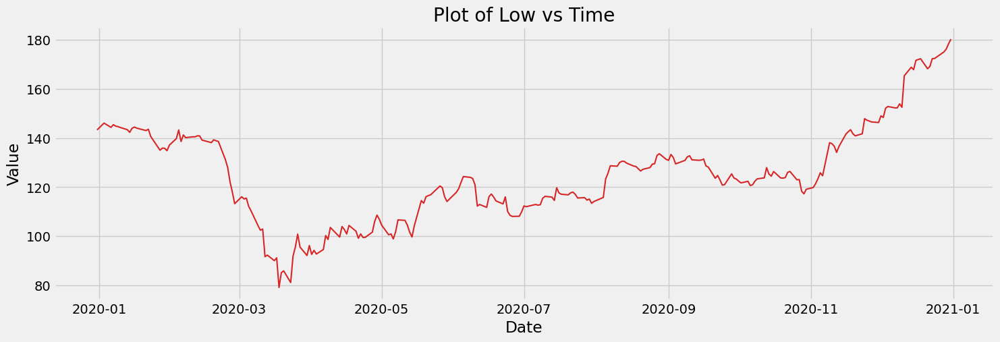

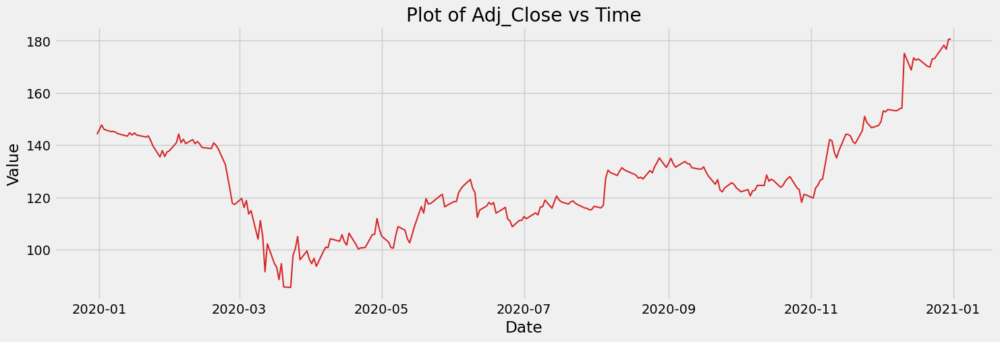

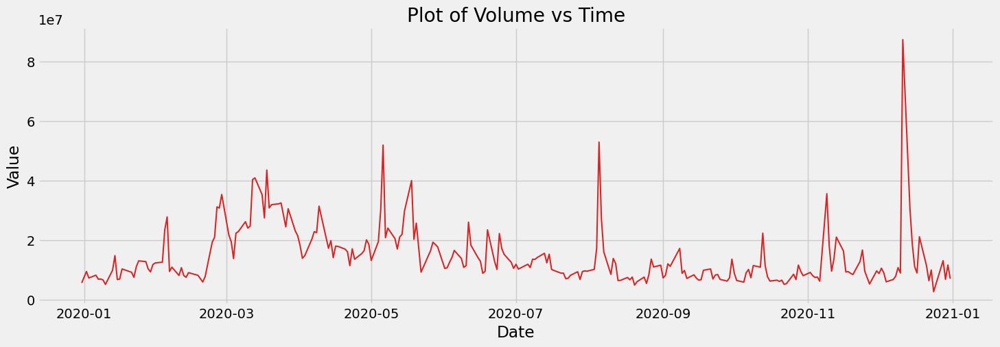

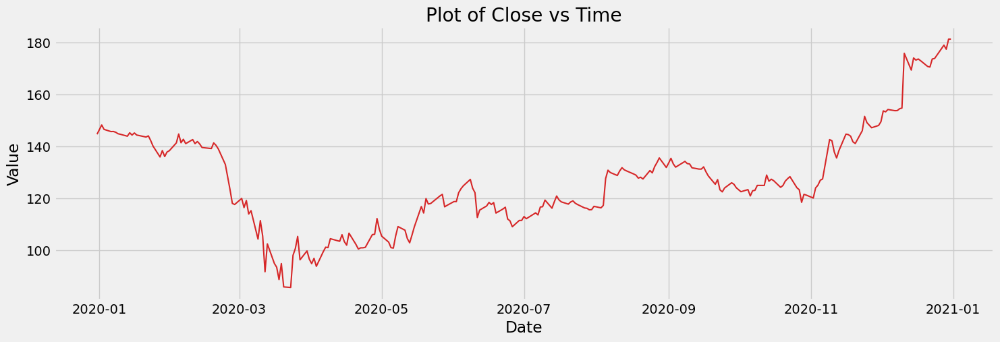

In [113]:
for column in DIS_df.columns:
    plot_df_trendlines(DIS_df, x=DIS_df.index, y=DIS_df[column], title=f'Plot of {column} vs Time')

matplotlib.category INFO  Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
matplotlib.category INFO  Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


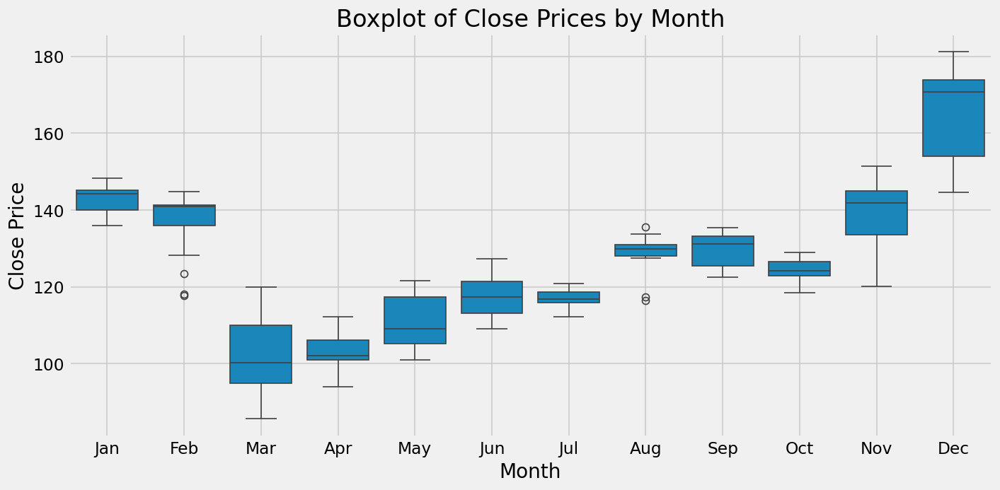

In [114]:
DIS_df['month'] = DIS_df.index.month

# Create boxplot
plt.figure(figsize=(12, 6))
sns.boxplot(x='month', y='Close', data=DIS_df)
plt.title('Boxplot of Close Prices by Month')
plt.xlabel('Month')
plt.ylabel('Close Price')
plt.xticks(ticks=range(12), labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 
                                      'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
plt.tight_layout()
plt.show()
DIS_df = DIS_df.drop('month', axis=1)

<Axes: title={'center': 'Seasonal Mean'}>

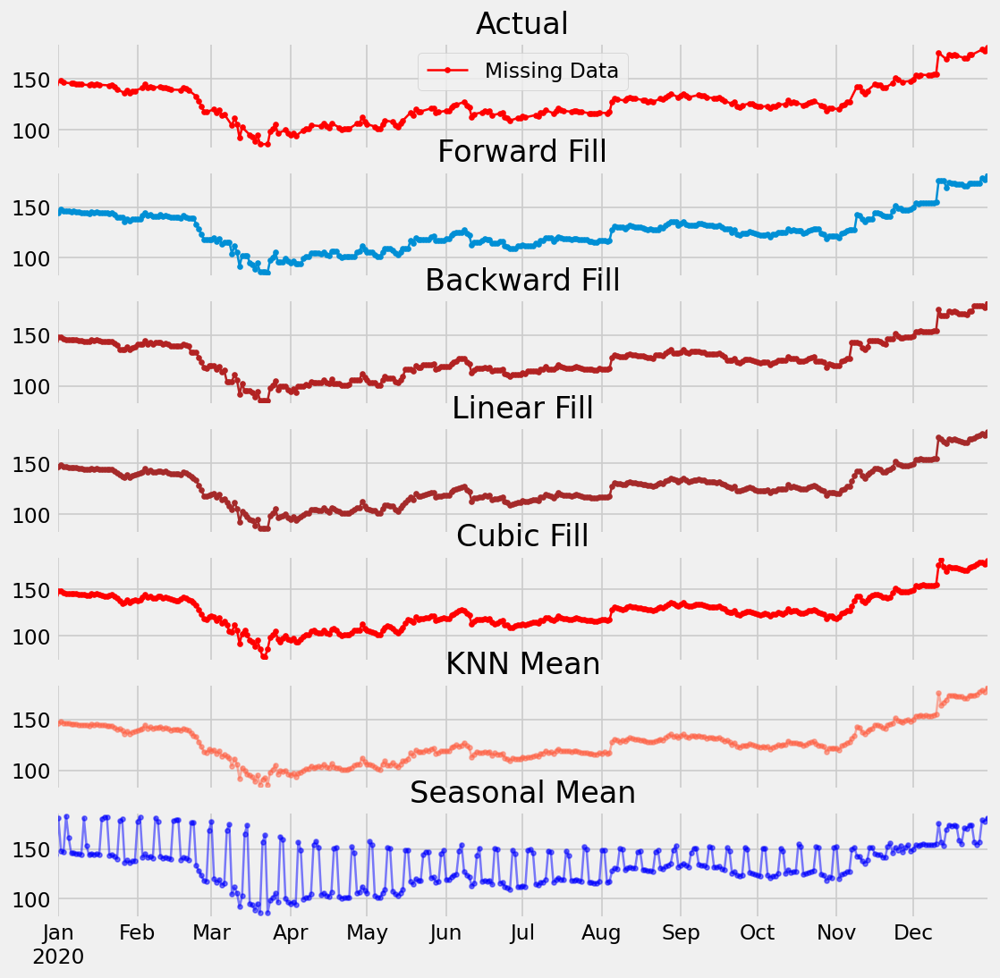

In [115]:
fig, axes = plt.subplots(7, 1, sharex=True, figsize=(10, 12))
plt.rcParams.update({'xtick.bottom' : False})


## 1. Actual -------------------------------
DIS_Close_df = pd.DataFrame(DIS_df['Close'])
DIS_Close_df.plot(title='Actual', ax=axes[0], label='Actual', color='red', style=".-")
axes[0].legend(["Missing Data", "Available Data"])

## 2. Forward Fill --------------------------
df_ffill = result_DIS.ffill()
df_ffill['Close'].plot(title='Forward Fill', ax=axes[1], label='Forward Fill', style=".-")


# 3. Backward Fill -------------------------
df_bfill = result_DIS.bfill()
df_bfill['Close'].plot(title="Backward Fill", ax=axes[2], label='Back Fill', color='firebrick', style=".-")

## 4. Linear Interpolation ------------------
result_DIS['rownum'] = range(1, len(result_DIS) + 1)

result_DIS['rownum'] = np.arange(result_DIS.shape[0])
df_nona = result_DIS.dropna(subset = ['Close'])
f = interp1d(df_nona['rownum'], df_nona['Close'])
result_DIS['linear_fill'] = f(result_DIS['rownum'])
result_DIS['linear_fill'].plot(title="Linear Fill", ax=axes[3], label='Cubic Fill', color='brown', style=".-")

## 5. Cubic Interpolation --------------------
f2 = interp1d(df_nona['rownum'], df_nona['Close'], kind='cubic')
result_DIS['cubic_fill'] = f2(result_DIS['rownum'])
result_DIS['cubic_fill'].plot(title="Cubic Fill", ax=axes[4], label='Cubic Fill', color='red', style=".-")

# Interpolation References:
# https://docs.scipy.org/doc/scipy/reference/tutorial/interpolate.html
# https://docs.scipy.org/doc/scipy/reference/interpolate.html

## 6. Mean of 'n' Nearest Past Neighbors ------
def knn_mean(ts, n):
    out = np.copy(ts)
    for i, val in enumerate(ts):
        if np.isnan(val):
            n_by_2 = np.ceil(n/2)
            lower = np.max([0, int(i-n_by_2)])
            upper = np.min([len(ts)+1, int(i+n_by_2)])
            ts_near = np.concatenate([ts[lower:i], ts[i:upper]])
            out[i] = np.nanmean(ts_near)
    return out

result_DIS['knn_mean'] = knn_mean(result_DIS['Close'].values, 8)
result_DIS['knn_mean'].plot(title="KNN Mean", ax=axes[5], label='KNN Mean', color='tomato', alpha=0.5, style=".-")

## 7. Seasonal Mean ----------------------------
def seasonal_mean(ts, n, lr=0.7):
    """
    Compute the mean of corresponding seasonal periods
    ts: 1D array-like of the time series
    n: Seasonal window length of the time series
    """
    out = np.copy(ts)
    for i, val in enumerate(ts):
        if np.isnan(val):
            ts_seas = ts[i-1::-n]  # previous seasons only
            if np.isnan(np.nanmean(ts_seas)):
                ts_seas = np.concatenate([ts[i-1::-n], ts[i::n]])  # previous and forward
            out[i] = np.nanmean(ts_seas) * lr
    return out

result_DIS['seasonal_mean'] = seasonal_mean(result_DIS['Close'], n=12, lr=1.25)
result_DIS['seasonal_mean'].plot(title="Seasonal Mean", ax=axes[6], label='Seasonal Mean', color='blue', alpha=0.5, style=".-")

In [116]:
DIS_all_dates_KNN_df = result_DIS.apply(lambda col: knn_mean(col.values, 8), axis=0)
DIS_all_dates_KNN_df = DIS_all_dates_KNN_df.drop(['rownum', 'linear_fill','cubic_fill', 'knn_mean', 'seasonal_mean'], axis=1)

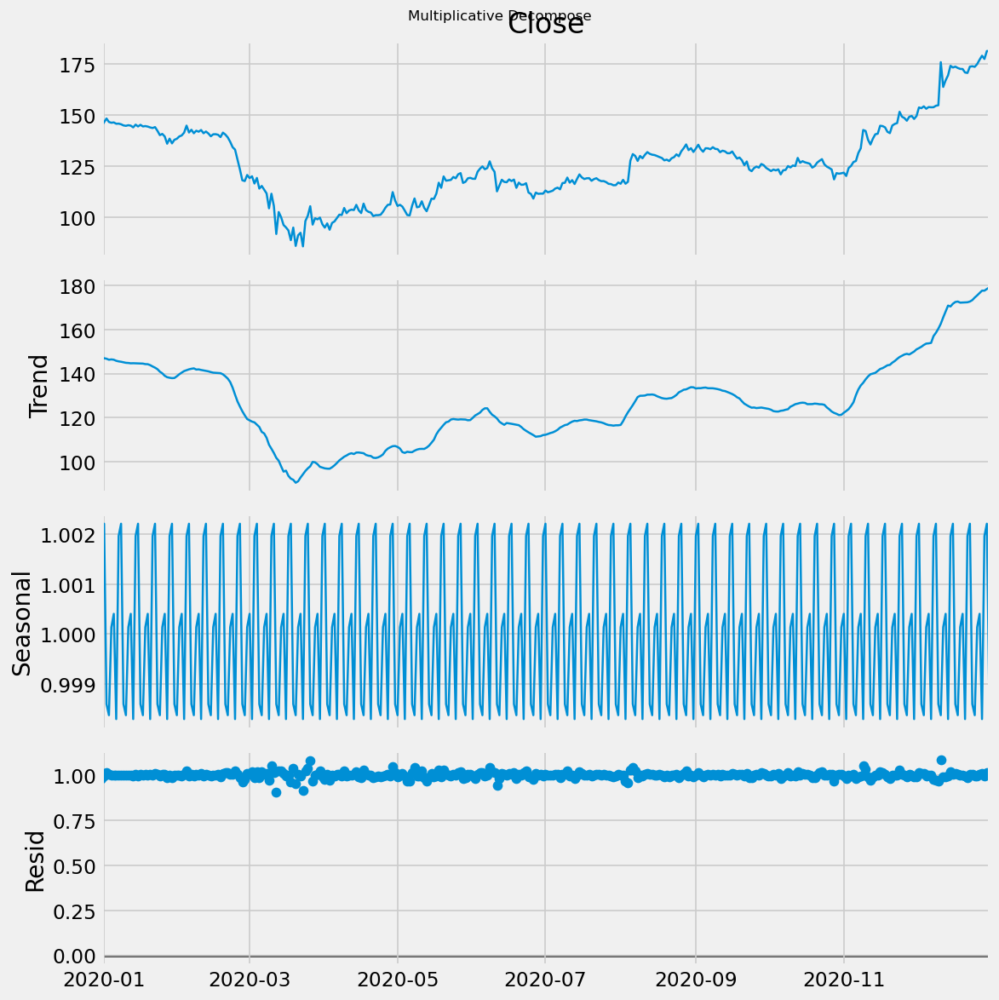

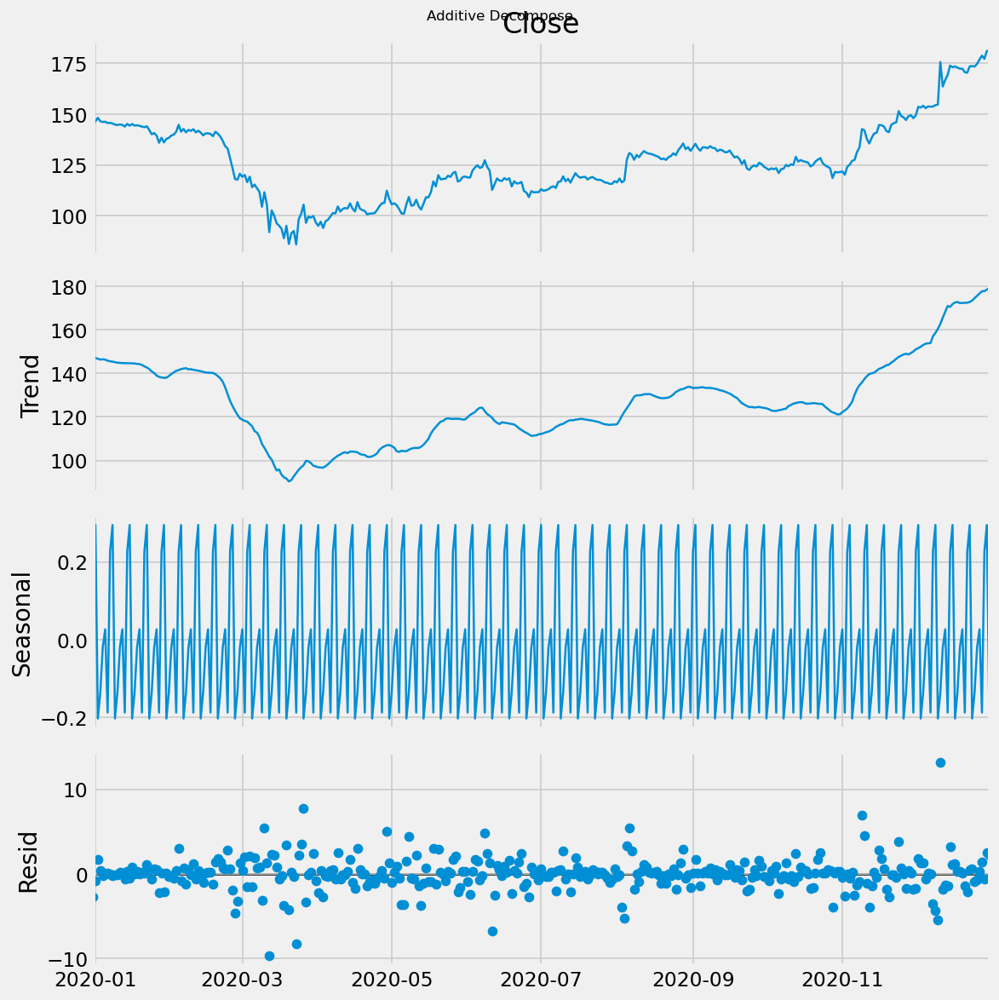

In [117]:
# Multiplicative Decomposition 
result_mul_DIS = seasonal_decompose(DIS_all_dates_KNN_df['Close'], model='multiplicative', extrapolate_trend='freq')

# Additive Decomposition
result_add_DIS  = seasonal_decompose(DIS_all_dates_KNN_df['Close'], model='additive', extrapolate_trend='freq')

# Plot
plt.rcParams.update({'figure.figsize': (10,10)})
result_mul_DIS.plot().suptitle('Multiplicative Decompose', fontsize=10)
result_add_DIS.plot().suptitle('Additive Decompose', fontsize=10)
plt.show()

In [118]:
# Extract the Components ----
# Actual Values = Product of (Seasonal * Trend * Resid), Multiplicative is random, therefore using it 
DIS_df_reconstructed = pd.concat([result_add_DIS.seasonal, result_add_DIS.trend, result_add_DIS.resid, result_add_DIS.observed], axis=1)
DIS_df_reconstructed.columns = ['seas', 'trend', 'resid', 'actual_values']
DIS_df_reconstructed.head()

,seas,trend,resid,actual_values
2019-12-31,0.226309,147.171667,-2.767976,144.630000
2020-01-01,0.294957,146.945952,-0.797576,146.443333
2020-01-02,-0.203158,146.720238,1.682920,148.200000
2020-01-03,-0.135999,146.264190,0.371809,146.500000
2020-01-04,-0.020694,146.417048,-0.260353,146.136000


<Axes: xlabel='Lag', ylabel='Autocorrelation'>

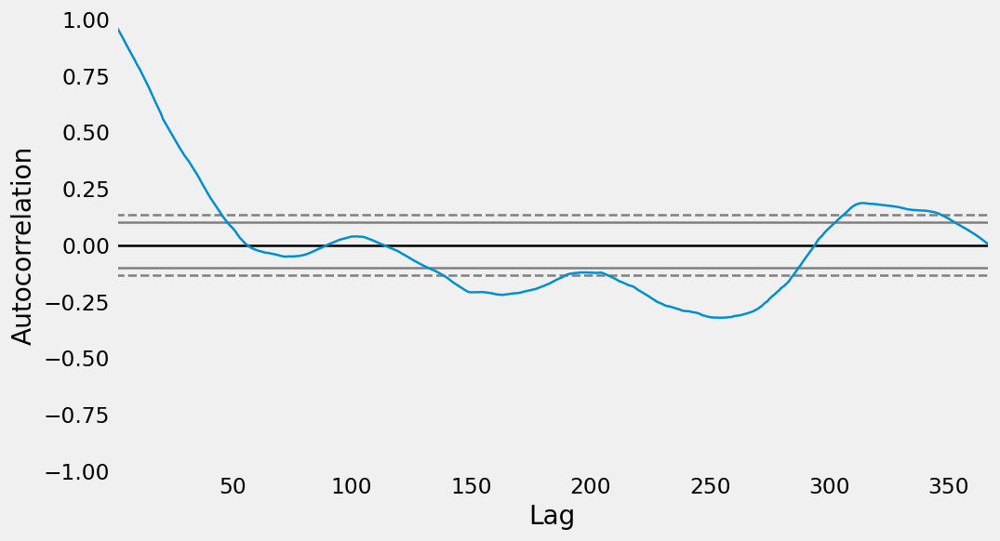

In [119]:
# Draw Plot - shows seasonality
plt.rcParams.update({'figure.figsize':(9,5), 'figure.dpi':120})
autocorrelation_plot(DIS_all_dates_KNN_df['Close'].tolist())

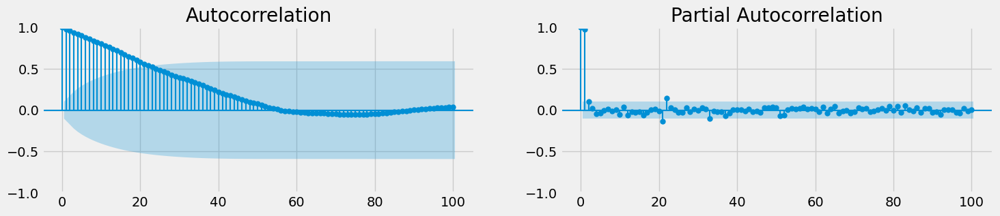

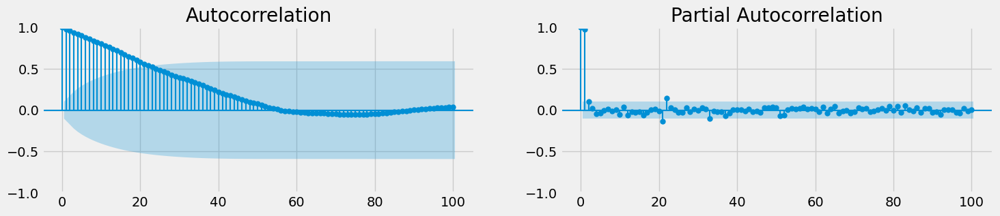

In [120]:
# Calculate ACF and PACF upto 50 lags
acf_50 = acf(DIS_all_dates_KNN_df['Close'], nlags=100)
pacf_50 = pacf(DIS_all_dates_KNN_df['Close'], nlags=100)

# Draw Plot
fig, axes = plt.subplots(1,2,figsize=(16,3), dpi= 100)
plot_acf(DIS_all_dates_KNN_df['Close'].tolist(), lags=100, ax=axes[0])
plot_pacf(DIS_all_dates_KNN_df['Close'].tolist(), lags=100, ax=axes[1])

Text(0.5, 1.15, '')

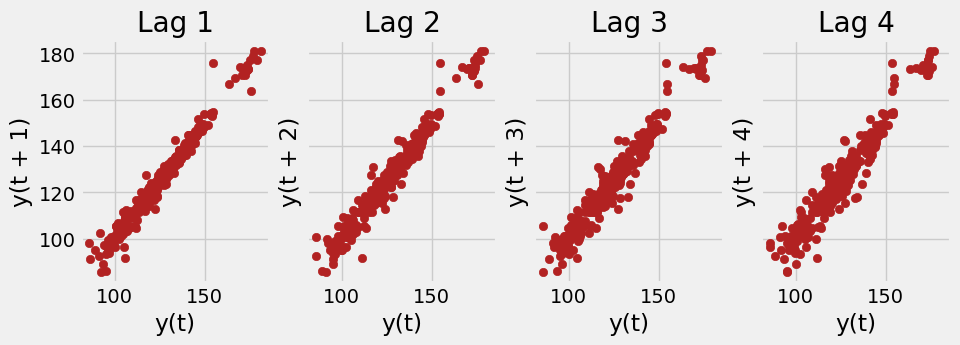

In [121]:
# Plot
fig, axes = plt.subplots(1, 4, figsize=(10,3), sharex=True, sharey=True, dpi=100)
for i, ax in enumerate(axes.flatten()[:4]):
    lag_plot(DIS_all_dates_KNN_df['Close'], lag=i+1, ax=ax, c='firebrick')
    ax.set_title('Lag ' + str(i+1))

fig.suptitle('', y=1.15)   

In [122]:
# ADF Test - Stationary, p < 0.05 
result = adfuller(DIS_all_dates_KNN_df['Close'].values, autolag='AIC')
print(f'ADF Statistic: {result[0]}')
print(f'p-value: {result[1]}')
for key, value in result[4].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

# KPSS Test - Stationary, p > 0.05
result = kpss(DIS_all_dates_KNN_df['Close'].values, regression='c')
print('\nKPSS Statistic: %f' % result[0])
print('p-value: %f' % result[1])
for key, value in result[3].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

ADF Statistic: 0.45985610034941
p-value: 0.983600506370501
Critial Values:
   1%, -3.4483935212959844
Critial Values:
   5%, -2.8694912343676497
Critial Values:
   10%, -2.571005879151811

KPSS Statistic: 0.972840
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


In [123]:
DIS_all_dates_KNN_stationary_df = DIS_all_dates_KNN_df.diff().diff().dropna() #Second difference taken 
# Integration to go back to original 
# AAPL_all_dates_KNN_df = AAPL_all_dates_KNN_df.iloc[0] + AAPL_all_dates_KNN_stationary_df.cumsum()

index = pd.date_range(start='2020-01-02', end='2020-12-31', freq='D')
DIS_all_dates_KNN_stationary_df.index =index

# ADF Test - Stationary, p < 0.05 
result = adfuller(DIS_all_dates_KNN_stationary_df['Close'].values, autolag='AIC')
print(f'ADF Statistic: {result[0]}')
print(f'p-value: {result[1]}')
for key, value in result[4].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

# KPSS Test - Stationary, p > 0.05
result = kpss(DIS_all_dates_KNN_stationary_df['Close'].values, regression='c')
print('\nKPSS Statistic: %f' % result[0])
print('p-value: %f' % result[1])
for key, value in result[3].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

ADF Statistic: -8.98308882577639
p-value: 7.221326562898493e-15
Critial Values:
   1%, -3.44911857009962
Critial Values:
   5%, -2.8698097654570507
Critial Values:
   10%, -2.5711757061225153

KPSS Statistic: 0.500000
p-value: 0.041667
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


In [124]:
print(ApEn(DIS_all_dates_KNN_df['Close'], m=2, r=0.2*np.std(DIS_all_dates_KNN_df['Close'])))    
print(SampEn(DIS_all_dates_KNN_df['Close'], m=2, r=0.2*np.std(DIS_all_dates_KNN_df['Close'])))   

0.377247318967314
0.28814226574108054


In [125]:
deseasonalised_DIS_list = []

for col in DIS_all_dates_KNN_stationary_df.columns:
    deseasonalised = DIS_all_dates_KNN_df[col].values / result_mul_DIS.seasonal 
    
    deseasonalised_DIS_list.append(deseasonalised)

DIS_deseasonalised_stationary = pd.DataFrame(deseasonalised_DIS_list).T  # Transpose to keep the structure

DIS_deseasonalised_stationary.index = pd.date_range(start='2019-12-31', end='2020-12-31', freq='D')

DIS_deseasonalised_stationary.columns = DIS_all_dates_KNN_stationary_df.columns.columns = DIS_all_dates_KNN_stationary_df.columns

## 5. TSLA

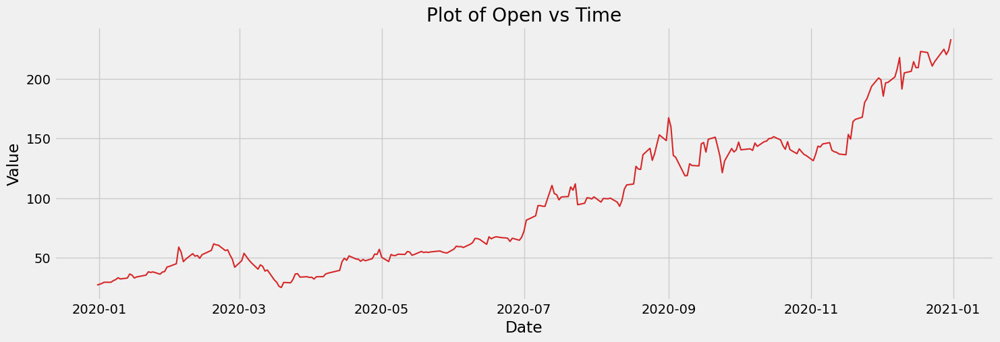

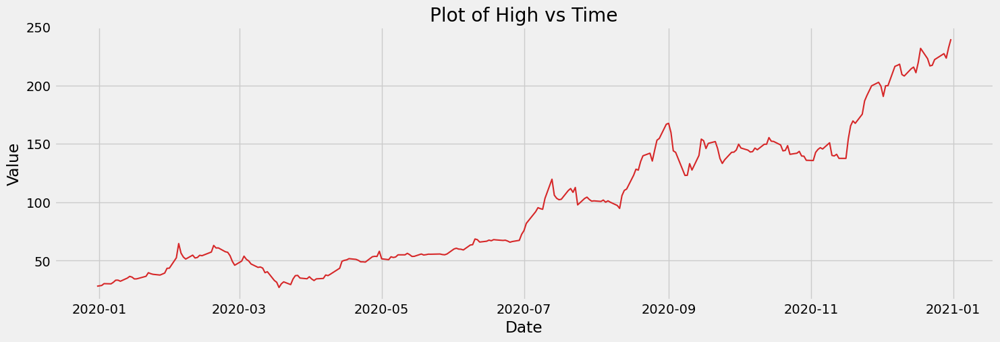

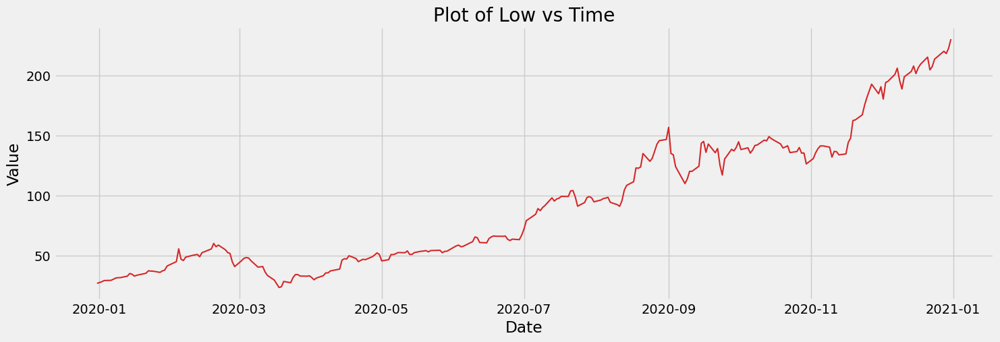

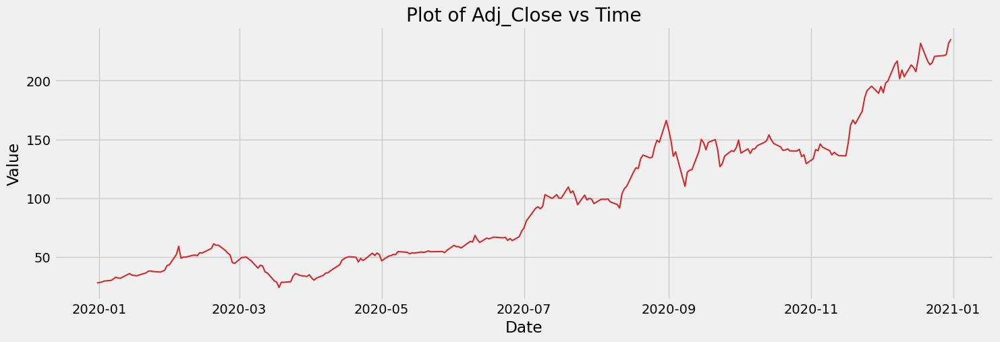

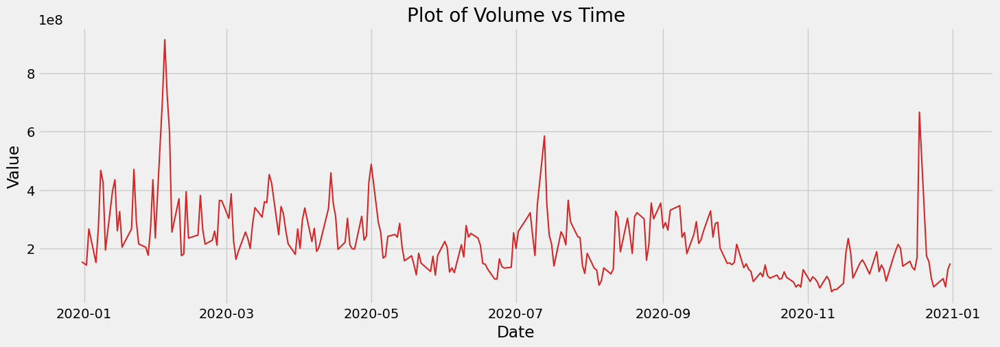

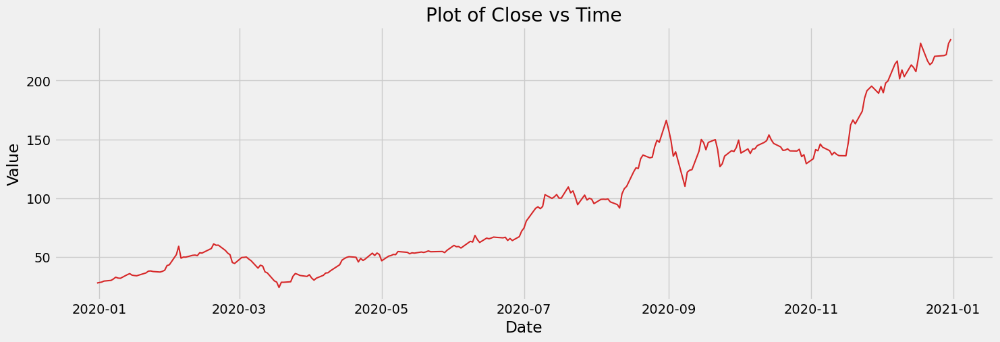

In [127]:
for column in TSLA_df.columns:
    plot_df_trendlines(TSLA_df, x=TSLA_df.index, y=TSLA_df[column], title=f'Plot of {column} vs Time')

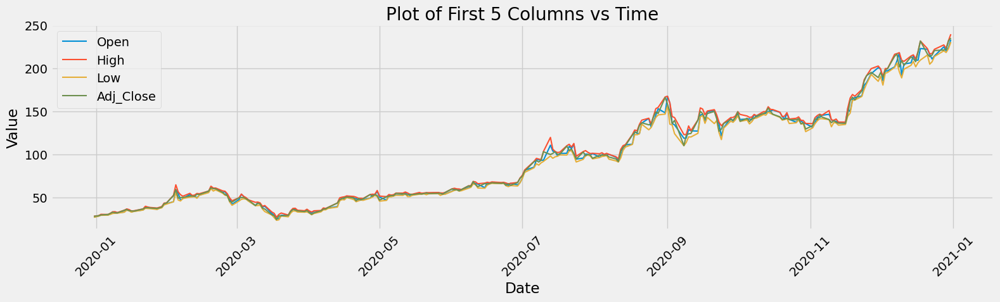

In [128]:
plot_df_one_graph(TSLA_df, title='Plot of First 5 Columns vs Time')

matplotlib.category INFO  Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
matplotlib.category INFO  Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


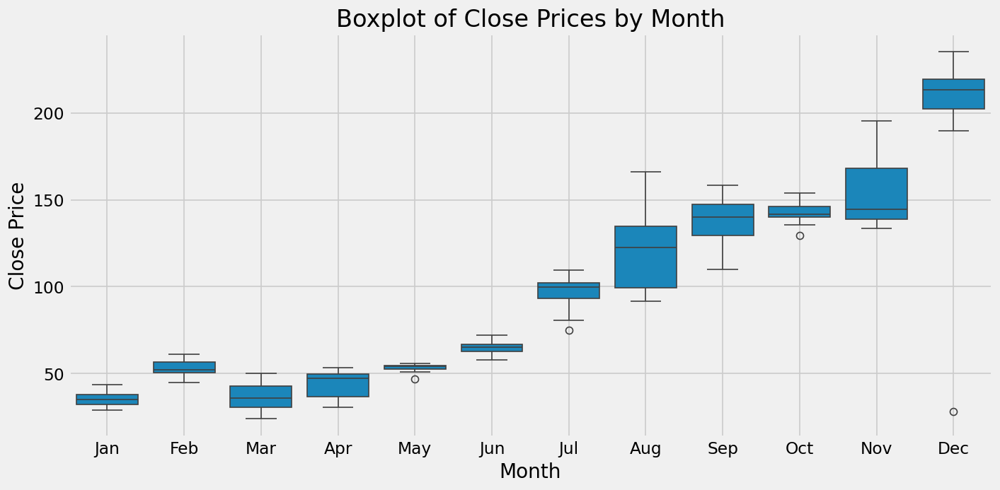

In [129]:
TSLA_df['month'] = TSLA_df.index.month

# Create boxplot
plt.figure(figsize=(12, 6))
sns.boxplot(x='month', y='Close', data=TSLA_df)
plt.title('Boxplot of Close Prices by Month')
plt.xlabel('Month')
plt.ylabel('Close Price')
plt.xticks(ticks=range(12), labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 
                                      'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
plt.tight_layout()
plt.show()
TSLA_df = TSLA_df.drop('month', axis=1)

<Axes: title={'center': 'Seasonal Mean'}>

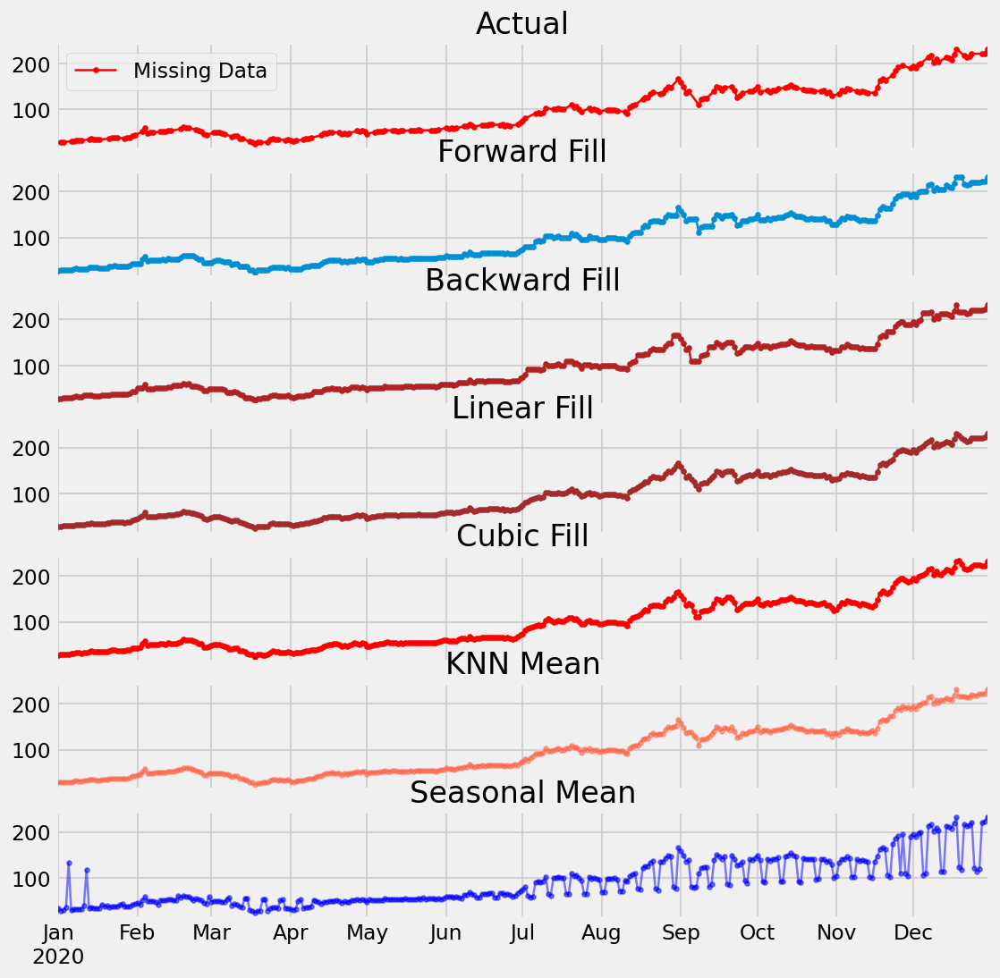

In [130]:
fig, axes = plt.subplots(7, 1, sharex=True, figsize=(10, 12))
plt.rcParams.update({'xtick.bottom' : False})


## 1. Actual -------------------------------
TSLA_Close_df = pd.DataFrame(TSLA_df['Close'])
TSLA_Close_df.plot(title='Actual', ax=axes[0], label='Actual', color='red', style=".-")
axes[0].legend(["Missing Data", "Available Data"])

## 2. Forward Fill --------------------------
df_ffill = result_TSLA.ffill()
df_ffill['Close'].plot(title='Forward Fill', ax=axes[1], label='Forward Fill', style=".-")


# 3. Backward Fill -------------------------
df_bfill = result_TSLA.bfill()
df_bfill['Close'].plot(title="Backward Fill", ax=axes[2], label='Back Fill', color='firebrick', style=".-")

## 4. Linear Interpolation ------------------
result_TSLA['rownum'] = range(1, len(result_TSLA) + 1)

result_TSLA['rownum'] = np.arange(result_TSLA.shape[0])
df_nona = result_TSLA.dropna(subset = ['Close'])
f = interp1d(df_nona['rownum'], df_nona['Close'])
result_TSLA['linear_fill'] = f(result_TSLA['rownum'])
result_TSLA['linear_fill'].plot(title="Linear Fill", ax=axes[3], label='Cubic Fill', color='brown', style=".-")

## 5. Cubic Interpolation --------------------
f2 = interp1d(df_nona['rownum'], df_nona['Close'], kind='cubic')
result_TSLA['cubic_fill'] = f2(result_TSLA['rownum'])
result_TSLA['cubic_fill'].plot(title="Cubic Fill", ax=axes[4], label='Cubic Fill', color='red', style=".-")

# Interpolation References:
# https://docs.scipy.org/doc/scipy/reference/tutorial/interpolate.html
# https://docs.scipy.org/doc/scipy/reference/interpolate.html

## 6. Mean of 'n' Nearest Past Neighbors ------
def knn_mean(ts, n):
    out = np.copy(ts)
    for i, val in enumerate(ts):
        if np.isnan(val):
            n_by_2 = np.ceil(n/2)
            lower = np.max([0, int(i-n_by_2)])
            upper = np.min([len(ts)+1, int(i+n_by_2)])
            ts_near = np.concatenate([ts[lower:i], ts[i:upper]])
            out[i] = np.nanmean(ts_near)
    return out

result_TSLA['knn_mean'] = knn_mean(result_TSLA['Close'].values, 8)
result_TSLA['knn_mean'].plot(title="KNN Mean", ax=axes[5], label='KNN Mean', color='tomato', alpha=0.5, style=".-")

## 7. Seasonal Mean ----------------------------
def seasonal_mean(ts, n, lr=0.7):
    """
    Compute the mean of corresponding seasonal periods
    ts: 1D array-like of the time series
    n: Seasonal window length of the time series
    """
    out = np.copy(ts)
    for i, val in enumerate(ts):
        if np.isnan(val):
            ts_seas = ts[i-1::-n]  # previous seasons only
            if np.isnan(np.nanmean(ts_seas)):
                ts_seas = np.concatenate([ts[i-1::-n], ts[i::n]])  # previous and forward
            out[i] = np.nanmean(ts_seas) * lr
    return out

result_TSLA['seasonal_mean'] = seasonal_mean(result_TSLA['Close'], n=12, lr=1.25)
result_TSLA['seasonal_mean'].plot(title="Seasonal Mean", ax=axes[6], label='Seasonal Mean', color='blue', alpha=0.5, style=".-")

In [131]:
TSLA_all_dates_KNN_df = result_TSLA.apply(lambda col: knn_mean(col.values, 8), axis=0)
TSLA_all_dates_KNN_df = TSLA_all_dates_KNN_df.drop(['rownum', 'linear_fill',	'cubic_fill', 'knn_mean', 'seasonal_mean'], axis=1)

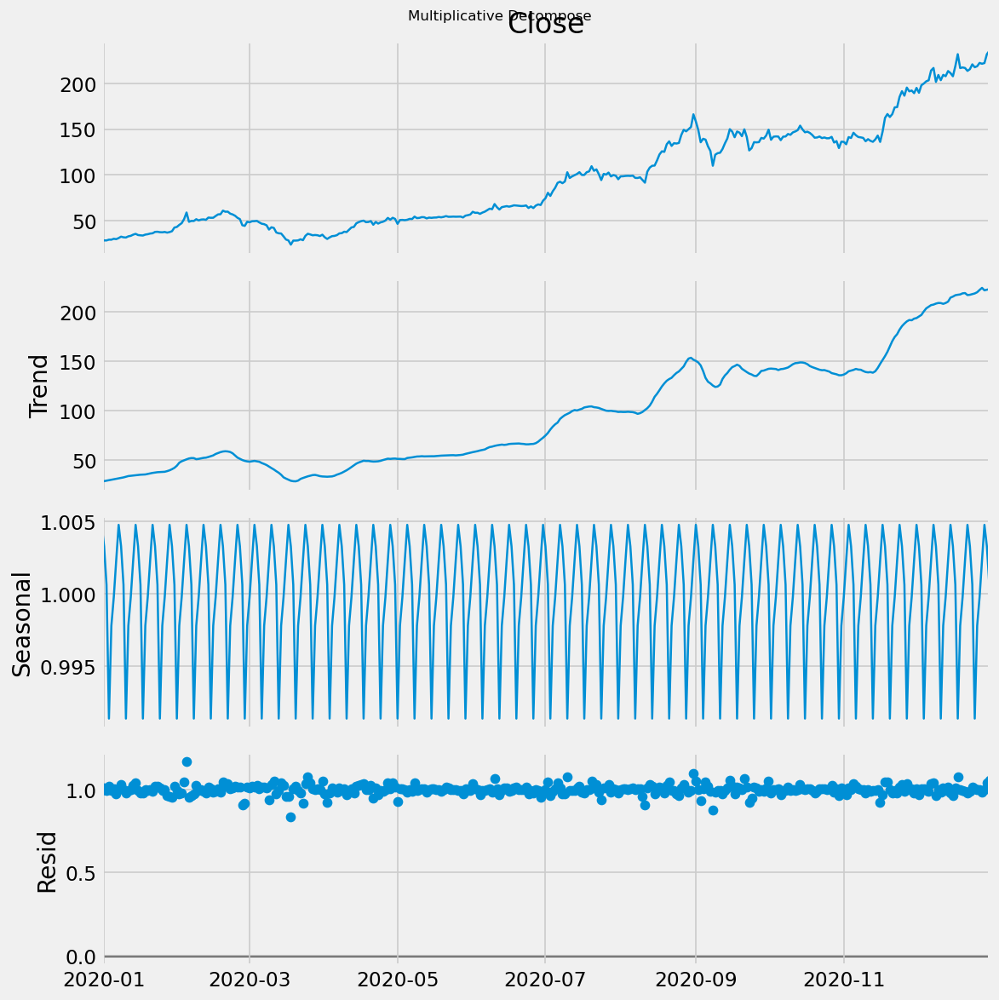

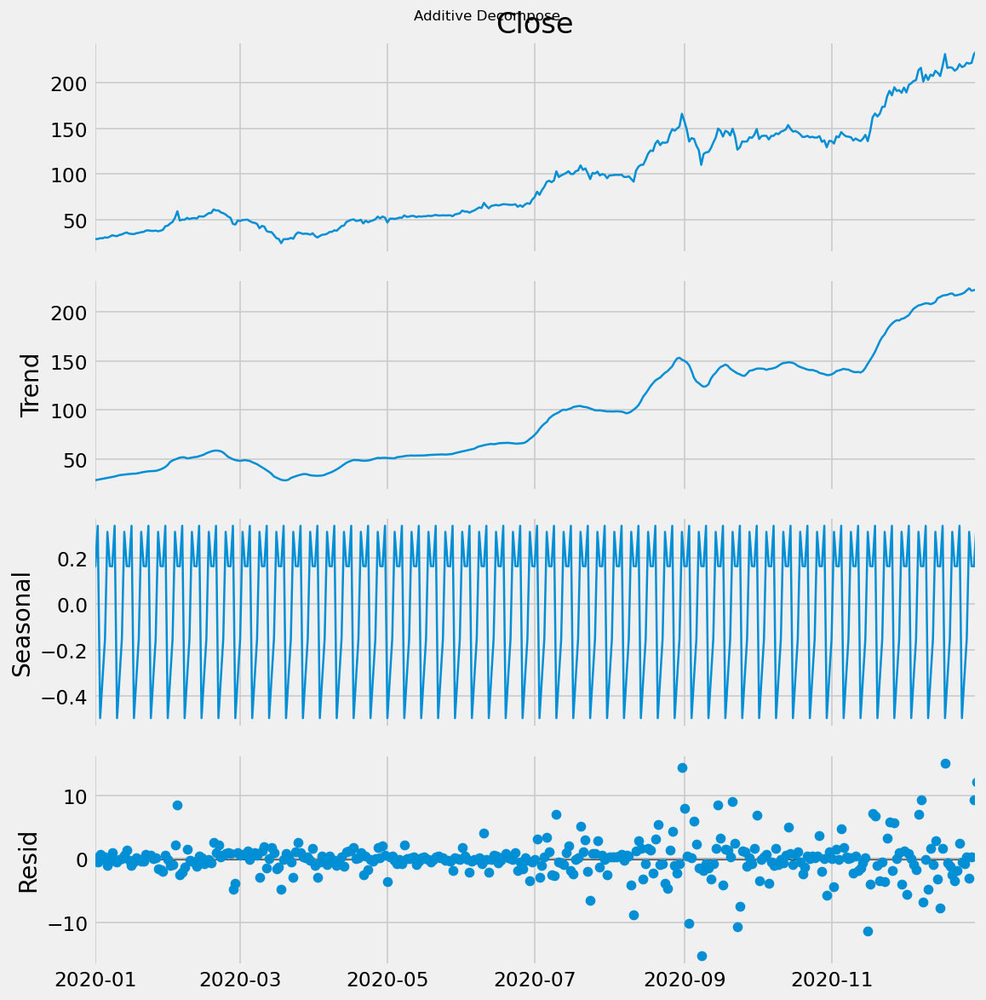

In [132]:
# Multiplicative Decomposition 
result_mul_TSLA = seasonal_decompose(TSLA_all_dates_KNN_df['Close'], model='multiplicative', extrapolate_trend='freq')

# Additive Decomposition
result_add_TSLA  = seasonal_decompose(TSLA_all_dates_KNN_df['Close'], model='additive', extrapolate_trend='freq')

# Plot
plt.rcParams.update({'figure.figsize': (10,10)})
result_mul_TSLA.plot().suptitle('Multiplicative Decompose', fontsize=10)
result_add_TSLA.plot().suptitle('Additive Decompose', fontsize=10)
plt.show()

In [133]:
# Extract the Components ----
# Actual Values = Product of (Seasonal * Trend * Resid), Multiplicative is random, therefore using it 
TSLA_df_reconstructed = pd.concat([result_add_TSLA.seasonal, result_add_TSLA.trend, result_add_TSLA.resid, result_add_TSLA.observed], axis=1)
TSLA_df_reconstructed.columns = ['seas', 'trend', 'resid', 'actual_values']
TSLA_df_reconstructed.head()

,seas,trend,resid,actual_values
2019-12-31,0.163490,27.889309,-0.164099,27.888700
2020-01-01,0.162312,28.364279,0.175643,28.702233
2020-01-02,0.338446,28.839249,-0.493695,28.684000
2020-01-03,-0.496515,29.269685,0.760831,29.534000
2020-01-04,-0.327151,29.752828,0.070344,29.496020


<Axes: xlabel='Lag', ylabel='Autocorrelation'>

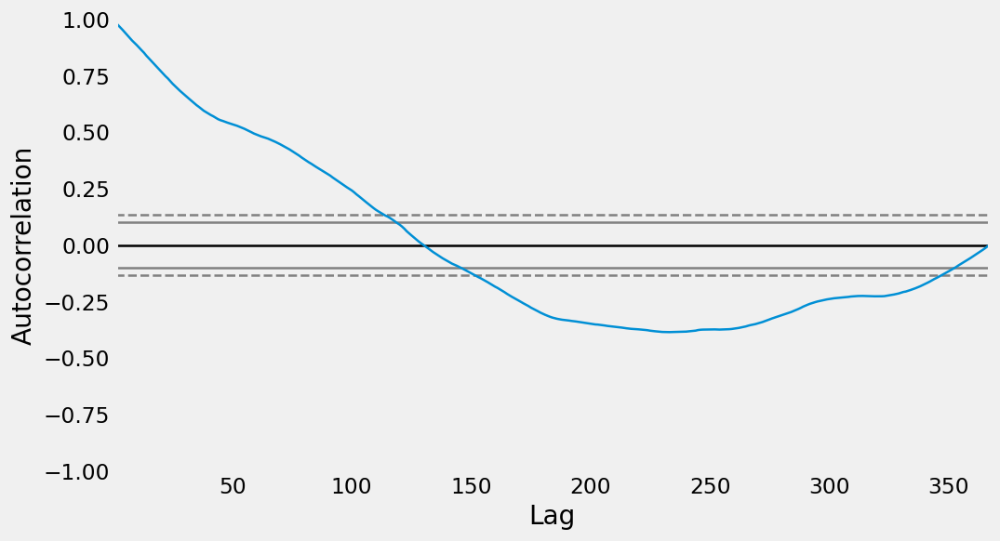

In [134]:
# Draw Plot - shows seasonality
plt.rcParams.update({'figure.figsize':(9,5), 'figure.dpi':120})
autocorrelation_plot(TSLA_all_dates_KNN_df['Close'].tolist())

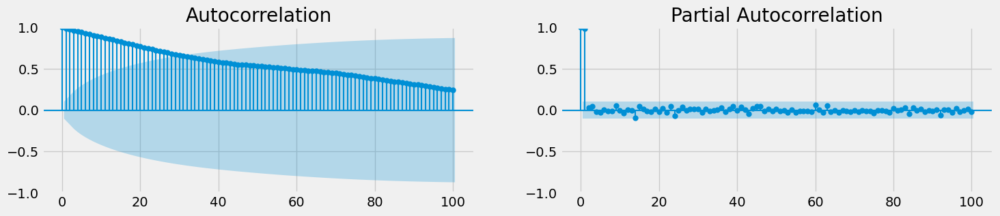

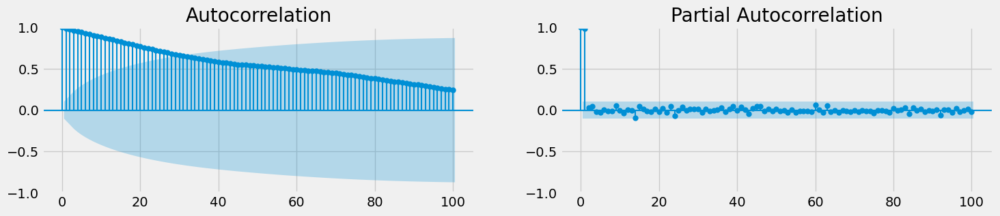

In [135]:
# Calculate ACF and PACF upto 50 lags
acf_50 = acf(TSLA_all_dates_KNN_df['Close'], nlags=100)
pacf_50 = pacf(TSLA_all_dates_KNN_df['Close'], nlags=100)

# Draw Plot
fig, axes = plt.subplots(1,2,figsize=(16,3), dpi= 100)
plot_acf(TSLA_all_dates_KNN_df['Close'].tolist(), lags=100, ax=axes[0])
plot_pacf(TSLA_all_dates_KNN_df['Close'].tolist(), lags=100, ax=axes[1])

Text(0.5, 1.15, '')

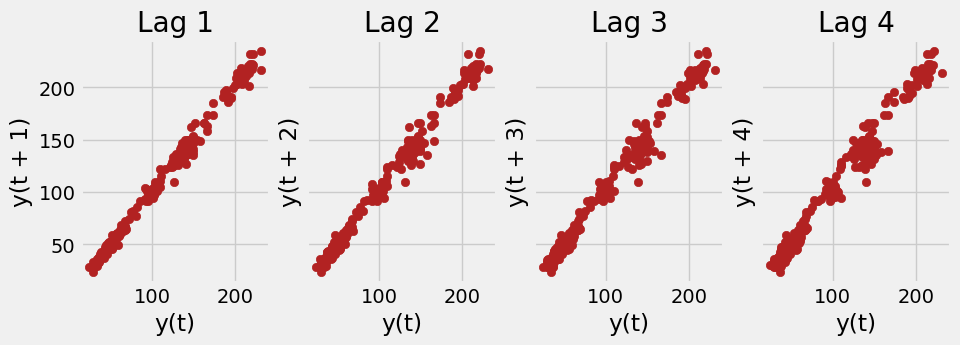

In [136]:
# Plot
fig, axes = plt.subplots(1, 4, figsize=(10,3), sharex=True, sharey=True, dpi=100)
for i, ax in enumerate(axes.flatten()[:4]):
    lag_plot(TSLA_all_dates_KNN_df['Close'], lag=i+1, ax=ax, c='firebrick')
    ax.set_title('Lag ' + str(i+1))

fig.suptitle('', y=1.15)    

In [137]:
# ADF Test - Stationary, p < 0.05 
result = adfuller(TSLA_all_dates_KNN_df['Close'].values, autolag='AIC')
print(f'ADF Statistic: {result[0]}')
print(f'p-value: {result[1]}')
for key, value in result[4].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

# KPSS Test - Stationary, p > 0.05
result = kpss(TSLA_all_dates_KNN_df['Close'].values, regression='c')
print('\nKPSS Statistic: %f' % result[0])
print('p-value: %f' % result[1])
for key, value in result[3].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

ADF Statistic: 1.3898125028967372
p-value: 0.9970673667668256
Critial Values:
   1%, -3.448748905151901
Critial Values:
   5%, -2.8696473721448728
Critial Values:
   10%, -2.5710891239349585

KPSS Statistic: 2.889997
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


In [138]:
TSLA_all_dates_KNN_stationary_df = TSLA_all_dates_KNN_df.diff().dropna() #Differentiate 

TSLA_all_dates_KNN_stationary_df = np.log(TSLA_all_dates_KNN_stationary_df) #Find the log
TSLA_all_dates_KNN_stationary_df = TSLA_all_dates_KNN_stationary_df.replace([np.inf, -np.inf], 0)
TSLA_all_dates_KNN_stationary_df.fillna(0, inplace=True)

# Integration to go back to original 
# AAPL_all_dates_KNN_df = AAPL_all_dates_KNN_df.iloc[0] + AAPL_all_dates_KNN_stationary_df.cumsum()


type(TSLA_all_dates_KNN_stationary_df)
index = pd.date_range(start='2020-01-01', end='2020-12-31', freq='D')
TSLA_all_dates_KNN_stationary_df.index = index

# ADF Test - Stationary, p < 0.05 
result = adfuller(TSLA_all_dates_KNN_stationary_df['Close'].values, autolag='AIC')
print(f'ADF Statistic: {result[0]}')
print(f'p-value: {result[1]}')
for key, value in result[4].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

# KPSS Test - Stationary, p > 0.05
result = kpss(TSLA_all_dates_KNN_stationary_df['Close'].values, regression='c')
print('\nKPSS Statistic: %f' % result[0])
print('p-value: %f' % result[1])
for key, value in result[3].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

ADF Statistic: -4.571022679676013
p-value: 0.00014602250234577882
Critial Values:
   1%, -3.448748905151901
Critial Values:
   5%, -2.8696473721448728
Critial Values:
   10%, -2.5710891239349585

KPSS Statistic: 1.396477
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


In [139]:
print(ApEn(TSLA_all_dates_KNN_df['Close'], m=2, r=0.2*np.std(AAPL_all_dates_KNN_df['Close'])))    
print(SampEn(TSLA_all_dates_KNN_df['Close'], m=2, r=0.2*np.std(AAPL_all_dates_KNN_df['Close'])))    

0.414433425151679
0.28356684030667434


In [140]:
columns = [TSLA_all_dates_KNN_df.columns]
results_TSLA_list = []

for col in TSLA_all_dates_KNN_df.columns:
    if col != 'Close':  # Ensure we don't test 'Close' against itself
        test_result = grangercausalitytests(TSLA_all_dates_KNN_df[['Close', col]], maxlag=10, verbose=False)
        
        for lag, result in test_result.items():
            f_statistic = result[0]['ssr_ftest'][0]  # Extract F-statistic
            p_value = result[0]['ssr_ftest'][1]      # Extract p-value
            
            # Append the results to the list
            results_TSLA_list.append({
                'Variable': col,
                'Lag': lag,
                'F-Statistic': f_statistic,
                'P-Value': p_value
            })

# Convert the list of results to a DataFrame
results_TSLA_df = pd.DataFrame(results_TSLA_list)
results_TSLA_df.head()

,Variable,Lag,F-Statistic,P-Value
0,compound_score,1,0.013958,0.906017
1,compound_score,2,0.090611,0.913394
2,compound_score,3,0.748584,0.523753
3,compound_score,4,0.647112,0.629252
4,compound_score,5,0.761291,0.578245


Text(0.5, 1.0, 'Detrended Plot')

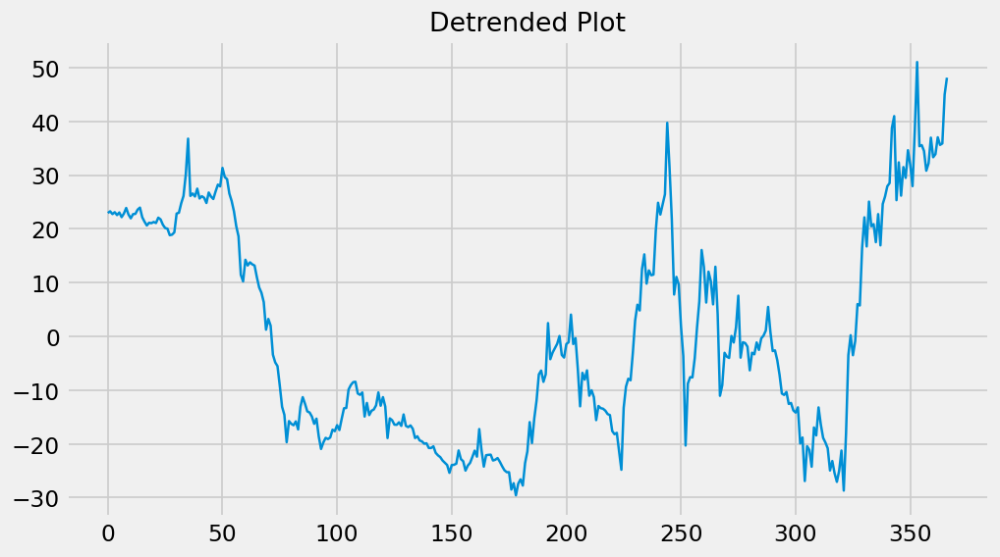

In [141]:
detrended_TSLA = signal.detrend(TSLA_all_dates_KNN_df['Close'])
plt.plot(detrended_TSLA)
plt.title('Detrended Plot', fontsize=16)

In [142]:
detrended_TSLA_list = []

for col in TSLA_all_dates_KNN_stationary_df.columns:
    detrended = signal.detrend(TSLA_all_dates_KNN_stationary_df[col])
    
    detrended_TSLA_list.append(detrended)

TSLA_detrended_stationary = pd.DataFrame(detrended_TSLA_list).T  # Transpose to keep the structure

TSLA_detrended_stationary.index = TSLA_all_dates_KNN_stationary_df.index

TSLA_detrended_stationary.columns = TSLA_all_dates_KNN_stationary_df.columns

# 3. Autogressive Models

## 1. AAPL

In [145]:
steps = 73

data_train = AAPL_detrended_stationary[:-steps]
data_test  = AAPL_detrended_stationary[-steps:]

print(f"Train dates : {data_train.index.min()} --- {data_train.index.max()}  (n={len(data_train)})")
print(f"Test dates  : {data_test.index.min()} --- {data_test.index.max()}  (n={len(data_test)})")

Train dates : 2020-01-01 00:00:00 --- 2020-10-19 00:00:00  (n=293)
Test dates  : 2020-10-20 00:00:00 --- 2020-12-31 00:00:00  (n=73)


In [146]:
# Create and train forecaster
# ==============================================================================
from sklearn.svm import SVR

forecaster = ForecasterAutoreg(
                regressor = SVR(C=1.0, kernel='rbf'),
                lags = 7
                )

forecaster.fit(y=data_train['Close'])
forecaster

ForecasterAutoreg 
Regressor: SVR() 
Lags: [1 2 3 4 5 6 7] 
Transformer for y: None 
Transformer for exog: None 
Window size: 7 
Weight function included: False 
Differentiation order: None 
Exogenous included: False 
Exogenous variables names: None 
Training range: [Timestamp('2020-01-01 00:00:00'), Timestamp('2020-10-19 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: D 
Regressor parameters: {'C': 1.0, 'cache_size': 200, 'coef0': 0.0, 'degree': 3, 'epsilon': 0.1, 'gamma': 'scale', 'kernel': 'rbf', 'max_iter': -1, 'shrinking': True, 'tol': 0.001, 'verbose': False} 
fit_kwargs: {} 
Creation date: 2024-11-07 16:17:41 
Last fit date: 2024-11-07 16:17:41 
Skforecast version: 0.13.0 
Python version: 3.12.3 
Forecaster id: None 

In [147]:
# Predictions
# ==============================================================================
predictions = forecaster.predict(steps=steps)
predictions.head(5)

2020-10-20    0.311805
2020-10-21    0.217980
2020-10-22    0.143657
2020-10-23   -0.393596
2020-10-24    0.764596
Freq: D, Name: pred, dtype: float64

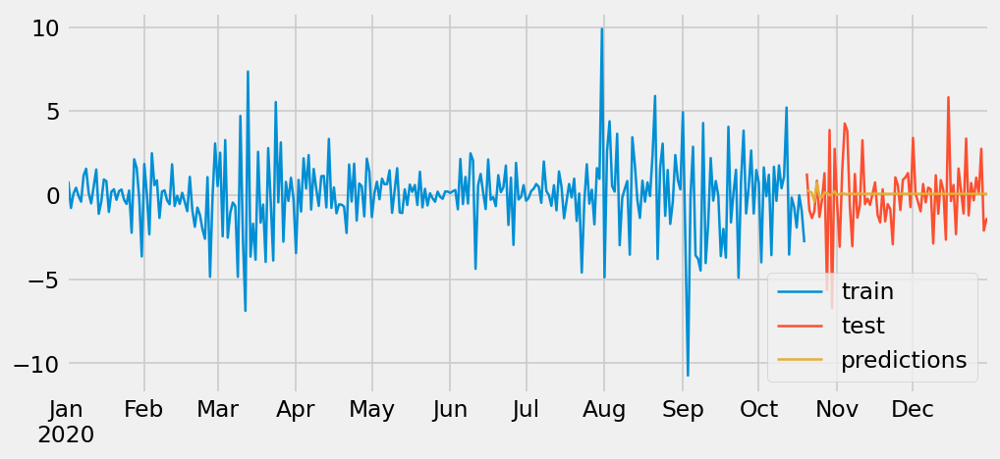

In [148]:
# Plot
# ==============================================================================
fig, ax = plt.subplots(figsize=(9, 4))
data_train['Close'].plot(ax=ax, label='train')
data_test['Close'].plot(ax=ax, label='test')
predictions.plot(ax=ax, label='predictions')
# plt.xlim(0, 6) 
plt.ylim()
ax.legend();

In [149]:
# Test error
# ==============================================================================
error_mse = mean_squared_error(
                y_true = data_test['Close'],
                y_pred = predictions
            )

print(f"Test error (mse): {error_mse}")

Test error (mse): 4.206100340363343


In [150]:
# Hyperparameter Grid search
# ==============================================================================
forecaster = ForecasterAutoreg(
                regressor = SVR(C=1.0, kernel='rbf'),
                lags      = 14 # This value will be replaced in the grid search
             )

# Lags used as predictors
lags_grid = [7, 14, 21]

# Regressor's hyperparameters
param_grid = {'max_iter': [1, 100, 150],
              'kernel': ['rbf']}

results_grid = grid_search_forecaster(
                        forecaster         = forecaster,
                        y                  = data_train['Close'],
                        param_grid         = param_grid,
                        lags_grid          = lags_grid,
                        steps              = steps,
                        refit              = True,
                        metric             = 'mean_squared_error',
                        initial_train_size = int(len(data_train)*0.25),
                        fixed_train_size   = False,
                        return_best        = True,
                        verbose            = False
               )

Number of models compared: 9.


lags grid:   0%|          | 0/3 [00:00<?, ?it/s]

params grid:   0%|          | 0/3 [00:00<?, ?it/s]

`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21] 
  Parameters: {'kernel': 'rbf', 'max_iter': 1}
  Backtesting metric: 4.746912599454978



In [151]:
results_grid.head()

,lags,lags_label,params,mean_squared_error,kernel,max_iter
6,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'kernel': 'rbf', 'max_iter': 1}",4.746913,rbf,1
3,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'kernel': 'rbf', 'max_iter': 1}",4.752331,rbf,1
0,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'kernel': 'rbf', 'max_iter': 1}",4.818467,rbf,1
7,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'kernel': 'rbf', 'max_iter': 100}",4.846310,rbf,100
8,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'kernel': 'rbf', 'max_iter': 150}",4.846824,rbf,150


In [152]:
# Test error
# ==============================================================================
error_mse = mean_squared_error(
                y_true = data_test['Close'],
                y_pred = predictions
            )

print(f"Test error (mse): {error_mse}")

Test error (mse): 4.206100340363343


Information of backtesting process
----------------------------------
Number of observations used for initial training: 72
Number of observations used for backtesting: 294
    Number of folds: 5
    Number skipped folds: 0 
    Number of steps per fold: 73
    Number of steps to exclude from the end of each train set before test (gap): 0
    Last fold only includes 2 observations.

Fold: 0
    Training:   2020-01-01 00:00:00 -- 2020-03-12 00:00:00  (n=72)
    Validation: 2020-03-13 00:00:00 -- 2020-05-24 00:00:00  (n=73)
Fold: 1
    Training:   2020-01-01 00:00:00 -- 2020-05-24 00:00:00  (n=145)
    Validation: 2020-05-25 00:00:00 -- 2020-08-05 00:00:00  (n=73)
Fold: 2
    Training:   2020-01-01 00:00:00 -- 2020-08-05 00:00:00  (n=218)
    Validation: 2020-08-06 00:00:00 -- 2020-10-17 00:00:00  (n=73)
Fold: 3
    Training:   2020-01-01 00:00:00 -- 2020-10-17 00:00:00  (n=291)
    Validation: 2020-10-18 00:00:00 -- 2020-12-29 00:00:00  (n=73)
Fold: 4
    Training:   2020-01-01 00:00:00 

  0%|          | 0/5 [00:00<?, ?it/s]

Test error (mse): 4.206100340363343


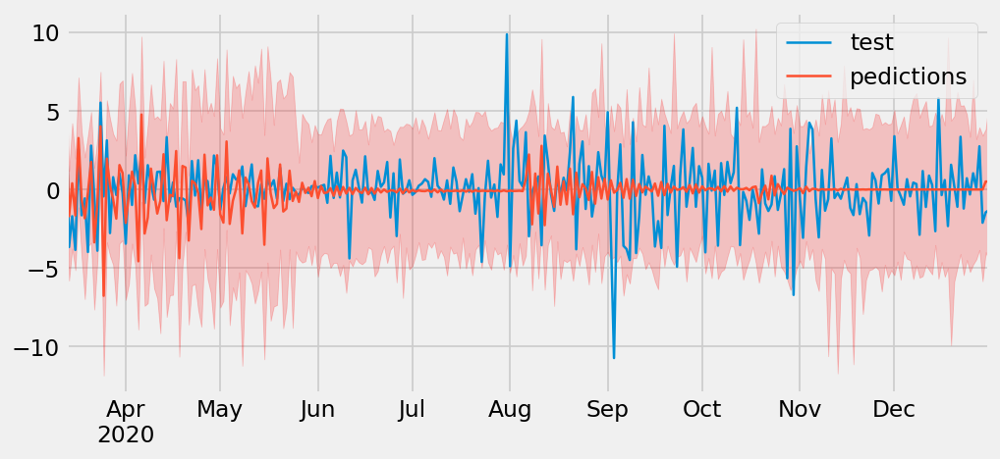

In [153]:
# Backtest with prediction intervals
# ==============================================================================
n_backtesting = 42*7 # The last 9 years are separated for backtesting
forecaster = ForecasterAutoreg(
                regressor = LinearRegression(),
                lags      = 15
             )

metric, predictions = backtesting_forecaster(
                            forecaster         = forecaster,
                            y                  = AAPL_detrended_stationary['Close'],
                            initial_train_size = len(AAPL_detrended_stationary) - n_backtesting,
                            fixed_train_size   = False,
                            steps              = steps,
                            metric             = 'mean_squared_error',
                            refit              = True,
                            interval           = [1, 99],
                            n_boot             = 100,
                            verbose            = True
                      )

print(f"Test error (mse): {error_mse}")

# Plot
# ==============================================================================
fig, ax = plt.subplots(figsize=(9, 4))
AAPL_detrended_stationary.loc[predictions.index, 'Close'].plot(ax=ax, label='test')
predictions['pred'].plot(ax=ax, label='pedictions')
ax.fill_between(
    predictions.index,
    predictions['lower_bound'],
    predictions['upper_bound'],
    color = 'red',
    alpha = 0.2
)
ax.legend();

In [154]:
# Predicted interval coverage
# ==============================================================================
inside_interval = np.where(
                     (AAPL_detrended_stationary.loc[predictions.index, 'Close'] >= predictions['lower_bound']) & \
                     (AAPL_detrended_stationary.loc[predictions.index, 'Close'] <= predictions['upper_bound']),
                     True,
                     False
                   )

coverage = inside_interval.mean()
print(f"Predicted interval coverage: {round(100*coverage, 2)} %")

Predicted interval coverage: 93.88 %


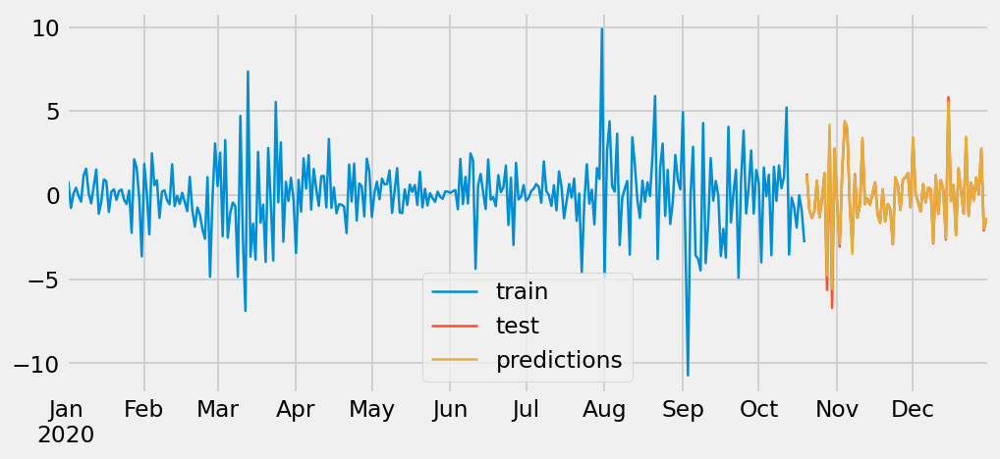

In [155]:
data_train_1 = AAPL_detrended_stationary[:-steps]
data_test_1  = AAPL_detrended_stationary[-steps:]

regressor = RandomForestRegressor(random_state=123)
forecaster = ForecasterAutoreg(
                regressor = regressor,
                lags      = 8
             )

forecaster.fit(y=data_train_1['Close'], exog=data_train_1[exog])

predictions = forecaster.predict(steps=steps, exog=data_test_1[exog])
fig, ax=plt.subplots(figsize=(9, 4))
data_train_1['Close'].plot(ax=ax, label='train')
data_test_1['Close'].plot(ax=ax, label='test')
predictions.plot(ax=ax, label='predictions')
ax.legend();

In [156]:
predictions.head(10)

2020-10-20    1.236371
2020-10-21   -0.888119
2020-10-22   -1.339598
2020-10-23   -0.941992
2020-10-24    0.858104
2020-10-25   -1.322727
2020-10-26   -0.273071
2020-10-27    1.290013
2020-10-28   -4.784754
2020-10-29    4.186159
Freq: D, Name: pred, dtype: float64

In [157]:
data_test_1['Close'].head(10)

2020-10-20    1.289564
2020-10-21   -0.881146
2020-10-22   -1.361856
2020-10-23   -0.952566
2020-10-24    0.853390
2020-10-25   -1.295653
2020-10-26   -0.279697
2020-10-27    1.304593
2020-10-28   -5.646117
2020-10-29    3.873173
Freq: D, Name: Close, dtype: float64

In [158]:
# Test error
# ==============================================================================
error_mse = mean_squared_error(
                y_true = data_test_1['Close'],
                y_pred = predictions
            )

print(f"Test error (mse): {error_mse}")

Test error (mse): 0.03551762165225299


In [159]:
# Save model and custom function
# ==============================================================================
save_forecaster(forecaster, file_name='forecaster_001.joblib', verbose=False)

In [160]:
# Hyperparameter Grid search
# ==============================================================================
forecaster = ForecasterAutoreg(
                regressor = RandomForestRegressor(random_state=123),
                lags      = 14 # This value will be replaced in the grid search
             )

# Lags used as predictors
lags_grid = [7, 14, 21]

# Regressor's hyperparameters
param_grid = {'n_estimators': [1, 100, 150],
              'max_depth': [1, 2, 3]}

results_grid = grid_search_forecaster(
                        forecaster  = forecaster,
                        y           = data_train['Close'],
                        exog        = data_train[exog],
                        param_grid  = param_grid,
                        lags_grid   = lags_grid,
                        steps       = steps,
                        refit       = True,
                        metric      = 'mean_squared_error',
                        initial_train_size = int(len(data_train)*0.5),
                        return_best = True,
                        verbose     = False
               )

Number of models compared: 27.


lags grid:   0%|          | 0/3 [00:00<?, ?it/s]

params grid:   0%|          | 0/9 [00:00<?, ?it/s]

`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5 6 7] 
  Parameters: {'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.6203620997243098



In [161]:
results_grid.head()

,lags,lags_label,params,mean_squared_error,max_depth,n_estimators
7,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 3, 'n_estimators': 100}",0.620362,3,100
8,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 3, 'n_estimators': 150}",0.631013,3,150
16,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 3, 'n_estimators': 100}",0.713838,3,100
17,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 3, 'n_estimators': 150}",0.715949,3,150
15,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 3, 'n_estimators': 1}",0.775510,3,1


In [162]:
train = AAPL_detrended_stationary[AAPL_detrended_stationary.index < pd.to_datetime("2020-11-01", format='%Y-%m-%d')]
test = AAPL_detrended_stationary[AAPL_detrended_stationary.index >= pd.to_datetime("2020-11-01", format='%Y-%m-%d')]

In [163]:
y = train['Close']

ARMAmodel = SARIMAX(y, order = (1, 0, 1))
ARMAmodel = ARMAmodel.fit()

y_pred = ARMAmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = ARMAmodel.predict(start = y_pred_df.index[0], 
                                             end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outARMA = y_pred_df["Predictions"] 

arma_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))


ARIMAmodel = SARIMAX(y, order = (1, 1, 50))

ARIMAmodel = ARIMAmodel.fit()

y_pred = ARIMAmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = ARIMAmodel.predict(start = y_pred_df.index[0],
                                              end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outARIMA = y_pred_df["Predictions"]
arima_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))



In [164]:
exog_train = train.iloc[:, :-1].values
exog_test = test.iloc[:, :-1]

In [165]:
SARIMAXmodel = SARIMAX(y, order = (2,1,1), seasonal_order=(2,2,2,12))
SARIMAXmodel = SARIMAXmodel.fit()

y_pred = SARIMAXmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = SARIMAXmodel.predict(start = y_pred_df.index[0],
                                                end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outSARIMA = y_pred_df["Predictions"] 

sarma_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))


SARIMAXmodel = SARIMAX(y, exog = exog_train, order = (2,1,1), seasonal_order=(2,2,2,12))
SARIMAXmodel = SARIMAXmodel.fit()

y_pred = SARIMAXmodel.get_forecast(len(test.index),exog=exog_test)
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = SARIMAXmodel.predict(start = y_pred_df.index[0],
                                                end = y_pred_df.index[-1],
                                                exog=exog_test)
y_pred_df.index = test.index
y_pred_outSARIMAX = y_pred_df["Predictions"] 

sarmax_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))

print("ARMA RMSE: ",arma_rmse)

print("ARIMA RMSE: ",arima_rmse)

print("SARIMA RMSE: ",sarma_rmse)

print("SARIMAX RMSE: ",sarmax_rmse)

ARMA RMSE:  1.8050460582469177
ARIMA RMSE:  2.057951686762493
SARIMA RMSE:  2.2544967526936177
SARIMAX RMSE:  0.03907112992686987


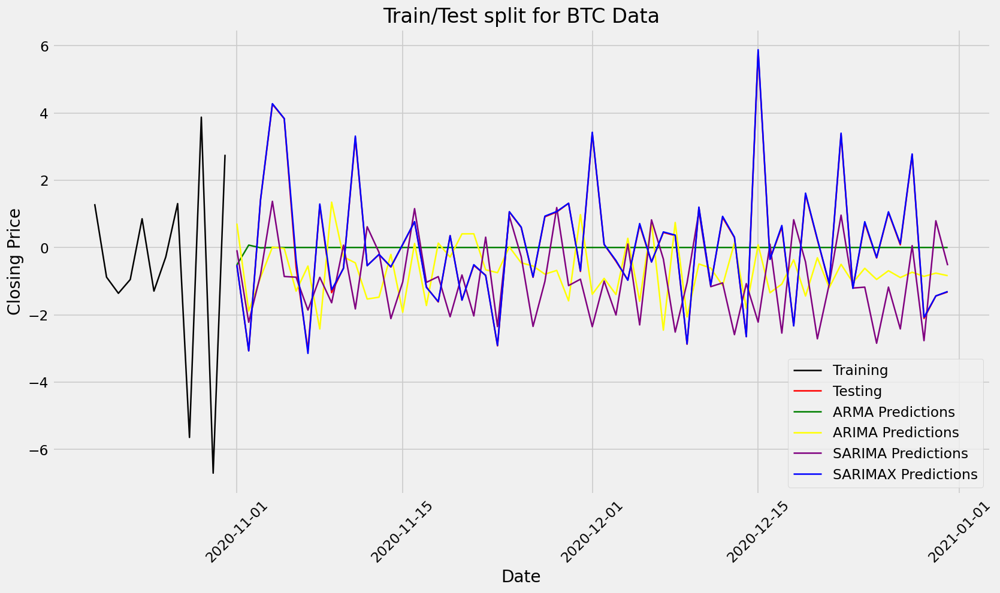

In [166]:
plt.figure(figsize=(15, 8)) 
start_date = '2020-10-20' 
filtered_data = train.loc[start_date:]

plt.plot(filtered_data['Close'], color = "black", label = 'Training')
plt.plot(test['Close'], color = "red", label = 'Testing')
plt.ylabel('Closing Price')
plt.xlabel('Date')
plt.xticks(rotation=45)
plt.title("Train/Test split for BTC Data")
plt.plot(y_pred_outARMA, color='green', label = 'ARMA Predictions')
plt.plot(y_pred_outARIMA, color='Yellow', label = 'ARIMA Predictions')
plt.plot(y_pred_outSARIMA, color='purple', label = 'SARIMA Predictions')
plt.plot(y_pred_outSARIMAX, color='Blue', label = 'SARIMAX Predictions')
plt.legend()
plt.show()

In [167]:
test['Close'].head(10)

2020-11-01   -0.523958
2020-11-02   -3.069668
2020-11-03    1.419622
2020-11-04    4.258912
2020-11-05    3.828201
2020-11-06   -0.592509
2020-11-07   -3.043219
2020-11-08    1.254404
2020-11-09   -1.342973
2020-11-10   -0.605350
Freq: D, Name: Close, dtype: float64

In [168]:
y_pred_outSARIMAX.head(10)

2020-11-01   -0.518588
2020-11-02   -3.073759
2020-11-03    1.426359
2020-11-04    4.274839
2020-11-05    3.832239
2020-11-06   -0.373828
2020-11-07   -3.148423
2020-11-08    1.292563
2020-11-09   -1.258012
2020-11-10   -0.622632
Freq: D, Name: Predictions, dtype: float64

## 2. AMZN

In [170]:
steps = 73 #Up to Nov 1st

data_train = AMZN_detrended_stationary[:-steps]
data_test = AMZN_detrended_stationary[-steps:]

In [171]:
# Create and train forecaster
# ==============================================================================
forecaster = ForecasterAutoreg(
                regressor = RandomForestRegressor(max_depth=1, n_estimators=100, random_state=123),
                lags = 14
                )

forecaster.fit(y=data_train['Close'])
forecaster

ForecasterAutoreg 
Regressor: RandomForestRegressor(max_depth=1, random_state=123) 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14] 
Transformer for y: None 
Transformer for exog: None 
Window size: 14 
Weight function included: False 
Differentiation order: None 
Exogenous included: False 
Exogenous variables names: None 
Training range: [Timestamp('2019-12-31 00:00:00'), Timestamp('2020-10-19 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: D 
Regressor parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': 1, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 123, 'verbose': 0, 'warm_start': False} 
fit_kwargs: {} 
Creation date: 2024-11-07 16:18:54 
Last fit date: 2024-11-07 16:18:55 
Skforecast vers

In [172]:
# Predictions
# ==============================================================================
predictions = forecaster.predict(steps=steps)
predictions.head(5)

2020-10-20   -3.35499
2020-10-21   -3.35499
2020-10-22   -3.35499
2020-10-23   -3.35499
2020-10-24   -3.35499
Freq: D, Name: pred, dtype: float64

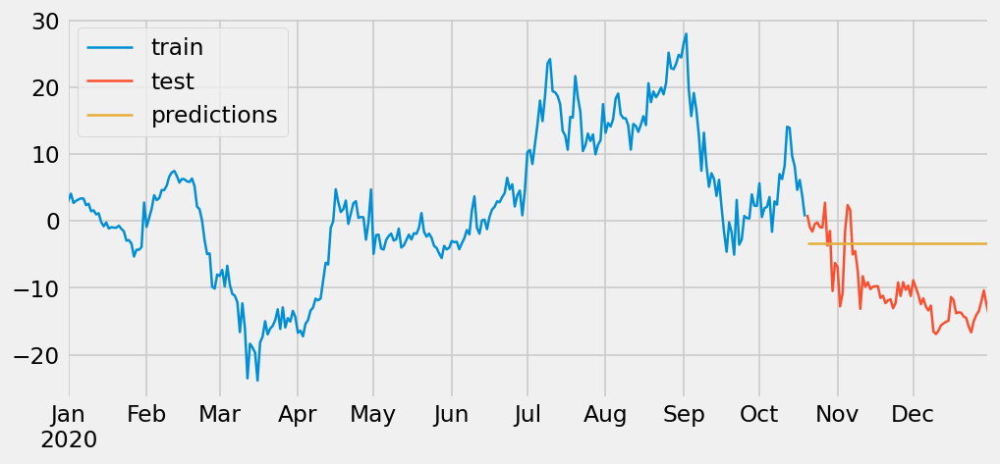

In [173]:
# Plot
# ==============================================================================
fig, ax = plt.subplots(figsize=(9, 4))
data_train['Close'].plot(ax=ax, label='train')
data_test['Close'].plot(ax=ax, label='test')
predictions.plot(ax=ax, label='predictions')
# plt.xlim(0, 6) 
plt.ylim()
ax.legend();

In [174]:
# Test error
# ==============================================================================
error_mse = mean_squared_error(
                y_true = data_test['Close'],
                y_pred = predictions
            )

print(f"Test error (mse): {error_mse}")

Test error (mse): 67.58964519785319


In [175]:
# Hyperparameter Grid search
# ==============================================================================
forecaster = ForecasterAutoreg(
                regressor = RandomForestRegressor(random_state=123),
                lags      = 14 # This value will be replaced in the grid search
             )

# Lags used as predictors
lags_grid = [7, 14, 21]

# Regressor's hyperparameters
param_grid = {'n_estimators': [1, 100, 150],
              'max_depth': [1, 2, 3]}

results_grid = grid_search_forecaster(
                        forecaster         = forecaster,
                        y                  = data_train['Close'],
                        param_grid         = param_grid,
                        lags_grid          = lags_grid,
                        steps              = steps,
                        refit              = True,
                        metric             = 'mean_squared_error',
                        initial_train_size = int(len(data_train)*0.25),
                        fixed_train_size   = False,
                        return_best        = True,
                        verbose            = False
               )

Number of models compared: 27.


lags grid:   0%|          | 0/3 [00:00<?, ?it/s]

params grid:   0%|          | 0/9 [00:00<?, ?it/s]

`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14] 
  Parameters: {'max_depth': 1, 'n_estimators': 100}
  Backtesting metric: 89.49849885608566



In [176]:
results_grid.head()

,lags,lags_label,params,mean_squared_error,max_depth,n_estimators
10,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 1, 'n_estimators': 100}",89.498499,1,100
11,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 1, 'n_estimators': 150}",89.549345,1,150
0,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 1, 'n_estimators': 1}",89.826365,1,1
2,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 1, 'n_estimators': 150}",91.126088,1,150
1,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 1, 'n_estimators': 100}",91.217955,1,100


Information of backtesting process
----------------------------------
Number of observations used for initial training: 73
Number of observations used for backtesting: 294
    Number of folds: 5
    Number skipped folds: 0 
    Number of steps per fold: 73
    Number of steps to exclude from the end of each train set before test (gap): 0
    Last fold only includes 2 observations.

Fold: 0
    Training:   2019-12-31 00:00:00 -- 2020-03-12 00:00:00  (n=73)
    Validation: 2020-03-13 00:00:00 -- 2020-05-24 00:00:00  (n=73)
Fold: 1
    Training:   2019-12-31 00:00:00 -- 2020-05-24 00:00:00  (n=146)
    Validation: 2020-05-25 00:00:00 -- 2020-08-05 00:00:00  (n=73)
Fold: 2
    Training:   2019-12-31 00:00:00 -- 2020-08-05 00:00:00  (n=219)
    Validation: 2020-08-06 00:00:00 -- 2020-10-17 00:00:00  (n=73)
Fold: 3
    Training:   2019-12-31 00:00:00 -- 2020-10-17 00:00:00  (n=292)
    Validation: 2020-10-18 00:00:00 -- 2020-12-29 00:00:00  (n=73)
Fold: 4
    Training:   2019-12-31 00:00:00 

  0%|          | 0/5 [00:00<?, ?it/s]

Test error (mse): 67.58964519785319


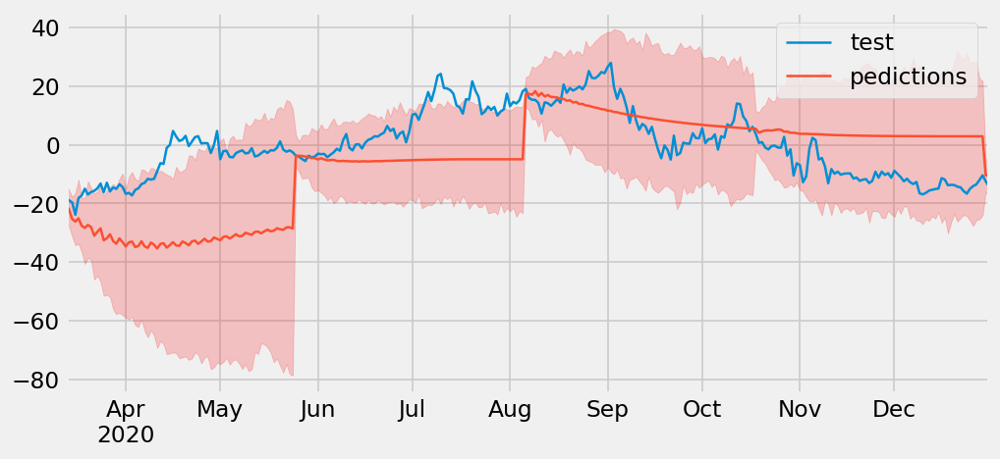

In [177]:
# Backtest with prediction intervals
# ==============================================================================
n_backtesting = 42*7 # The last 9 years are separated for backtesting
forecaster = ForecasterAutoreg(
                regressor = LinearRegression(),
                lags      = 15
             )

metric, predictions = backtesting_forecaster(
                            forecaster         = forecaster,
                            y                  = AMZN_detrended_stationary['Close'],
                            initial_train_size = len(AMZN_detrended_stationary) - n_backtesting,
                            fixed_train_size   = False,
                            steps              = steps,
                            metric             = 'mean_squared_error',
                            refit              = True,
                            interval           = [1, 99],
                            n_boot             = 100,
                            verbose            = True
                      )

print(f"Test error (mse): {error_mse}")

# Plot
# ==============================================================================
fig, ax = plt.subplots(figsize=(9, 4))
AMZN_detrended_stationary.loc[predictions.index, 'Close'].plot(ax=ax, label='test')
predictions['pred'].plot(ax=ax, label='pedictions')
ax.fill_between(
    predictions.index,
    predictions['lower_bound'],
    predictions['upper_bound'],
    color = 'red',
    alpha = 0.2
)
ax.legend();

In [178]:
# Predicted interval coverage
# ==============================================================================
inside_interval = np.where(
                     (AMZN_detrended_stationary.loc[predictions.index, 'Close'] >= predictions['lower_bound']) & \
                     (AMZN_detrended_stationary.loc[predictions.index, 'Close'] <= predictions['upper_bound']),
                     True,
                     False
                   )

coverage = inside_interval.mean()
print(f"Predicted interval coverage: {round(100*coverage, 2)} %")

Predicted interval coverage: 82.65 %


<Axes: >

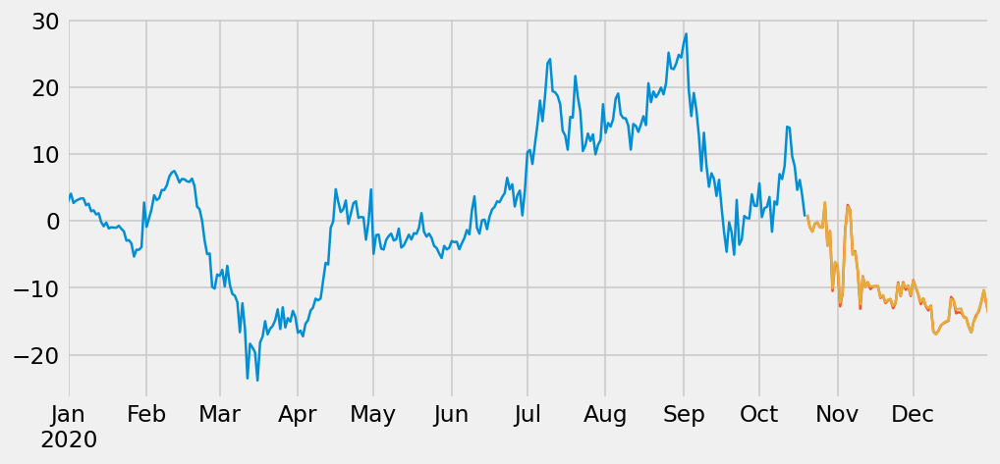

In [179]:
data_train_1 = AMZN_detrended_stationary[:-steps]
data_test_1  = AMZN_detrended_stationary[-steps:]

regressor = RandomForestRegressor(random_state=123)
forecaster = ForecasterAutoreg(
                regressor = regressor,
                lags      = 7
             )

forecaster.fit(y=data_train_1['Close'], exog=data_train_1[exog])

predictions = forecaster.predict(steps=steps, exog=data_test_1[exog])
fig, ax=plt.subplots(figsize=(9, 4))
data_train_1['Close'].plot(ax=ax, label='train')
data_test_1['Close'].plot(ax=ax, label='test')
predictions.plot(ax=ax, label='predictions')

In [180]:
predictions.head(10)

2020-10-20    0.960105
2020-10-21   -0.868399
2020-10-22   -1.625954
2020-10-23   -0.376367
2020-10-24   -0.222481
2020-10-25   -0.913310
2020-10-26   -1.000232
2020-10-27    2.764813
2020-10-28   -3.678925
2020-10-29   -1.590014
Freq: D, Name: pred, dtype: float64

In [181]:
data_test_1['Close'].head(10)

2020-10-20    0.924283
2020-10-21   -0.915405
2020-10-22   -1.579092
2020-10-23   -0.415779
2020-10-24   -0.238300
2020-10-25   -0.926821
2020-10-26   -0.993841
2020-10-27    2.733471
2020-10-28   -3.680216
2020-10-29   -1.504903
Freq: D, Name: Close, dtype: float64

In [182]:
# Test error
# ==============================================================================
error_mse = mean_squared_error(
                y_true = data_test_1['Close'],
                y_pred = predictions
            )

print(f"Test error (mse): {error_mse}")

Test error (mse): 0.04760282654590799


In [183]:
# Hyperparameter Grid search
# ==============================================================================
forecaster = ForecasterAutoreg(
                regressor = RandomForestRegressor(random_state=123),
                lags      = 14 # This value will be replaced in the grid search
             )

# Lags used as predictors
lags_grid = [7, 14, 21]

# Regressor's hyperparameters
param_grid = {'n_estimators': [1, 100, 150],
              'max_depth': [1, 2, 3]}

results_grid = grid_search_forecaster(
                        forecaster  = forecaster,
                        y           = data_train['Close'],
                        exog        = data_train[exog],
                        param_grid  = param_grid,
                        lags_grid   = lags_grid,
                        steps       = steps,
                        refit       = True,
                        metric      = 'mean_squared_error',
                        initial_train_size = int(len(data_train)*0.5),
                        return_best = True,
                        verbose     = False
               )

Number of models compared: 27.


lags grid:   0%|          | 0/3 [00:00<?, ?it/s]

params grid:   0%|          | 0/9 [00:00<?, ?it/s]

`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5 6 7] 
  Parameters: {'max_depth': 3, 'n_estimators': 1}
  Backtesting metric: 26.279315398000925



In [184]:
results_grid.head()

,lags,lags_label,params,mean_squared_error,max_depth,n_estimators
6,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 3, 'n_estimators': 1}",26.279315,3,1
25,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 3, 'n_estimators': 100}",26.333804,3,100
16,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 3, 'n_estimators': 100}",26.364837,3,100
26,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 3, 'n_estimators': 150}",26.496521,3,150
17,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 3, 'n_estimators': 150}",26.514022,3,150


In [185]:
train = AMZN_detrended_stationary[AMZN_detrended_stationary.index < pd.to_datetime("2020-11-01", format='%Y-%m-%d')]
test = AMZN_detrended_stationary[AMZN_detrended_stationary.index >= pd.to_datetime("2020-11-01", format='%Y-%m-%d')]

In [186]:
y = train['Close']

ARMAmodel = SARIMAX(y, order = (1, 0, 1))
ARMAmodel = ARMAmodel.fit()

y_pred = ARMAmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = ARMAmodel.predict(start = y_pred_df.index[0], 
                                             end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outARMA = y_pred_df["Predictions"] 

arma_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))


ARIMAmodel = SARIMAX(y, order = (1, 1, 50))
# ARIMAmodel = SARIMAX(y, order = (2, 3, 2))
# ARIMAmodel = SARIMAX(y, order = (5, 4, 2))
ARIMAmodel = ARIMAmodel.fit()

y_pred = ARIMAmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = ARIMAmodel.predict(start = y_pred_df.index[0],
                                              end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outARIMA = y_pred_df["Predictions"]
arima_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))


In [187]:
exog_train = train.iloc[:, :-1].values
exog_test = test.iloc[:, :-1]

In [188]:
SARIMAXmodel = SARIMAX(y, order = (2,1,1), seasonal_order=(2,2,2,12))
SARIMAXmodel = SARIMAXmodel.fit()

y_pred = SARIMAXmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = SARIMAXmodel.predict(start = y_pred_df.index[0],
                                                end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outSARIMA = y_pred_df["Predictions"] 

sarma_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))


SARIMAXmodel = SARIMAX(y, exog = exog_train, order = (2,1,1), seasonal_order=(2,2,2,12))
SARIMAXmodel = SARIMAXmodel.fit()

y_pred = SARIMAXmodel.get_forecast(len(test.index),exog=exog_test)
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = SARIMAXmodel.predict(start = y_pred_df.index[0],
                                                end = y_pred_df.index[-1],
                                                exog=exog_test)
y_pred_df.index = test.index
y_pred_outSARIMAX = y_pred_df["Predictions"] 

sarmax_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))

print("ARMA RMSE: ",arma_rmse)

print("ARIMA RMSE: ",arima_rmse)

print("SARIMA RMSE: ",sarma_rmse)

print("SARIMAX RMSE: ",sarmax_rmse)

ARMA RMSE:  8.877260253832741
ARIMA RMSE:  6.97068641742655
SARIMA RMSE:  3.354714657748763
SARIMAX RMSE:  0.001114760191494515


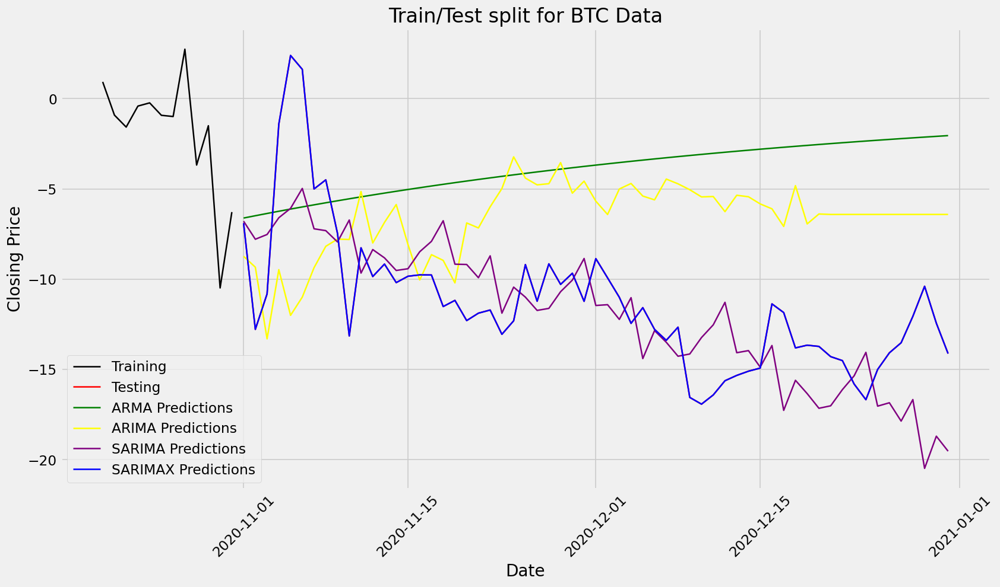

In [189]:
plt.figure(figsize=(15, 8)) 
start_date = '2020-10-20' 
filtered_data = train.loc[start_date:]

plt.plot(filtered_data['Close'], color = "black", label = 'Training')
plt.plot(test['Close'], color = "red", label = 'Testing')
plt.ylabel('Closing Price')
plt.xlabel('Date')
plt.xticks(rotation=45)
plt.title("Train/Test split for BTC Data")
plt.plot(y_pred_outARMA, color='green', label = 'ARMA Predictions')
plt.plot(y_pred_outARIMA, color='Yellow', label = 'ARIMA Predictions')
plt.plot(y_pred_outSARIMA, color='purple', label = 'SARIMA Predictions')
plt.plot(y_pred_outSARIMAX, color='Blue', label = 'SARIMAX Predictions')
plt.legend()
plt.show()

In [190]:
test['Close'].head(10)


2020-11-01    -6.899298
2020-11-02   -12.778652
2020-11-03   -10.818340
2020-11-04    -1.418027
2020-11-05     2.387286
2020-11-06     1.618598
2020-11-07    -5.005256
2020-11-08    -4.500443
2020-11-09    -7.472464
2020-11-10   -13.145151
Freq: D, Name: Close, dtype: float64

In [191]:
y_pred_outSARIMAX.head(10)

2020-11-01    -6.899924
2020-11-02   -12.779345
2020-11-03   -10.816827
2020-11-04    -1.416879
2020-11-05     2.387609
2020-11-06     1.618084
2020-11-07    -5.005264
2020-11-08    -4.502719
2020-11-09    -7.473251
2020-11-10   -13.146306
Freq: D, Name: Predictions, dtype: float64

## 3. BA

In [193]:
steps = 65

data_train = BA_deseasonalised_stationary[:-steps]
data_test  = BA_deseasonalised_stationary[-steps:]

In [194]:
# Create and train forecaster
# ==============================================================================
forecaster = ForecasterAutoreg(
                regressor = RandomForestRegressor(max_depth=1, n_estimators=150, random_state=123),
                lags = 7
                )

forecaster.fit(y=data_train['Close'])
forecaster

ForecasterAutoreg 
Regressor: RandomForestRegressor(max_depth=1, n_estimators=150, random_state=123) 
Lags: [1 2 3 4 5 6 7] 
Transformer for y: None 
Transformer for exog: None 
Window size: 7 
Weight function included: False 
Differentiation order: None 
Exogenous included: False 
Exogenous variables names: None 
Training range: [Timestamp('2019-12-31 00:00:00'), Timestamp('2020-10-27 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: D 
Regressor parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': 1, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 150, 'n_jobs': None, 'oob_score': False, 'random_state': 123, 'verbose': 0, 'warm_start': False} 
fit_kwargs: {} 
Creation date: 2024-11-07 16:20:24 
Last fit date: 2024-11-07 16:20:24 
Skforecast version: 0.13.0

In [195]:
# Predictions
# ==============================================================================
predictions = forecaster.predict(steps=steps)
predictions.head(5)

2020-10-28    160.937197
2020-10-29    160.937197
2020-10-30    160.937197
2020-10-31    160.937197
2020-11-01    160.937197
Freq: D, Name: pred, dtype: float64

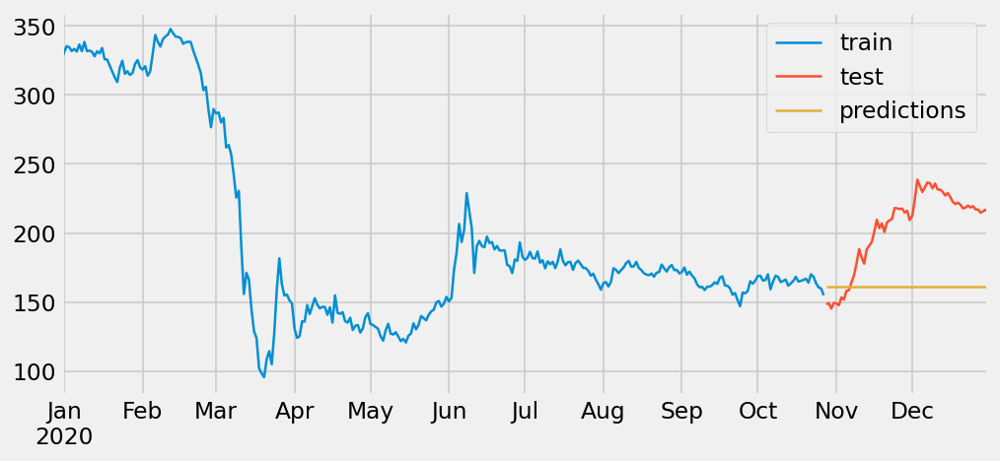

In [196]:
# Plot
# ==============================================================================
fig, ax = plt.subplots(figsize=(9, 4))
data_train['Close'].plot(ax=ax, label='train')
data_test['Close'].plot(ax=ax, label='test')
predictions.plot(ax=ax, label='predictions')
# plt.xlim(0, 6) 
plt.ylim()
ax.legend();

In [197]:
# Test error
# ==============================================================================
error_mse = mean_squared_error(
                y_true = data_test['Close'],
                y_pred = predictions
            )

print(f"Test error (mse): {error_mse}")

Test error (mse): 2629.8640372691325


In [198]:
# Hyperparameter Grid search
# ==============================================================================
forecaster = ForecasterAutoreg(
                regressor = RandomForestRegressor(random_state=123),
                lags      = 14 # This value will be replaced in the grid search
             )

# Lags used as predictors
lags_grid = [7, 14, 21]

# Regressor's hyperparameters
param_grid = {'n_estimators': [1, 100, 150],
              'max_depth': [1, 2, 3]}

results_grid = grid_search_forecaster(
                        forecaster         = forecaster,
                        y                  = data_train['Close'],
                        param_grid         = param_grid,
                        lags_grid          = lags_grid,
                        steps              = steps,
                        refit              = True,
                        metric             = 'mean_squared_error',
                        initial_train_size = int(len(data_train)*0.25),
                        fixed_train_size   = False,
                        return_best        = True,
                        verbose            = False
               )

Number of models compared: 27.


lags grid:   0%|          | 0/3 [00:00<?, ?it/s]

params grid:   0%|          | 0/9 [00:00<?, ?it/s]

`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14] 
  Parameters: {'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 1058.5679346934778



In [199]:
results_grid.head()

,lags,lags_label,params,mean_squared_error,max_depth,n_estimators
16,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 3, 'n_estimators': 100}",1058.567935,3,100
17,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 3, 'n_estimators': 150}",1085.398368,3,150
6,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 3, 'n_estimators': 1}",1133.504840,3,1
8,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 3, 'n_estimators': 150}",1147.145319,3,150
7,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 3, 'n_estimators': 100}",1154.060459,3,100


Information of backtesting process
----------------------------------
Number of observations used for initial training: 73
Number of observations used for backtesting: 294
    Number of folds: 5
    Number skipped folds: 0 
    Number of steps per fold: 65
    Number of steps to exclude from the end of each train set before test (gap): 0
    Last fold only includes 34 observations.

Fold: 0
    Training:   2019-12-31 00:00:00 -- 2020-03-12 00:00:00  (n=73)
    Validation: 2020-03-13 00:00:00 -- 2020-05-16 00:00:00  (n=65)
Fold: 1
    Training:   2019-12-31 00:00:00 -- 2020-05-16 00:00:00  (n=138)
    Validation: 2020-05-17 00:00:00 -- 2020-07-20 00:00:00  (n=65)
Fold: 2
    Training:   2019-12-31 00:00:00 -- 2020-07-20 00:00:00  (n=203)
    Validation: 2020-07-21 00:00:00 -- 2020-09-23 00:00:00  (n=65)
Fold: 3
    Training:   2019-12-31 00:00:00 -- 2020-09-23 00:00:00  (n=268)
    Validation: 2020-09-24 00:00:00 -- 2020-11-27 00:00:00  (n=65)
Fold: 4
    Training:   2019-12-31 00:00:00

  0%|          | 0/5 [00:00<?, ?it/s]

Test error (mse): 2629.8640372691325


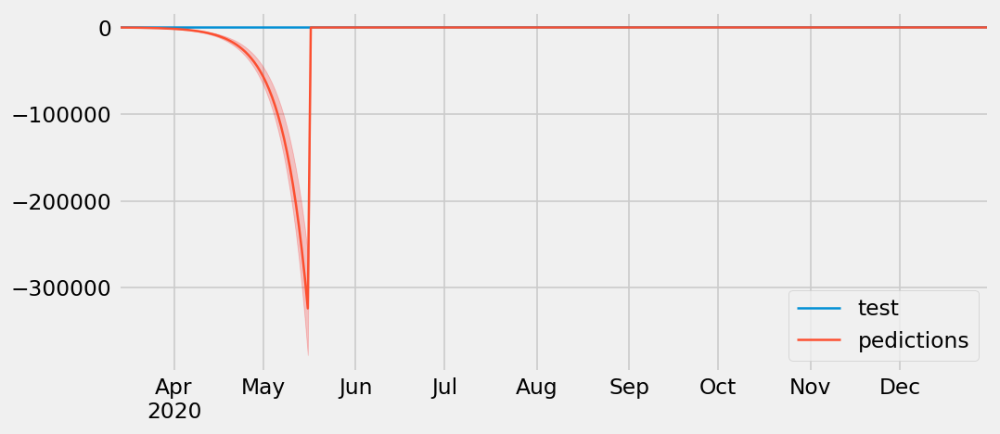

In [200]:
# Backtest with prediction intervals
# ==============================================================================
n_backtesting = 42*7 # The last 9 years are separated for backtesting
forecaster = ForecasterAutoreg(
                regressor = LinearRegression(),
                lags      = 15
             )

metric, predictions = backtesting_forecaster(
                            forecaster         = forecaster,
                            y                  = BA_deseasonalised_stationary['Close'],
                            initial_train_size = len(BA_deseasonalised_stationary) - n_backtesting,
                            fixed_train_size   = False,
                            steps              = steps,
                            metric             = 'mean_squared_error',
                            refit              = True,
                            interval           = [1, 99],
                            n_boot             = 100,
                            verbose            = True
                      )

print(f"Test error (mse): {error_mse}")

# Plot
# ==============================================================================
fig, ax = plt.subplots(figsize=(9, 4))
BA_deseasonalised_stationary.loc[predictions.index, 'Close'].plot(ax=ax, label='test')
predictions['pred'].plot(ax=ax, label='pedictions')
ax.fill_between(
    predictions.index,
    predictions['lower_bound'],
    predictions['upper_bound'],
    color = 'red',
    alpha = 0.2
)
ax.legend();

In [201]:
# Predicted interval coverage
# ==============================================================================
inside_interval = np.where(
                     (BA_deseasonalised_stationary.loc[predictions.index, 'Close'] >= predictions['lower_bound']) & \
                     (BA_deseasonalised_stationary.loc[predictions.index, 'Close'] <= predictions['upper_bound']),
                     True,
                     False
                   )

coverage = inside_interval.mean()
print(f"Predicted interval coverage: {round(100*coverage, 2)} %")

Predicted interval coverage: 77.89 %


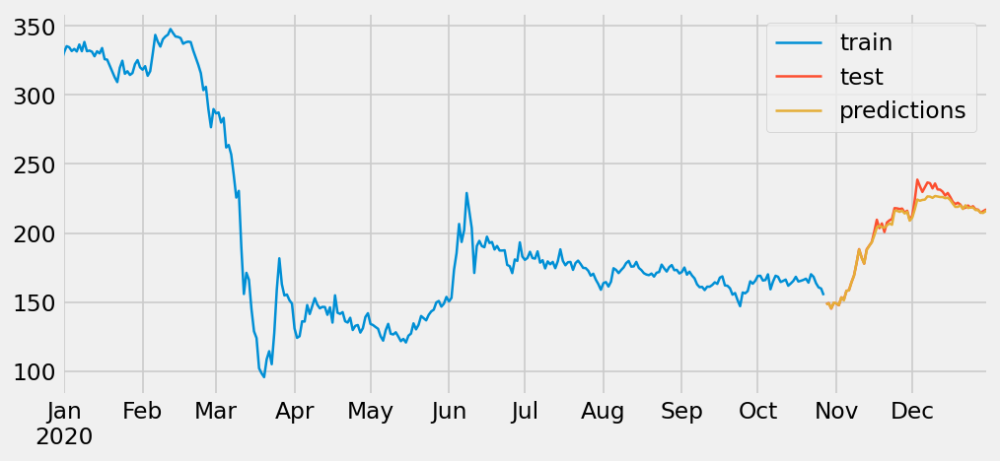

In [202]:
data_train_1 = BA_deseasonalised_stationary[:-steps]
data_test_1  = BA_deseasonalised_stationary[-steps:]

regressor = RandomForestRegressor(random_state=123)
forecaster = ForecasterAutoreg(
                regressor = regressor,
                lags      = 8
             )

forecaster.fit(y=data_train_1['Close'], exog=data_train_1[exog])

predictions = forecaster.predict(steps=steps, exog=data_test_1[exog])
fig, ax=plt.subplots(figsize=(9, 4))
data_train_1['Close'].plot(ax=ax, label='train')
data_test_1['Close'].plot(ax=ax, label='test')
predictions.plot(ax=ax, label='predictions')
ax.legend();

In [203]:
# Test error
# ==============================================================================
error_mse = mean_squared_error(
                y_true = data_test_1['Close'],
                y_pred = predictions
            )

print(f"Test error (mse): {error_mse}")

Test error (mse): 15.821078015826707


In [204]:
predictions.head(10)


2020-10-28    148.326459
2020-10-29    148.948003
2020-10-30    145.468569
2020-10-31    149.517571
2020-11-01    148.994224
2020-11-02    147.774733
2020-11-03    153.312913
2020-11-04    151.203788
2020-11-05    158.077485
2020-11-06    158.425642
Freq: D, Name: pred, dtype: float64

In [205]:
data_test_1['Close'].head(10)

2020-10-28    148.281338
2020-10-29    149.184784
2020-10-30    145.166260
2020-10-31    149.375106
2020-11-01    148.958387
2020-11-02    147.604247
2020-11-03    153.313944
2020-11-04    151.774667
2020-11-05    158.037883
2020-11-06    158.588031
Freq: D, Name: Close, dtype: float64

In [206]:
# Hyperparameter Grid search
# ==============================================================================
forecaster = ForecasterAutoreg(
                regressor = RandomForestRegressor(random_state=123),
                lags      = 14 # This value will be replaced in the grid search
             )

# Lags used as predictors
lags_grid = [7, 14, 21]

# Regressor's hyperparameters
param_grid = {'n_estimators': [1, 100, 150],
              'max_depth': [1, 2, 3]}

results_grid = grid_search_forecaster(
                        forecaster  = forecaster,
                        y           = data_train['Close'],
                        exog        = data_train[exog],
                        param_grid  = param_grid,
                        lags_grid   = lags_grid,
                        steps       = steps,
                        refit       = True,
                        metric      = 'mean_squared_error',
                        initial_train_size = int(len(data_train)*0.5),
                        return_best = True,
                        verbose     = False
               )

Number of models compared: 27.


lags grid:   0%|          | 0/3 [00:00<?, ?it/s]

params grid:   0%|          | 0/9 [00:00<?, ?it/s]

`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5 6 7] 
  Parameters: {'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 67.2252345591831



In [207]:
train = BA_deseasonalised_stationary[BA_deseasonalised_stationary.index < pd.to_datetime("2020-11-01", format='%Y-%m-%d')]
test = BA_deseasonalised_stationary[BA_deseasonalised_stationary.index >= pd.to_datetime("2020-11-01", format='%Y-%m-%d')]

In [208]:
y = train['Close']

ARMAmodel = SARIMAX(y, order = (1, 0, 1))
ARMAmodel = ARMAmodel.fit()

y_pred = ARMAmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = ARMAmodel.predict(start = y_pred_df.index[0], 
                                             end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outARMA = y_pred_df["Predictions"] 

arma_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))


ARIMAmodel = SARIMAX(y, order = (1, 1, 50))
# ARIMAmodel = SARIMAX(y, order = (2, 3, 2))
# ARIMAmodel = SARIMAX(y, order = (5, 4, 2))
ARIMAmodel = ARIMAmodel.fit()

y_pred = ARIMAmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = ARIMAmodel.predict(start = y_pred_df.index[0],
                                              end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outARIMA = y_pred_df["Predictions"]
arima_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))



In [209]:
exog_train = train.iloc[:, :-1].values
exog_test = test.iloc[:, :-1]

In [210]:
SARIMAXmodel = SARIMAX(y, order = (2,1,1), seasonal_order=(2,2,2,12))
SARIMAXmodel = SARIMAXmodel.fit()

y_pred = SARIMAXmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = SARIMAXmodel.predict(start = y_pred_df.index[0],
                                                end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outSARIMA = y_pred_df["Predictions"] 

sarma_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))


SARIMAXmodel = SARIMAX(y, exog = exog_train, order = (2,1,1), seasonal_order=(2,2,2,12))
SARIMAXmodel = SARIMAXmodel.fit()

y_pred = SARIMAXmodel.get_forecast(len(test.index),exog=exog_test)
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = SARIMAXmodel.predict(start = y_pred_df.index[0],
                                                end = y_pred_df.index[-1],
                                                exog=exog_test)
y_pred_df.index = test.index
y_pred_outSARIMAX = y_pred_df["Predictions"] 

sarmax_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))

print("ARMA RMSE: ",arma_rmse)

print("ARIMA RMSE: ",arima_rmse)

print("SARIMA RMSE: ",sarma_rmse)

print("SARIMAX RMSE: ",sarmax_rmse)

ARMA RMSE:  65.90477265758629
ARIMA RMSE:  65.32131748730403
SARIMA RMSE:  61.537564636728575
SARIMAX RMSE:  0.12709922080154393


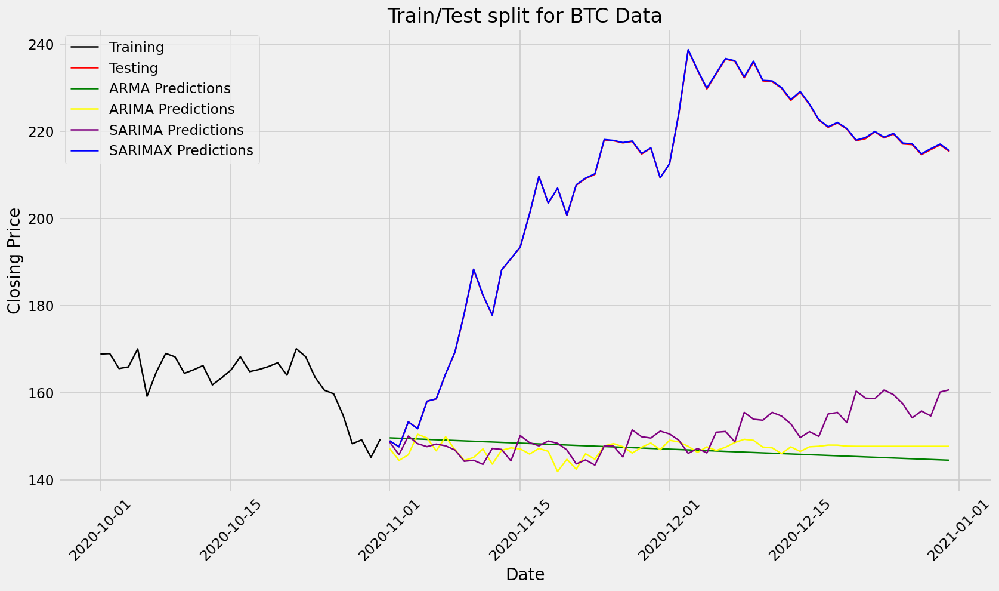

In [211]:
plt.figure(figsize=(15, 8)) 
start_date = '2020-10-01' 
filtered_data = train.loc[start_date:]

plt.plot(filtered_data['Close'], color = "black", label = 'Training')
plt.plot(test['Close'], color = "red", label = 'Testing')
plt.ylabel('Closing Price')
plt.xlabel('Date')
plt.xticks(rotation=45)
plt.title("Train/Test split for BTC Data")
plt.plot(y_pred_outARMA, color='green', label = 'ARMA Predictions')
plt.plot(y_pred_outARIMA, color='Yellow', label = 'ARIMA Predictions')
plt.plot(y_pred_outSARIMA, color='purple', label = 'SARIMA Predictions')
plt.plot(y_pred_outSARIMAX, color='Blue', label = 'SARIMAX Predictions')
plt.legend()
plt.show()

In [212]:
test['Close'].head(10)


2020-11-01    148.958387
2020-11-02    147.604247
2020-11-03    153.313944
2020-11-04    151.774667
2020-11-05    158.037883
2020-11-06    158.588031
2020-11-07    164.315776
2020-11-08    169.263478
2020-11-09    178.158128
2020-11-10    188.277306
Freq: D, Name: Close, dtype: float64

In [213]:
y_pred_outSARIMAX.head(10)

2020-11-01    148.964034
2020-11-02    147.584517
2020-11-03    153.313702
2020-11-04    151.720620
2020-11-05    158.042901
2020-11-06    158.605003
2020-11-07    164.335595
2020-11-08    169.318944
2020-11-09    178.217130
2020-11-10    188.356022
Freq: D, Name: Predictions, dtype: float64

## 4. DIS

In [215]:
steps = 73

data_train = DIS_deseasonalised_stationary[:-steps]
data_test  = DIS_deseasonalised_stationary[-steps:]

In [216]:
# Create and train forecaster
# ==============================================================================
forecaster = ForecasterAutoreg(
                regressor = RandomForestRegressor(max_depth=1, n_estimators=150, random_state=123),
                lags = 7
                )

forecaster.fit(y=data_train['Close'])
forecaster

ForecasterAutoreg 
Regressor: RandomForestRegressor(max_depth=1, n_estimators=150, random_state=123) 
Lags: [1 2 3 4 5 6 7] 
Transformer for y: None 
Transformer for exog: None 
Window size: 7 
Weight function included: False 
Differentiation order: None 
Exogenous included: False 
Exogenous variables names: None 
Training range: [Timestamp('2019-12-31 00:00:00'), Timestamp('2020-10-19 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: D 
Regressor parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': 1, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 150, 'n_jobs': None, 'oob_score': False, 'random_state': 123, 'verbose': 0, 'warm_start': False} 
fit_kwargs: {} 
Creation date: 2024-11-07 16:21:50 
Last fit date: 2024-11-07 16:21:50 
Skforecast version: 0.13.0

In [217]:
# Predictions
# ==============================================================================
predictions = forecaster.predict(steps=steps)
predictions.head(5)

2020-10-20    133.098223
2020-10-21    133.098223
2020-10-22    133.098223
2020-10-23    133.098223
2020-10-24    133.098223
Freq: D, Name: pred, dtype: float64

In [218]:
# Test error
# ==============================================================================
error_mse = mean_squared_error(
                y_true = data_test['Close'],
                y_pred = predictions
            )

print(f"Test error (mse): {error_mse}")

Test error (mse): 597.8607287210062


In [219]:
# Hyperparameter Grid search
# ==============================================================================
forecaster = ForecasterAutoreg(
                regressor = RandomForestRegressor(random_state=123),
                lags      = 14 # This value will be replaced in the grid search
             )

# Lags used as predictors
lags_grid = [7, 14, 21]

# Regressor's hyperparameters
param_grid = {'n_estimators': [1, 100, 150],
              'max_depth': [1, 2, 3]}

results_grid = grid_search_forecaster(
                        forecaster         = forecaster,
                        y                  = data_train['Close'],
                        param_grid         = param_grid,
                        lags_grid          = lags_grid,
                        steps              = steps,
                        refit              = True,
                        metric             = 'mean_squared_error',
                        initial_train_size = int(len(data_train)*0.25),
                        fixed_train_size   = False,
                        return_best        = True,
                        verbose            = False
               )

Number of models compared: 27.


lags grid:   0%|          | 0/3 [00:00<?, ?it/s]

params grid:   0%|          | 0/9 [00:00<?, ?it/s]

`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21] 
  Parameters: {'max_depth': 3, 'n_estimators': 1}
  Backtesting metric: 34.6082392030028



In [220]:
results_grid.head()

,lags,lags_label,params,mean_squared_error,max_depth,n_estimators
24,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 3, 'n_estimators': 1}",34.608239,3,1
6,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 3, 'n_estimators': 1}",58.998114,3,1
21,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 2, 'n_estimators': 1}",59.381203,2,1
16,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 3, 'n_estimators': 100}",63.475911,3,100
17,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 3, 'n_estimators': 150}",64.503183,3,150


In [221]:
# Test error
# ==============================================================================
error_mse = mean_squared_error(
                y_true = data_test['Close'],
                y_pred = predictions
            )

print(f"Test error (mse): {error_mse}")

Test error (mse): 597.8607287210062


Information of backtesting process
----------------------------------
Number of observations used for initial training: 73
Number of observations used for backtesting: 294
    Number of folds: 5
    Number skipped folds: 0 
    Number of steps per fold: 73
    Number of steps to exclude from the end of each train set before test (gap): 0
    Last fold only includes 2 observations.

Fold: 0
    Training:   2019-12-31 00:00:00 -- 2020-03-12 00:00:00  (n=73)
    Validation: 2020-03-13 00:00:00 -- 2020-05-24 00:00:00  (n=73)
Fold: 1
    Training:   2019-12-31 00:00:00 -- 2020-05-24 00:00:00  (n=146)
    Validation: 2020-05-25 00:00:00 -- 2020-08-05 00:00:00  (n=73)
Fold: 2
    Training:   2019-12-31 00:00:00 -- 2020-08-05 00:00:00  (n=219)
    Validation: 2020-08-06 00:00:00 -- 2020-10-17 00:00:00  (n=73)
Fold: 3
    Training:   2019-12-31 00:00:00 -- 2020-10-17 00:00:00  (n=292)
    Validation: 2020-10-18 00:00:00 -- 2020-12-29 00:00:00  (n=73)
Fold: 4
    Training:   2019-12-31 00:00:00 

  0%|          | 0/5 [00:00<?, ?it/s]

Test error (mse): 597.8607287210062


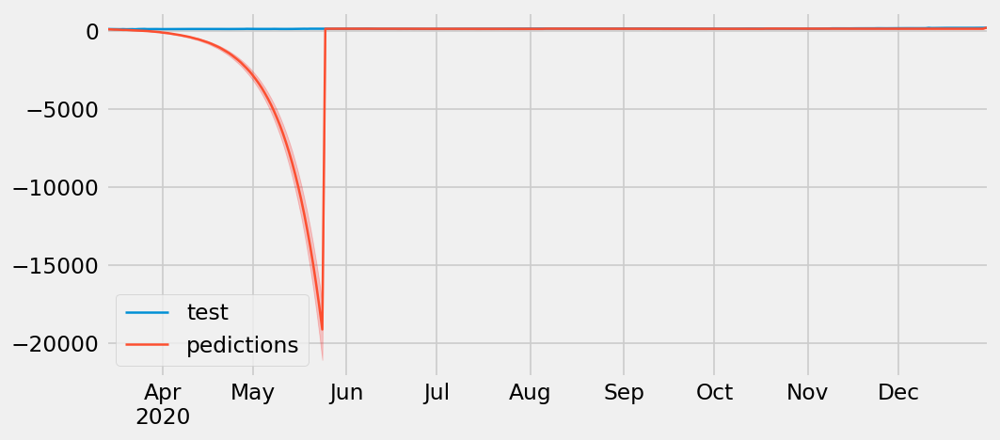

In [222]:
# Backtest with prediction intervals
# ==============================================================================
n_backtesting = 42*7 # The last 9 years are separated for backtesting
forecaster = ForecasterAutoreg(
                regressor = LinearRegression(),
                lags      = 15
             )

metric, predictions = backtesting_forecaster(
                            forecaster         = forecaster,
                            y                  = DIS_deseasonalised_stationary['Close'],
                            initial_train_size = len(DIS_deseasonalised_stationary) - n_backtesting,
                            fixed_train_size   = False,
                            steps              = steps,
                            metric             = 'mean_squared_error',
                            refit              = True,
                            interval           = [1, 99],
                            n_boot             = 100,
                            verbose            = True
                      )

print(f"Test error (mse): {error_mse}")

# Plot
# ==============================================================================
fig, ax = plt.subplots(figsize=(9, 4))
DIS_deseasonalised_stationary.loc[predictions.index, 'Close'].plot(ax=ax, label='test')
predictions['pred'].plot(ax=ax, label='pedictions')
ax.fill_between(
    predictions.index,
    predictions['lower_bound'],
    predictions['upper_bound'],
    color = 'red',
    alpha = 0.2
)
ax.legend();

In [223]:
# Predicted interval coverage
# ==============================================================================
inside_interval = np.where(
                     (DIS_deseasonalised_stationary.loc[predictions.index, 'Close'] >= predictions['lower_bound']) & \
                     (DIS_deseasonalised_stationary.loc[predictions.index, 'Close'] <= predictions['upper_bound']),
                     True,
                     False
                   )

coverage = inside_interval.mean()
print(f"Predicted interval coverage: {round(100*coverage, 2)} %")

Predicted interval coverage: 64.29 %


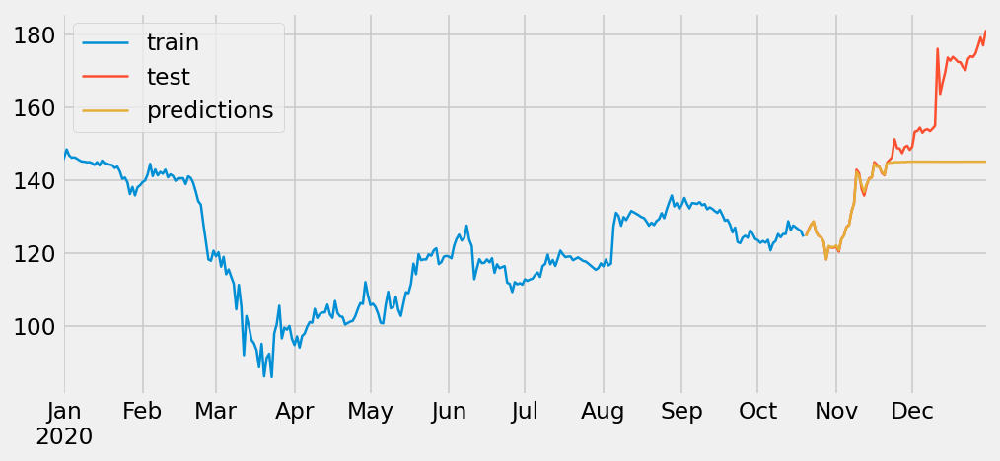

In [224]:
data_train_1 = DIS_deseasonalised_stationary[:-steps]
data_test_1  = DIS_deseasonalised_stationary[-steps:]

regressor = RandomForestRegressor(random_state=123)
forecaster = ForecasterAutoreg(
                regressor = regressor,
                lags      = 8
             )

forecaster.fit(y=data_train_1['Close'], exog=data_train_1[exog])

predictions = forecaster.predict(steps=steps, exog=data_test_1[exog])
fig, ax=plt.subplots(figsize=(9, 4))
data_train_1['Close'].plot(ax=ax, label='train')
data_test_1['Close'].plot(ax=ax, label='test')
predictions.plot(ax=ax, label='predictions')
ax.legend();

In [225]:
# Test error
# ==============================================================================
error_mse = mean_squared_error(
                y_true = data_test_1['Close'],
                y_pred = predictions
            )

print(f"Test error (mse): {error_mse}")

Test error (mse): 251.47396739770022


In [226]:
predictions.head(10)


2020-10-20    124.599915
2020-10-21    126.132302
2020-10-22    127.661692
2020-10-23    128.702538
2020-10-24    125.807948
2020-10-25    124.664842
2020-10-26    124.327865
2020-10-27    123.050364
2020-10-28    118.226822
2020-10-29    121.892900
Freq: D, Name: pred, dtype: float64

In [227]:
data_test_1['Close'].head(10)

2020-10-20    124.704928
2020-10-21    126.350845
2020-10-22    127.738813
2020-10-23    128.558450
2020-10-24    125.792490
2020-10-25    124.679270
2020-10-26    124.271184
2020-10-27    123.068145
2020-10-28    118.208834
2020-10-29    121.710374
Freq: D, Name: Close, dtype: float64

In [228]:
# Hyperparameter Grid search
# ==============================================================================
forecaster = ForecasterAutoreg(
                regressor = RandomForestRegressor(random_state=123),
                lags      = 14 # This value will be replaced in the grid search
             )

# Lags used as predictors
lags_grid = [7, 14, 21]

# Regressor's hyperparameters
param_grid = {'n_estimators': [1, 100, 150],
              'max_depth': [1, 2, 3]}

results_grid = grid_search_forecaster(
                        forecaster  = forecaster,
                        y           = data_train['Close'],
                        exog        = data_train[exog],
                        param_grid  = param_grid,
                        lags_grid   = lags_grid,
                        steps       = steps,
                        refit       = True,
                        metric      = 'mean_squared_error',
                        initial_train_size = int(len(data_train)*0.5),
                        return_best = True,
                        verbose     = False
               )

Number of models compared: 27.


lags grid:   0%|          | 0/3 [00:00<?, ?it/s]

params grid:   0%|          | 0/9 [00:00<?, ?it/s]

`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21] 
  Parameters: {'max_depth': 3, 'n_estimators': 1}
  Backtesting metric: 6.437334635309298



In [229]:
results_grid.head()

,lags,lags_label,params,mean_squared_error,max_depth,n_estimators
24,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 3, 'n_estimators': 1}",6.437335,3,1
7,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 3, 'n_estimators': 100}",10.207131,3,100
8,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 3, 'n_estimators': 150}",10.615367,3,150
17,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 3, 'n_estimators': 150}",10.617561,3,150
6,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 3, 'n_estimators': 1}",11.084598,3,1


In [230]:
train = DIS_deseasonalised_stationary[DIS_deseasonalised_stationary.index < pd.to_datetime("2020-11-01", format='%Y-%m-%d')]
test = DIS_deseasonalised_stationary[DIS_deseasonalised_stationary.index >= pd.to_datetime("2020-11-01", format='%Y-%m-%d')]

In [231]:
y = train['Close']

ARMAmodel = SARIMAX(y, order = (1, 0, 1))
ARMAmodel = ARMAmodel.fit()

y_pred = ARMAmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = ARMAmodel.predict(start = y_pred_df.index[0], 
                                             end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outARMA = y_pred_df["Predictions"] 

arma_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))


ARIMAmodel = SARIMAX(y, order = (1, 1, 50))
# ARIMAmodel = SARIMAX(y, order = (2, 3, 2))
# ARIMAmodel = SARIMAX(y, order = (5, 4, 2))
ARIMAmodel = ARIMAmodel.fit()

y_pred = ARIMAmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = ARIMAmodel.predict(start = y_pred_df.index[0],
                                              end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outARIMA = y_pred_df["Predictions"]
arima_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))



In [232]:
exog_train = train.iloc[:, :-1].values
exog_test = test.iloc[:, :-1]

In [233]:
SARIMAXmodel = SARIMAX(y, order = (2,1,1), seasonal_order=(2,2,2,12))
SARIMAXmodel = SARIMAXmodel.fit()

y_pred = SARIMAXmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = SARIMAXmodel.predict(start = y_pred_df.index[0],
                                                end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outSARIMA = y_pred_df["Predictions"] 

sarma_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))


SARIMAXmodel = SARIMAX(y, exog = exog_train, order = (2,1,1), seasonal_order=(2,2,2,12))
SARIMAXmodel = SARIMAXmodel.fit()

y_pred = SARIMAXmodel.get_forecast(len(test.index),exog=exog_test)
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = SARIMAXmodel.predict(start = y_pred_df.index[0],
                                                end = y_pred_df.index[-1],
                                                exog=exog_test)
y_pred_df.index = test.index
y_pred_outSARIMAX = y_pred_df["Predictions"] 

sarmax_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))

print("ARMA RMSE: ",arma_rmse)

print("ARIMA RMSE: ",arima_rmse)

print("SARIMA RMSE: ",sarma_rmse)

print("SARIMAX RMSE: ",sarmax_rmse)

ARMA RMSE:  36.67280510773711
ARIMA RMSE:  36.63598709044877
SARIMA RMSE:  28.561177732850428
SARIMAX RMSE:  0.0006067643667359392


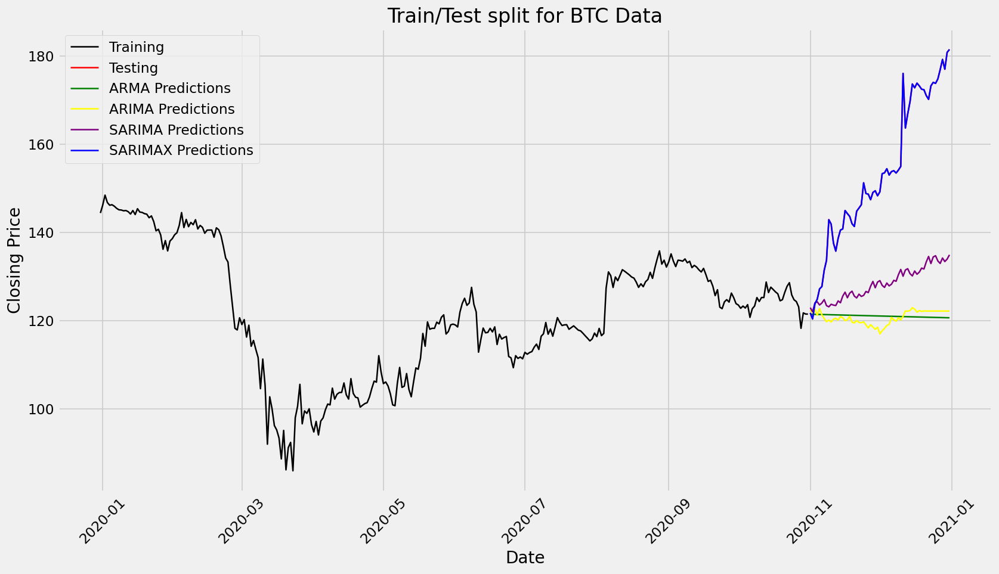

In [234]:
plt.figure(figsize=(15, 8)) 
start_date = '2020-10-20' 
filtered_data = train.loc[start_date:]

plt.plot(train['Close'], color = "black", label = 'Training')
plt.plot(test['Close'], color = "red", label = 'Testing')
plt.ylabel('Closing Price')
plt.xlabel('Date')
plt.xticks(rotation=45)
plt.title("Train/Test split for BTC Data")
plt.plot(y_pred_outARMA, color='green', label = 'ARMA Predictions')
plt.plot(y_pred_outARIMA, color='Yellow', label = 'ARIMA Predictions')
plt.plot(y_pred_outSARIMA, color='purple', label = 'SARIMA Predictions')
plt.plot(y_pred_outSARIMAX, color='Blue', label = 'SARIMAX Predictions')
plt.legend()
plt.show()

In [235]:
test['Close'].head(10)


2020-11-01    121.697150
2020-11-02    120.334494
2020-11-03    123.776753
2020-11-04    124.794284
2020-11-05    127.137972
2020-11-06    127.667005
2020-11-07    131.350049
2020-11-08    133.613968
2020-11-09    142.832727
2020-11-10    141.831272
Freq: D, Name: Close, dtype: float64

In [236]:
y_pred_outSARIMAX.head(10)

2020-11-01    121.697389
2020-11-02    120.334365
2020-11-03    123.776175
2020-11-04    124.794512
2020-11-05    127.138265
2020-11-06    127.666964
2020-11-07    131.350093
2020-11-08    133.614798
2020-11-09    142.833443
2020-11-10    141.831489
Freq: D, Name: Predictions, dtype: float64

## 5. TSLA

In [238]:
steps = 73

data_train = TSLA_detrended_stationary[:-steps]
data_test  = TSLA_detrended_stationary[-steps:]

In [239]:
# Create and train forecaster
# ==============================================================================
forecaster = ForecasterAutoreg(
                regressor = RandomForestRegressor(max_depth=1, n_estimators=150, random_state=123),
                lags = 7
                )

forecaster.fit(y=data_train['Close'])
forecaster

ForecasterAutoreg 
Regressor: RandomForestRegressor(max_depth=1, n_estimators=150, random_state=123) 
Lags: [1 2 3 4 5 6 7] 
Transformer for y: None 
Transformer for exog: None 
Window size: 7 
Weight function included: False 
Differentiation order: None 
Exogenous included: False 
Exogenous variables names: None 
Training range: [Timestamp('2020-01-01 00:00:00'), Timestamp('2020-10-19 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: D 
Regressor parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': 1, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 150, 'n_jobs': None, 'oob_score': False, 'random_state': 123, 'verbose': 0, 'warm_start': False} 
fit_kwargs: {} 
Creation date: 2024-11-07 16:23:14 
Last fit date: 2024-11-07 16:23:14 
Skforecast version: 0.13.0

In [240]:
# Predictions
# ==============================================================================
predictions = forecaster.predict(steps=steps)
predictions.head(5)

2020-10-20   -0.106981
2020-10-21   -0.112970
2020-10-22   -0.120548
2020-10-23   -0.112473
2020-10-24   -0.131110
Freq: D, Name: pred, dtype: float64

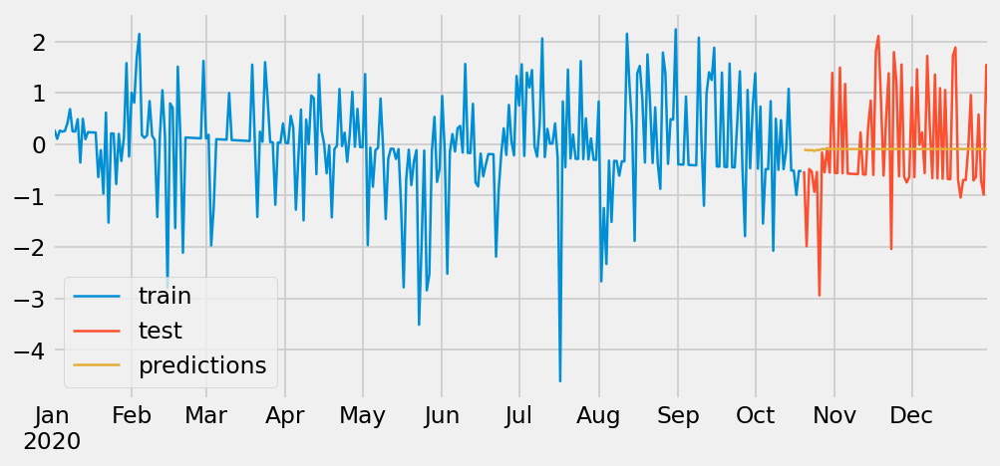

In [241]:
# Plot
# ==============================================================================
fig, ax = plt.subplots(figsize=(9, 4))
data_train['Close'].plot(ax=ax, label='train')
data_test['Close'].plot(ax=ax, label='test')
predictions.plot(ax=ax, label='predictions')
# plt.xlim(0, 6) 
plt.ylim()
ax.legend();

In [242]:
# Test error
# ==============================================================================
error_mse = mean_squared_error(
                y_true = data_test['Close'],
                y_pred = predictions
            )

print(f"Test error (mse): {error_mse}")

Test error (mse): 1.0760860597614816


In [243]:
# Hyperparameter Grid search
# ==============================================================================
forecaster = ForecasterAutoreg(
                regressor = RandomForestRegressor(random_state=123),
                lags      = 14 # This value will be replaced in the grid search
             )

# Lags used as predictors
lags_grid = [7, 14, 21]

# Regressor's hyperparameters
param_grid = {'n_estimators': [1, 100, 150],
              'max_depth': [1, 2, 3]}

results_grid = grid_search_forecaster(
                        forecaster         = forecaster,
                        y                  = data_train['Close'],
                        param_grid         = param_grid,
                        lags_grid          = lags_grid,
                        steps              = steps,
                        refit              = True,
                        metric             = 'mean_squared_error',
                        initial_train_size = int(len(data_train)*0.25),
                        fixed_train_size   = False,
                        return_best        = True,
                        verbose            = False
               )

Number of models compared: 27.


lags grid:   0%|          | 0/3 [00:00<?, ?it/s]

params grid:   0%|          | 0/9 [00:00<?, ?it/s]

`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5 6 7] 
  Parameters: {'max_depth': 1, 'n_estimators': 100}
  Backtesting metric: 1.0837864794146999



In [244]:
results_grid.head()

,lags,lags_label,params,mean_squared_error,max_depth,n_estimators
1,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 1, 'n_estimators': 100}",1.083786,1,100
2,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 1, 'n_estimators': 150}",1.089340,1,150
10,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 1, 'n_estimators': 100}",1.092823,1,100
11,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 1, 'n_estimators': 150}",1.097090,1,150
9,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 1, 'n_estimators': 1}",1.102916,1,1


Information of backtesting process
----------------------------------
Number of observations used for initial training: 72
Number of observations used for backtesting: 294
    Number of folds: 5
    Number skipped folds: 0 
    Number of steps per fold: 73
    Number of steps to exclude from the end of each train set before test (gap): 0
    Last fold only includes 2 observations.

Fold: 0
    Training:   2020-01-01 00:00:00 -- 2020-03-12 00:00:00  (n=72)
    Validation: 2020-03-13 00:00:00 -- 2020-05-24 00:00:00  (n=73)
Fold: 1
    Training:   2020-01-01 00:00:00 -- 2020-05-24 00:00:00  (n=145)
    Validation: 2020-05-25 00:00:00 -- 2020-08-05 00:00:00  (n=73)
Fold: 2
    Training:   2020-01-01 00:00:00 -- 2020-08-05 00:00:00  (n=218)
    Validation: 2020-08-06 00:00:00 -- 2020-10-17 00:00:00  (n=73)
Fold: 3
    Training:   2020-01-01 00:00:00 -- 2020-10-17 00:00:00  (n=291)
    Validation: 2020-10-18 00:00:00 -- 2020-12-29 00:00:00  (n=73)
Fold: 4
    Training:   2020-01-01 00:00:00 

  0%|          | 0/5 [00:00<?, ?it/s]

Test error (mse): 1.0760860597614816


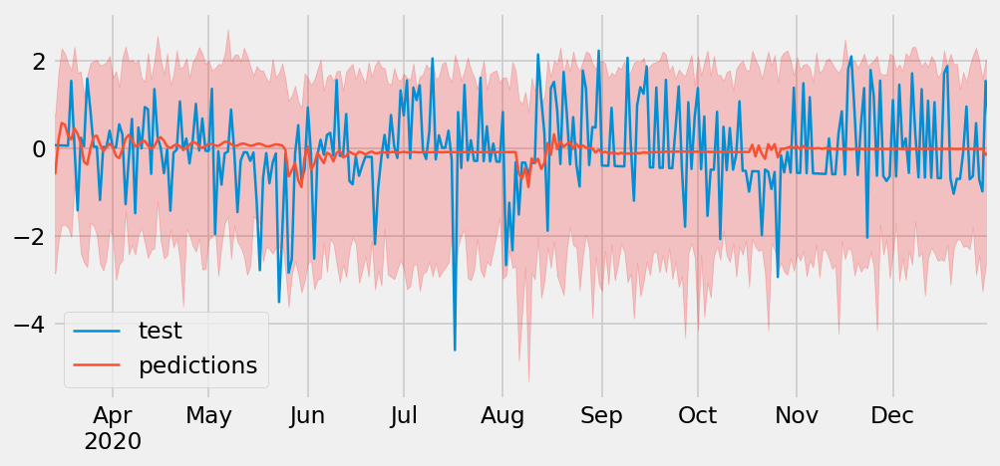

In [245]:
# Backtest with prediction intervals
# ==============================================================================
n_backtesting = 42*7 # The last 9 years are separated for backtesting
forecaster = ForecasterAutoreg(
                regressor = LinearRegression(),
                lags      = 15
             )

metric, predictions = backtesting_forecaster(
                            forecaster         = forecaster,
                            y                  = TSLA_detrended_stationary['Close'],
                            initial_train_size = len(TSLA_detrended_stationary) - n_backtesting,
                            fixed_train_size   = False,
                            steps              = steps,
                            metric             = 'mean_squared_error',
                            refit              = True,
                            interval           = [1, 99],
                            n_boot             = 100,
                            verbose            = True
                      )

print(f"Test error (mse): {error_mse}")

# Plot
# ==============================================================================
fig, ax = plt.subplots(figsize=(9, 4))
TSLA_detrended_stationary.loc[predictions.index, 'Close'].plot(ax=ax, label='test')
predictions['pred'].plot(ax=ax, label='pedictions')
ax.fill_between(
    predictions.index,
    predictions['lower_bound'],
    predictions['upper_bound'],
    color = 'red',
    alpha = 0.2
)
ax.legend();

In [246]:
# Predicted interval coverage
# ==============================================================================
inside_interval = np.where(
                     (TSLA_detrended_stationary.loc[predictions.index, 'Close'] >= predictions['lower_bound']) & \
                     (TSLA_detrended_stationary.loc[predictions.index, 'Close'] <= predictions['upper_bound']),
                     True,
                     False
                   )

coverage = inside_interval.mean()
print(f"Predicted interval coverage: {round(100*coverage, 2)} %")

Predicted interval coverage: 95.58 %


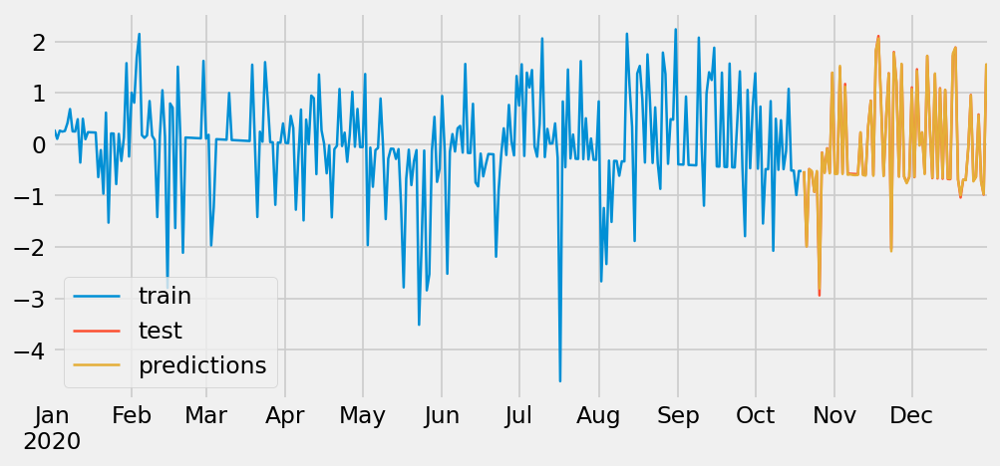

In [247]:
data_train_1 = TSLA_detrended_stationary[:-steps]
data_test_1  = TSLA_detrended_stationary[-steps:]

regressor = RandomForestRegressor(random_state=123)
forecaster = ForecasterAutoreg(
                regressor = regressor,
                lags      = 8
             )

forecaster.fit(y=data_train_1['Close'], exog=data_train_1[exog])

predictions = forecaster.predict(steps=steps, exog=data_test_1[exog])
fig, ax=plt.subplots(figsize=(9, 4))
data_train_1['Close'].plot(ax=ax, label='train')
data_test_1['Close'].plot(ax=ax, label='test')
predictions.plot(ax=ax, label='predictions')
ax.legend();

In [248]:
predictions.head(10)


2020-10-20   -0.522492
2020-10-21   -1.986972
2020-10-22   -0.487021
2020-10-23   -0.520737
2020-10-24   -0.926106
2020-10-25   -0.520610
2020-10-26   -2.804375
2020-10-27   -0.166988
2020-10-28   -0.559373
2020-10-29   -0.086148
Freq: D, Name: pred, dtype: float64

In [249]:
data_test_1['Close'].head(10)

2020-10-20   -0.525094
2020-10-21   -1.984530
2020-10-22   -0.481744
2020-10-23   -0.533254
2020-10-24   -0.926550
2020-10-25   -0.538694
2020-10-26   -2.940143
2020-10-27   -0.160914
2020-10-28   -0.546854
2020-10-29   -0.077697
Freq: D, Name: Close, dtype: float64

In [250]:
# Test error
# ==============================================================================
error_mse = mean_squared_error(
                y_true = data_test_1['Close'],
                y_pred = predictions
            )

print(f"Test error (mse): {error_mse}")

Test error (mse): 0.0005912417193478179


In [251]:
# Hyperparameter Grid search
# ==============================================================================
forecaster = ForecasterAutoreg(
                regressor = RandomForestRegressor(random_state=123),
                lags      = 14 # This value will be replaced in the grid search
             )

# Lags used as predictors
lags_grid = [7, 14, 21]

# Regressor's hyperparameters
param_grid = {'n_estimators': [1, 100, 150],
              'max_depth': [1, 2, 3]}

results_grid = grid_search_forecaster(
                        forecaster  = forecaster,
                        y           = data_train['Close'],
                        exog        = data_train[exog],
                        param_grid  = param_grid,
                        lags_grid   = lags_grid,
                        steps       = steps,
                        refit       = True,
                        metric      = 'mean_squared_error',
                        initial_train_size = int(len(data_train)*0.5),
                        return_best = True,
                        verbose     = False
               )

Number of models compared: 27.


lags grid:   0%|          | 0/3 [00:00<?, ?it/s]

params grid:   0%|          | 0/9 [00:00<?, ?it/s]

`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5 6 7] 
  Parameters: {'max_depth': 3, 'n_estimators': 150}
  Backtesting metric: 0.04656119745606321



In [252]:
results_grid.head()

,lags,lags_label,params,mean_squared_error,max_depth,n_estimators
8,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 3, 'n_estimators': 150}",0.046561,3,150
7,"[1, 2, 3, 4, 5, 6, 7]","[1, 2, 3, 4, 5, 6, 7]","{'max_depth': 3, 'n_estimators': 100}",0.047481,3,100
17,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 3, 'n_estimators': 150}",0.048232,3,150
16,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'max_depth': 3, 'n_estimators': 100}",0.048445,3,100
25,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 3, 'n_estimators': 100}",0.051618,3,100


In [253]:
train = TSLA_detrended_stationary[TSLA_detrended_stationary.index < pd.to_datetime("2020-11-01", format='%Y-%m-%d')]
test = TSLA_detrended_stationary[TSLA_detrended_stationary.index >= pd.to_datetime("2020-11-01", format='%Y-%m-%d')]

In [254]:
y = train['Close']

ARMAmodel = SARIMAX(y, order = (1, 0, 1))
ARMAmodel = ARMAmodel.fit()

y_pred = ARMAmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = ARMAmodel.predict(start = y_pred_df.index[0], 
                                             end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outARMA = y_pred_df["Predictions"] 

arma_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))


ARIMAmodel = SARIMAX(y, order = (1, 1, 50))
# ARIMAmodel = SARIMAX(y, order = (2, 3, 2))
# ARIMAmodel = SARIMAX(y, order = (5, 4, 2))
ARIMAmodel = ARIMAmodel.fit()

y_pred = ARIMAmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = ARIMAmodel.predict(start = y_pred_df.index[0],
                                              end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outARIMA = y_pred_df["Predictions"]
arima_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))



In [255]:
exog_train = train.iloc[:, :-1].values
exog_test = test.iloc[:, :-1]

In [256]:
SARIMAXmodel = SARIMAX(y, order = (2,1,1), seasonal_order=(2,2,2,12))
SARIMAXmodel = SARIMAXmodel.fit()

y_pred = SARIMAXmodel.get_forecast(len(test.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = SARIMAXmodel.predict(start = y_pred_df.index[0],
                                                end = y_pred_df.index[-1])
y_pred_df.index = test.index
y_pred_outSARIMA = y_pred_df["Predictions"] 

sarma_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))


SARIMAXmodel = SARIMAX(y, exog = exog_train, order = (2,1,1), seasonal_order=(2,2,2,12))
SARIMAXmodel = SARIMAXmodel.fit()

y_pred = SARIMAXmodel.get_forecast(len(test.index),exog=exog_test)
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = SARIMAXmodel.predict(start = y_pred_df.index[0],
                                                end = y_pred_df.index[-1],
                                                exog=exog_test)
y_pred_df.index = test.index
y_pred_outSARIMAX = y_pred_df["Predictions"] 

sarmax_rmse = np.sqrt(mean_squared_error(test["Close"].values, y_pred_df["Predictions"]))

print("ARMA RMSE: ",arma_rmse)

print("ARIMA RMSE: ",arima_rmse)

print("SARIMA RMSE: ",sarma_rmse)

print("SARIMAX RMSE: ",sarmax_rmse)

ARMA RMSE:  1.0001653474347596
ARIMA RMSE:  1.1225301923568622
SARIMA RMSE:  1.307769403497399
SARIMAX RMSE:  0.000156688384220875


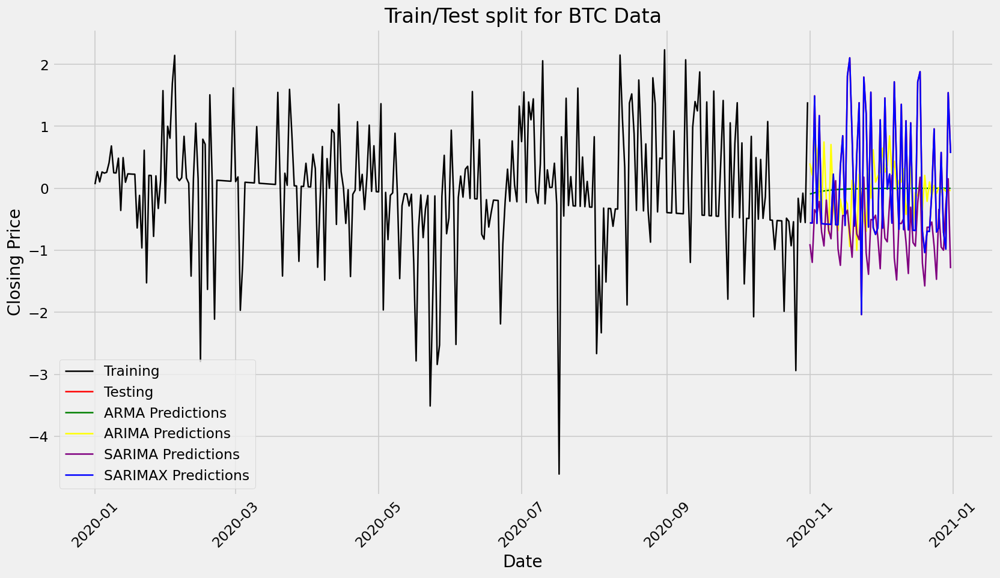

In [257]:
plt.figure(figsize=(15, 8)) 
start_date = '2020-10-20' 
filtered_data = train.loc[start_date:]

plt.plot(train['Close'], color = "black", label = 'Training')
plt.plot(test['Close'], color = "red", label = 'Testing')
plt.ylabel('Closing Price')
plt.xlabel('Date')
plt.xticks(rotation=45)
plt.title("Train/Test split for BTC Data")
plt.plot(y_pred_outARMA, color='green', label = 'ARMA Predictions')
plt.plot(y_pred_outARIMA, color='Yellow', label = 'ARIMA Predictions')
plt.plot(y_pred_outSARIMA, color='purple', label = 'SARIMA Predictions')
plt.plot(y_pred_outSARIMAX, color='Blue', label = 'SARIMAX Predictions')
plt.legend()
plt.show()

In [258]:
test['Close'].head(10)


2020-11-01   -0.557734
2020-11-02   -0.560454
2020-11-03    1.490565
2020-11-04   -0.565894
2020-11-05    1.172378
2020-11-06   -0.571334
2020-11-07   -0.574054
2020-11-08   -0.576774
2020-11-09   -0.579495
2020-11-10   -0.582215
Freq: D, Name: Close, dtype: float64

In [259]:
y_pred_outSARIMAX.head(10)

2020-11-01   -0.558007
2020-11-02   -0.560335
2020-11-03    1.490547
2020-11-04   -0.565870
2020-11-05    1.172405
2020-11-06   -0.571227
2020-11-07   -0.574162
2020-11-08   -0.576846
2020-11-09   -0.579394
2020-11-10   -0.582222
Freq: D, Name: Predictions, dtype: float64

# 4. Neural Networks 

## 1. AAPL

In [262]:
AAPL_all_dates_KNN_df.head()

,compound_score,Open,High,Low,Adj_Close,Volume,Close
2019-12-31,0.000000,72.4825,73.420000,72.380000,71.520800,1.008060e+08,73.412500
2020-01-01,0.000000,73.6100,74.571667,73.434167,72.371633,1.275363e+08,74.285833
2020-01-02,0.341875,74.0600,75.150000,73.797500,73.152600,1.354800e+08,75.087500
2020-01-03,0.008517,74.2875,75.145000,74.125000,72.441500,1.463230e+08,74.357500
2020-01-04,0.000000,73.8475,74.786000,73.572000,72.561780,1.219736e+08,74.481000


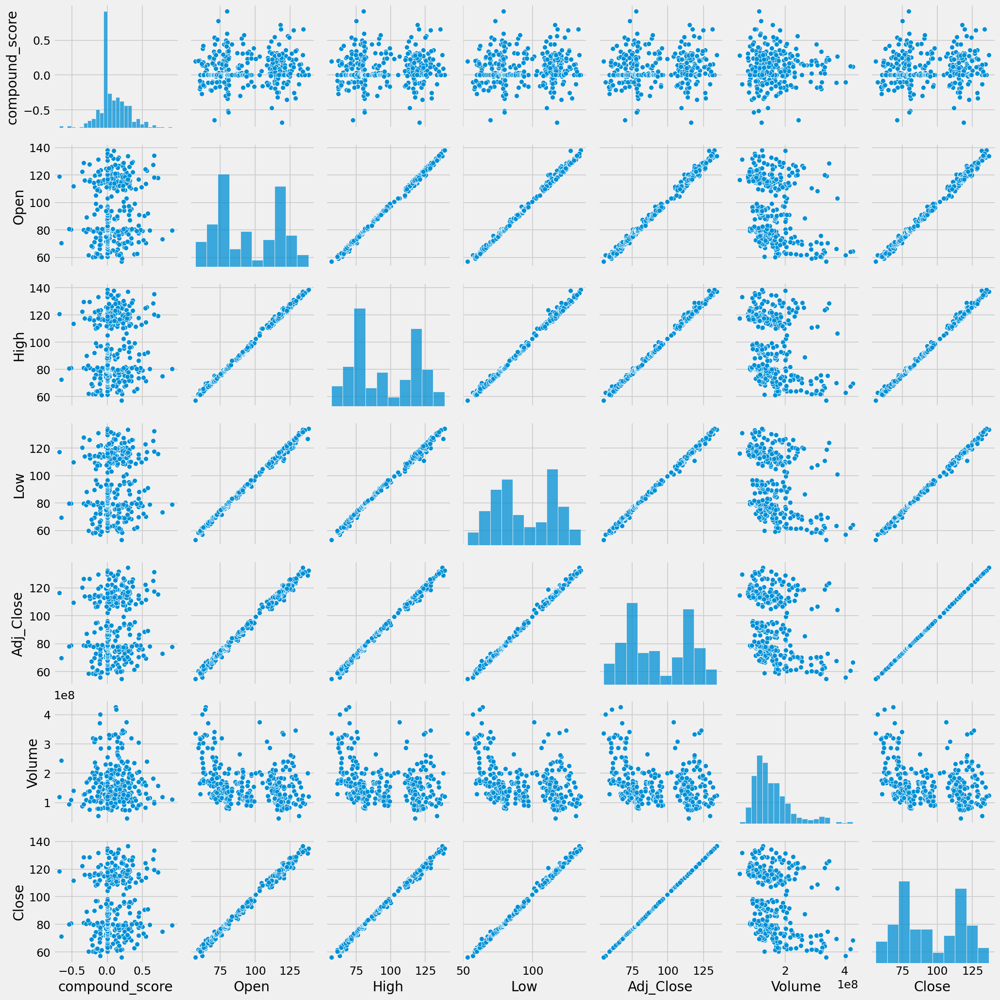

In [263]:
sns.pairplot(AAPL_all_dates_KNN_df)

In [264]:
training_data_len = math.ceil( len(AAPL_all_dates_KNN_df) * .8 )
scaler = StandardScaler()
dataset = scaler.fit_transform(AAPL_all_dates_KNN_df)
dataset

array([[-0.40407746, -1.03208756, -1.04713362, ..., -1.01010122,
        -0.8511644 , -1.00204808],
       [-0.40407746, -0.98056975, -0.99477671, ..., -0.97044567,
        -0.44171651, -0.96178043],
       [ 1.24352865, -0.96000831, -0.96848461, ..., -0.93404646,
        -0.32003761, -0.92481718],
       ...,
       [-0.40407746,  1.96382785,  1.92470795, ...,  1.83336262,
        -0.54111833,  1.83163424],
       [-0.40407746,  1.85096842,  1.79741475, ...,  1.7806957 ,
        -0.91785624,  1.77861005],
       [-0.16102292,  1.7824303 ,  1.74058743, ...,  1.73352851,
        -0.87704216,  1.73111881]])

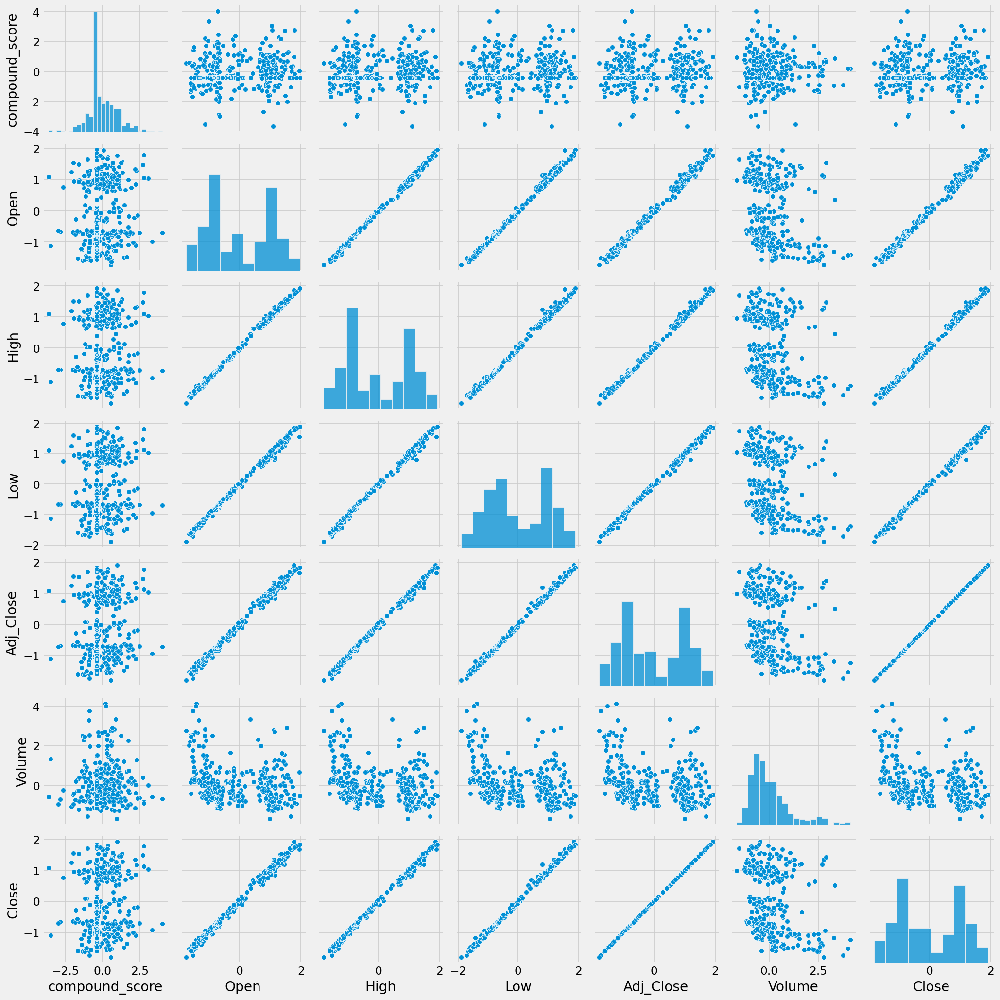

In [265]:
df = pd.DataFrame(dataset, columns=AAPL_all_dates_KNN_df.columns)

sns.pairplot(df)

In [266]:
train_data = dataset[0:training_data_len , :]
x_train =[]
y_train =[]

In [267]:
for i in range(30, len(train_data)):
    x_train.append(train_data[i-30:i,:-1])
    y_train.append(train_data[i,-1])

In [268]:
x_train, y_train = np.array(x_train), np.array(y_train)

In [269]:
x_train =np.reshape(x_train,(x_train.shape[0], x_train.shape[1],6))
x_train.shape

(264, 30, 6)

In [270]:
model = Sequential()
model.add(LSTM(100, return_sequences = True, input_shape =(30, 6)))
model.add(Dropout(0.2))
model.add(LSTM(units = 100, return_sequences = True))
model.add(Dropout(0.2))

model.add(LSTM(100, return_sequences = False))
model.add(Dense(100))
model.add(Dense(1))

In [271]:
model.compile(loss='mean_squared_logarithmic_error', optimizer='Adam', metrics=['accuracy'])

In [272]:
model.fit(x_train, y_train, batch_size = 5, epochs = 100)

Epoch 1/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 7s 23ms/step - accuracy: 0.0000e+00 - loss: 0.0240
Epoch 2/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.0000e+00 - loss: 0.0062
Epoch 3/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.0000e+00 - loss: 0.0028
Epoch 4/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.0000e+00 - loss: 0.0067
Epoch 5/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.0000e+00 - loss: 0.0043
Epoch 6/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.0000e+00 - loss: 0.0024
Epoch 7/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.0000e+00 - loss: 0.0040
Epoch 8/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.0000e+00 - loss: 0.0024
Epoch 9/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.0000e+00 - loss: 0.0042
Epoch 10/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.0000e+00 - loss: 0.0026
Epoch 11/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.0000e+00 - loss: 0.0024
Epoch 12

In [273]:
scores = model.evaluate(x_train, y_train, verbose = 0)
print(scores)

[0.0010009725810959935, 0.0]


In [274]:
test_data = dataset[training_data_len -30: , :]

In [275]:
x_test = []
y_test = dataset[training_data_len:, :]

In [276]:
for i in range(30,len(test_data)):
    x_test.append(test_data[i-30:i,:-1])

In [277]:
x_test = np.array(x_test)

In [278]:
x_test = np.reshape(x_test,(x_test.shape[0], x_test.shape[1],6))

In [279]:
predictions = model.predict(x_test)

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 258ms/step


In [280]:
array1_avg = np.mean(x_test, axis=1) 

# Now concatenate along the last axis
result = np.concatenate((array1_avg, predictions), axis=1)

In [281]:
predictions = scaler.inverse_transform(result)

In [282]:
y_test = scaler.inverse_transform(y_test)
rmse = np.sqrt(mean_squared_error(y_test,predictions))
r2_value = r2_score(scaler.inverse_transform(y_test),predictions)

In [283]:
print("Root Mean Square Error: ", rmse)
print("R^2 Value: ", r2_value)

Root Mean Square Error:  11562720.65784731
R^2 Value:  -234.39372776050547


In [284]:
predictions = predictions[:,-1]
train = AAPL_all_dates_KNN_df[:training_data_len]
valid = AAPL_all_dates_KNN_df[training_data_len:]
valid['Predictions'] = predictions

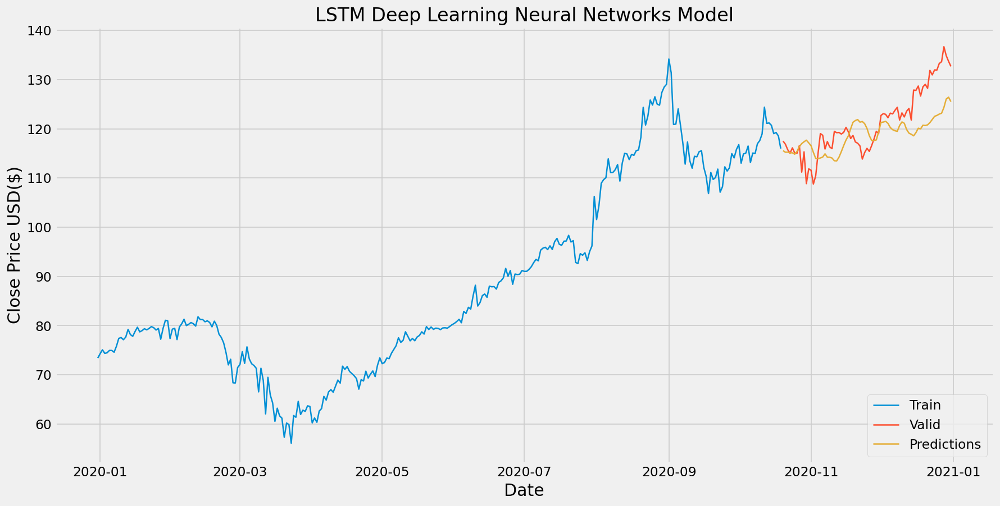

In [285]:
plt.figure(figsize=(16,8))
plt.title('LSTM Deep Learning Neural Networks Model')
plt.xlabel('Date',fontsize=18)
plt.ylabel('Close Price USD($)', fontsize=18)
plt.plot(train['Close'])
plt.plot(valid[['Close', 'Predictions']])
plt.legend(['Train', 'Valid', 'Predictions'], loc = 'lower right')
# plt.ylim(0, 200) 
plt.show()

In [286]:
close_price_pred = AAPL_all_dates_KNN_df
# new_df = close_price_pred['Close']
last_30_days = close_price_pred[-7:].values

In [287]:
last_30_days_scaled = scaler.transform(last_30_days)

In [288]:
X_test2 = []
X_test2.append(last_30_days_scaled)
X_test2 = np.array(X_test2)
X_test2 = X_test2[: , :, :-1]

In [289]:
X_test2 = np.reshape(X_test2,(X_test2.shape[0],X_test2.shape[1], 6))

In [290]:
pred_price = model.predict(X_test2)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


In [291]:
array1_avg = np.mean(X_test2, axis=1) 

# Now concatenate along the last axis
result = np.concatenate((array1_avg, pred_price), axis=1)

In [292]:
pred_price = scaler.inverse_transform(result)

In [293]:
print('The predicted stock price 7 Days from the end, is: ', pred_price[:,-1])

The predicted stock price 7 Days from the end, is:  [124.23762708]


In [294]:
valid['Close'].head(10)

2020-10-20    117.510000
2020-10-21    116.870000
2020-10-22    115.750000
2020-10-23    115.040000
2020-10-24    116.136667
2020-10-25    115.085000
2020-10-26    115.050000
2020-10-27    116.600000
2020-10-28    111.200000
2020-10-29    115.320000
Name: Close, dtype: float64

## 2. AMZN

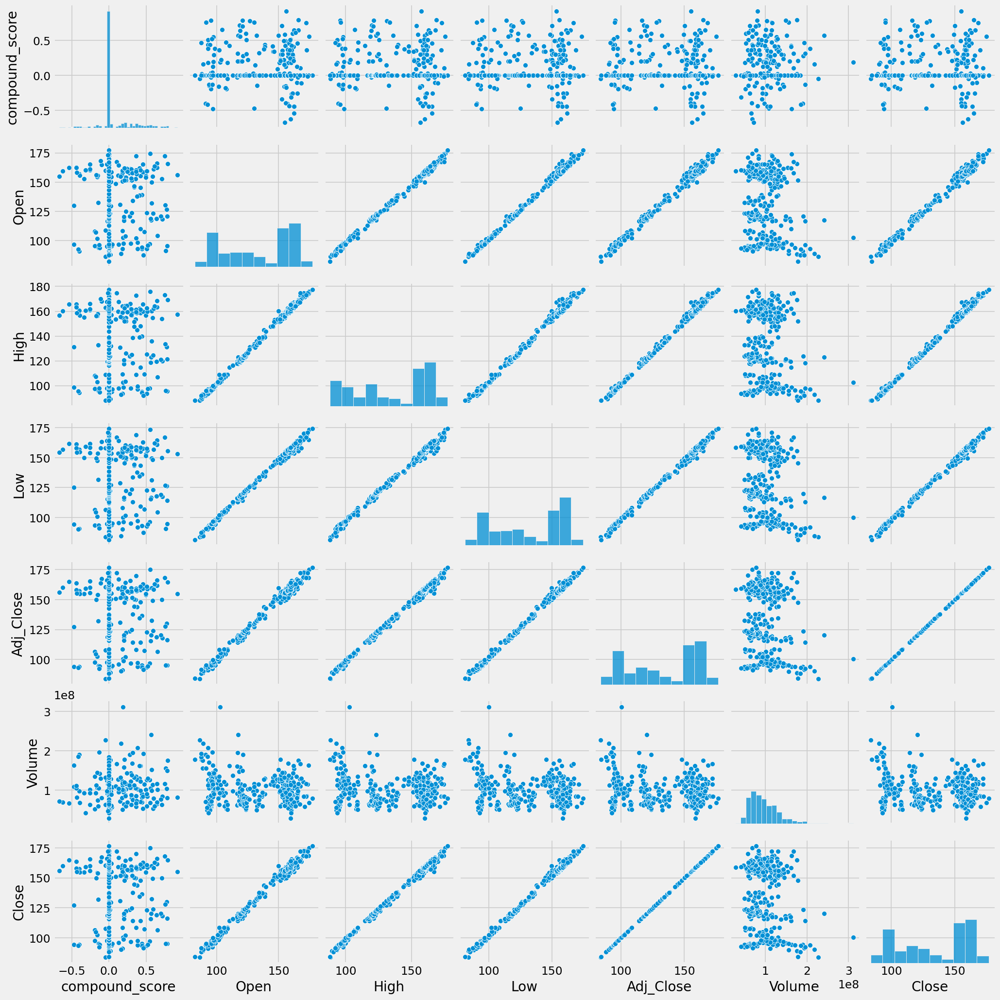

In [296]:
sns.pairplot(AMZN_all_dates_KNN_df)

In [297]:
training_data_len = math.ceil( len(AMZN_all_dates_KNN_df) * .8 )
scaler = MinMaxScaler()
dataset = scaler.fit_transform(AMZN_all_dates_KNN_df)

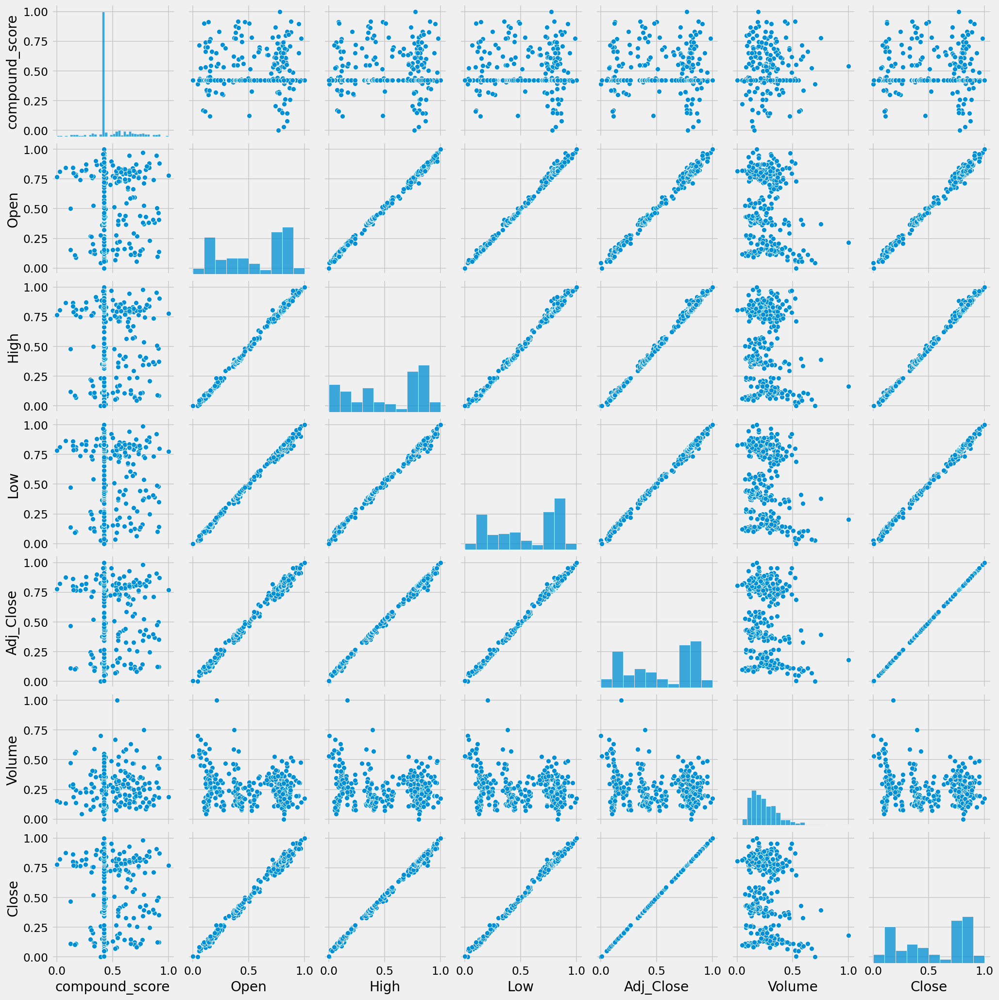

In [298]:
df = pd.DataFrame(dataset, columns=AMZN_all_dates_KNN_df.columns)
sns.pairplot(df)

In [299]:
train_data = dataset[0:training_data_len , :]
x_train =[]
y_train =[]

In [300]:
for i in range(30, len(train_data)):
    x_train.append(train_data[i-30:i,:-1])
    y_train.append(train_data[i,-1])

In [301]:
x_train, y_train = np.array(x_train), np.array(y_train)
x_train =np.reshape(x_train,(x_train.shape[0], x_train.shape[1],6))

In [302]:
model = Sequential()
model.add(LSTM(100, return_sequences = True, input_shape =(30, 6)))
model.add(Dropout(0.2))
model.add(LSTM(units = 100, return_sequences = True))
model.add(Dropout(0.2))

model.add(LSTM(100, return_sequences = False))
model.add(Dense(100))
model.add(Dense(1))

In [303]:
model.compile(loss='mean_squared_logarithmic_error', optimizer='Adam', metrics=['accuracy'])

In [304]:
model.fit(x_train, y_train, batch_size = 5, epochs = 100)

Epoch 1/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 6s 20ms/step - accuracy: 0.0032 - loss: 0.0204
Epoch 2/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.0060 - loss: 0.0031
Epoch 3/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.0039 - loss: 0.0029
Epoch 4/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.0045 - loss: 0.0019
Epoch 5/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.0114 - loss: 0.0016
Epoch 6/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.0015 - loss: 0.0021   
Epoch 7/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.0060 - loss: 0.0019
Epoch 8/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.0024 - loss: 0.0020
Epoch 9/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.0045 - loss: 0.0012
Epoch 10/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.0021 - loss: 0.0015
Epoch 11/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.0110 - loss: 0.0011
Epoch 12/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/s

In [305]:
scores = model.evaluate(x_train, y_train, verbose = 0)
print(scores)

[0.0004327318165451288, 0.007575757801532745]


In [306]:
test_data = dataset[training_data_len -30: , :]
x_test = []
y_test = dataset[training_data_len:, :]

In [307]:
for i in range(30,len(test_data)):
    x_test.append(test_data[i-30:i,:-1])

In [308]:
x_test = np.array(x_test)
x_test = np.reshape(x_test,(x_test.shape[0], x_test.shape[1],6))

In [309]:
predictions = model.predict(x_test)

1/3 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/stepWARNING:tensorflow:5 out of the last 7 calls to <function TensorFlowTrainer.make_predict_function.<locals>.one_step_on_data_distributed at 0x000001F9EC22A980> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.


tensorflow WARNING 5 out of the last 7 calls to <function TensorFlowTrainer.make_predict_function.<locals>.one_step_on_data_distributed at 0x000001F9EC22A980> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.


3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 256ms/step


In [310]:
array1_avg = np.mean(x_test, axis=1) 

# Now concatenate along the last axis
result = np.concatenate((array1_avg, predictions), axis=1)

In [311]:
predictions = scaler.inverse_transform(result)

In [312]:
y_test = scaler.inverse_transform(y_test)
rmse = np.sqrt(mean_squared_error(y_test,predictions))
r2_value = r2_score(scaler.inverse_transform(y_test),predictions)

In [313]:
print("Root Mean Square Error: ", rmse)
print("R^2 Value: ", r2_value)

Root Mean Square Error:  9532314.583593627
R^2 Value:  -1844.1699160459234


In [314]:
predictions = predictions[:,-1]
train = AMZN_all_dates_KNN_df[:training_data_len]
valid = AMZN_all_dates_KNN_df[training_data_len:]
valid['Predictions'] = predictions

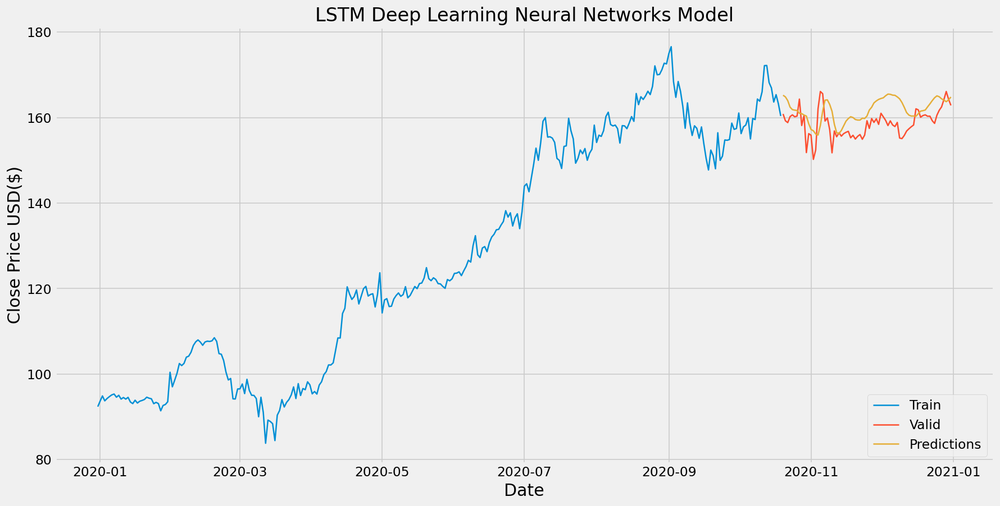

In [315]:
plt.figure(figsize=(16,8))
plt.title('LSTM Deep Learning Neural Networks Model')
plt.xlabel('Date',fontsize=18)
plt.ylabel('Close Price USD($)', fontsize=18)
plt.plot(train['Close'])
plt.plot(valid[['Close', 'Predictions']])
plt.legend(['Train', 'Valid', 'Predictions'], loc = 'lower right')
# plt.ylim(0, 200) 
plt.show()

In [316]:
close_price_pred = AMZN_all_dates_KNN_df
last_30_days = close_price_pred[-7:].values
last_30_days_scaled = scaler.transform(last_30_days)

In [317]:
X_test2 = []
X_test2.append(last_30_days_scaled)
X_test2 = np.array(X_test2)
X_test2 = X_test2[: , :, :-1]
X_test2 = np.reshape(X_test2,(X_test2.shape[0],X_test2.shape[1], 6))

In [318]:
pred_price = model.predict(X_test2)

tensorflow WARNING 6 out of the last 8 calls to <function TensorFlowTrainer.make_predict_function.<locals>.one_step_on_data_distributed at 0x000001F9EC22A980> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


In [319]:
array1_avg = np.mean(X_test2, axis=1) 

# Now concatenate along the last axis
result = np.concatenate((array1_avg, pred_price), axis=1)
pred_price = scaler.inverse_transform(result)

In [320]:
print('The predicted stock price 7 Days from the end, is: ', pred_price[:,-1])

The predicted stock price 7 Days from the end, is:  [161.70507169]


In [321]:
valid['Close'].head(10)

2020-10-20    160.850000
2020-10-21    159.247000
2020-10-22    158.820000
2020-10-23    160.220000
2020-10-24    160.634167
2020-10-25    160.182333
2020-10-26    160.352000
2020-10-27    164.316000
2020-10-28    158.139000
2020-10-29    160.551000
Name: Close, dtype: float64

## 3. BA

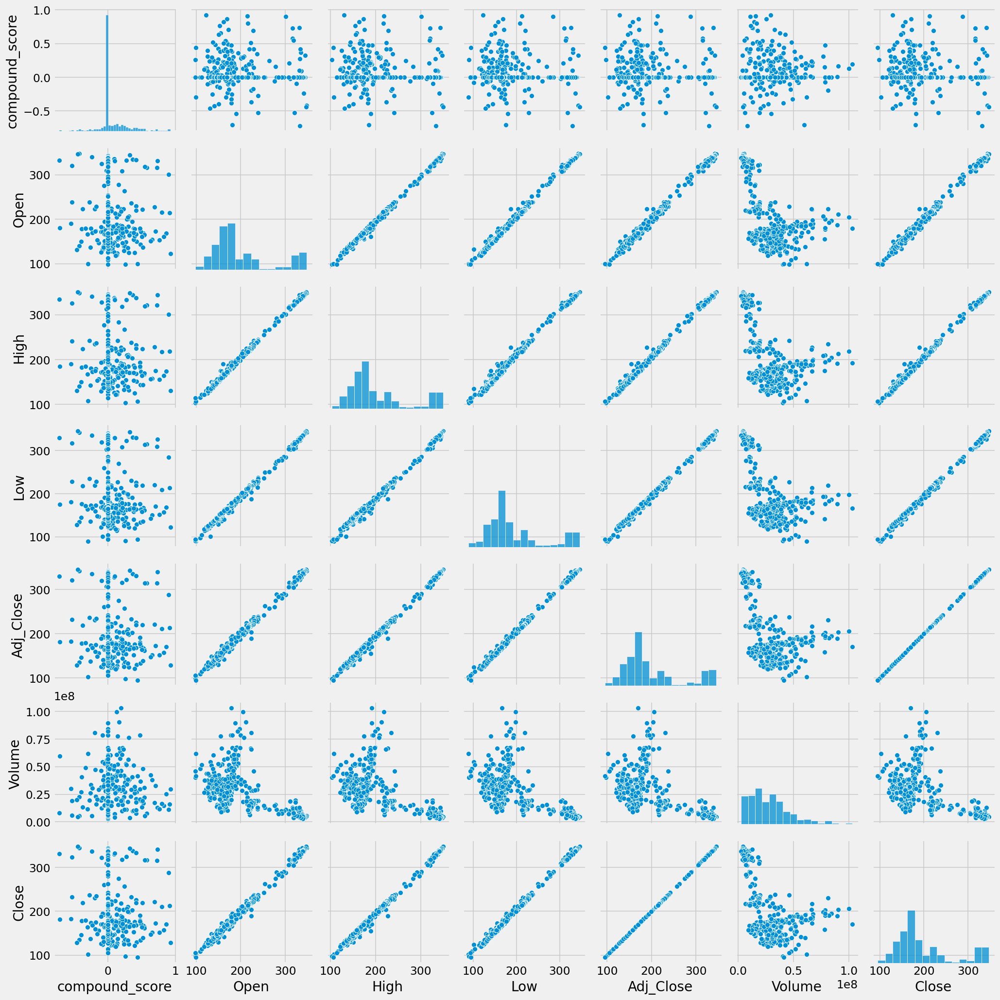

In [323]:
sns.pairplot(BA_all_dates_KNN_df)

In [324]:
training_data_len = math.ceil( len(BA_all_dates_KNN_df) * .8 )
scaler = MinMaxScaler()
dataset = scaler.fit_transform(BA_all_dates_KNN_df)

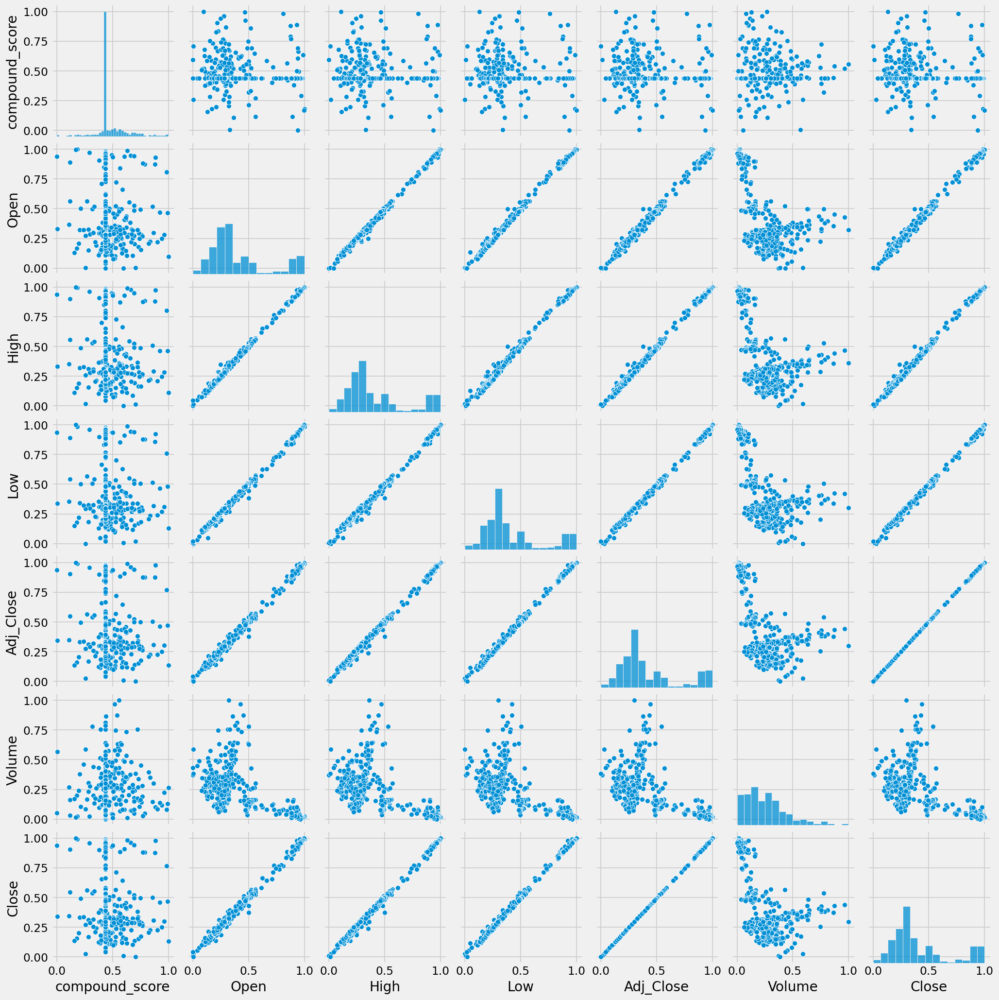

In [325]:
df = pd.DataFrame(dataset, columns=BA_all_dates_KNN_df.columns)
sns.pairplot(df)

In [326]:
train_data = dataset[0:training_data_len , :]
x_train =[]
y_train =[]

In [327]:
for i in range(30, len(train_data)):
    x_train.append(train_data[i-30:i,:-1])
    y_train.append(train_data[i,-1])

In [328]:
x_train, y_train = np.array(x_train), np.array(y_train)

In [329]:
x_train =np.reshape(x_train,(x_train.shape[0], x_train.shape[1],6))
x_train.shape

(264, 30, 6)

In [330]:
model = Sequential()
model.add(LSTM(100, return_sequences = True, input_shape =(30, 6)))
model.add(Dropout(0.2))
model.add(LSTM(units = 100, return_sequences = True))
model.add(Dropout(0.2))

model.add(LSTM(100, return_sequences = False))
model.add(Dense(100))
model.add(Dense(1))

In [331]:
model.compile(loss='mean_squared_logarithmic_error', optimizer='Adam', metrics=['accuracy'])

In [332]:
model.fit(x_train, y_train, batch_size = 5, epochs = 100)

Epoch 1/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 8s 20ms/step - accuracy: 0.0049 - loss: 0.0128
Epoch 2/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.0193 - loss: 0.0054
Epoch 3/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.0010 - loss: 0.0027    
Epoch 4/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.0074 - loss: 0.0029
Epoch 5/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.0078 - loss: 0.0027
Epoch 6/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.0061 - loss: 0.0026
Epoch 7/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.0137 - loss: 0.0026
Epoch 8/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.0106 - loss: 0.0024
Epoch 9/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step - accuracy: 0.0088 - loss: 0.0022
Epoch 10/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.0034 - loss: 0.0019
Epoch 11/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.0071 - loss: 0.0019
Epoch 12/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/

In [333]:
scores = model.evaluate(x_train, y_train, verbose = 0)
print(scores)

[0.0006167588289827108, 0.007575757801532745]


In [334]:
test_data = dataset[training_data_len -30: , :]
x_test = []
y_test = dataset[training_data_len:, :]

In [335]:
for i in range(30,len(test_data)):
    x_test.append(test_data[i-30:i,:-1])

In [336]:
x_test = np.array(x_test)
x_test = np.reshape(x_test,(x_test.shape[0], x_test.shape[1],6))

In [337]:
predictions = model.predict(x_test)

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 259ms/step


In [338]:
array1_avg = np.mean(x_test, axis=1) 

# Now concatenate along the last axis
result = np.concatenate((array1_avg, predictions), axis=1)

In [339]:
predictions = scaler.inverse_transform(result)

In [340]:
y_test = scaler.inverse_transform(y_test)
rmse = np.sqrt(mean_squared_error(y_test,predictions))
r2_value = r2_score(scaler.inverse_transform(y_test),predictions)

In [341]:
print("Root Mean Square Error: ", rmse)
print("R^2 Value: ", r2_value)

Root Mean Square Error:  4428135.168563488
R^2 Value:  -34.11521794750811


In [342]:
predictions = predictions[:,-1]
train = BA_all_dates_KNN_df[:training_data_len]
valid = BA_all_dates_KNN_df[training_data_len:]
valid['Predictions'] = predictions

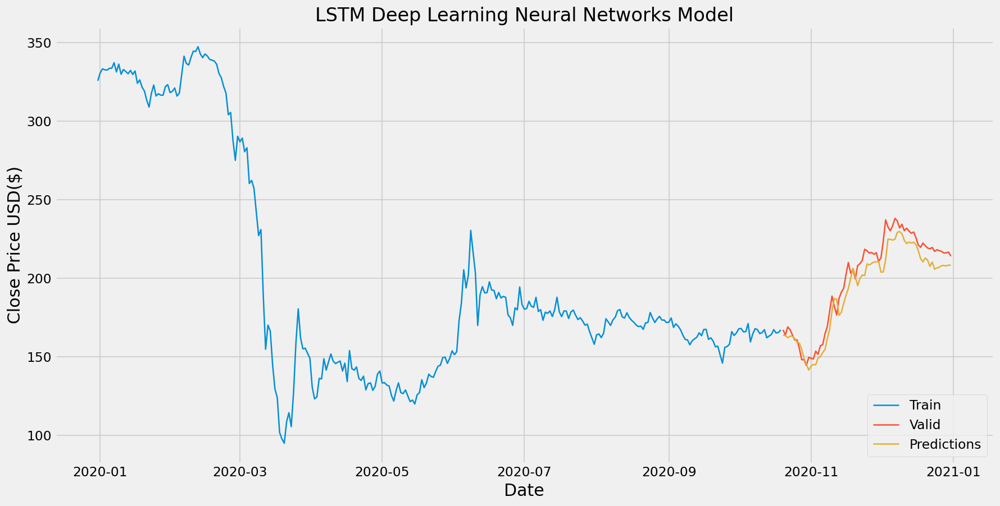

In [343]:
plt.figure(figsize=(16,8))
plt.title('LSTM Deep Learning Neural Networks Model')
plt.xlabel('Date',fontsize=18)
plt.ylabel('Close Price USD($)', fontsize=18)
plt.plot(train['Close'])
plt.plot(valid[['Close', 'Predictions']])
plt.legend(['Train', 'Valid', 'Predictions'], loc = 'lower right')
# plt.ylim(0, 200) 
plt.show()

In [344]:
close_price_pred = BA_all_dates_KNN_df
# new_df = close_price_pred['Close']
last_30_days = close_price_pred[-7:].values

In [345]:
last_30_days_scaled = scaler.transform(last_30_days)

In [346]:
X_test2 = []
X_test2.append(last_30_days_scaled)
X_test2 = np.array(X_test2)
X_test2 = X_test2[: , :, :-1]
X_test2 = np.reshape(X_test2,(X_test2.shape[0],X_test2.shape[1], 6))
pred_price = model.predict(X_test2)
array1_avg = np.mean(X_test2, axis=1) 

# Now concatenate along the last axis
result = np.concatenate((array1_avg, pred_price), axis=1)
pred_price = scaler.inverse_transform(result)
print('The predicted stock price 7 Days from the end, is: ', pred_price[:,-1])

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step
The predicted stock price 7 Days from the end, is:  [211.82218323]


In [347]:
valid[['Close', 'Predictions']]

,Close,Predictions
2020-10-20,167.240000,163.840799
2020-10-21,163.860000,163.478612
2020-10-22,169.070000,162.210094
2020-10-23,167.360000,163.215748
2020-10-24,163.933333,163.067915
2020-10-25,160.750000,161.698487
2020-10-26,160.830000,159.323517
2020-10-27,155.240000,158.793591
2020-10-28,148.140000,154.614568
2020-10-29,148.290000,149.131758


## 4. DIS

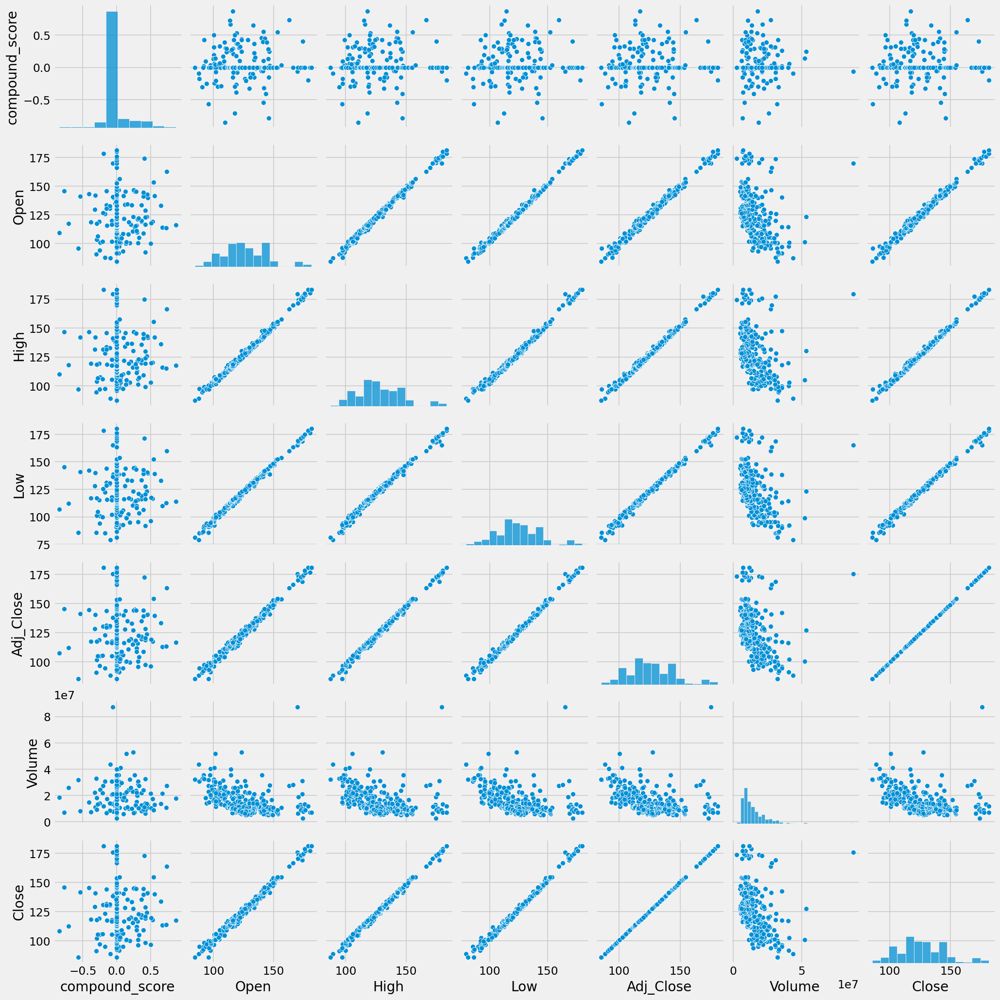

In [349]:
sns.pairplot(DIS_all_dates_KNN_df)

In [350]:
training_data_len = math.ceil( len(DIS_all_dates_KNN_df) * .8 )
scaler = MinMaxScaler()
dataset = scaler.fit_transform(DIS_all_dates_KNN_df)

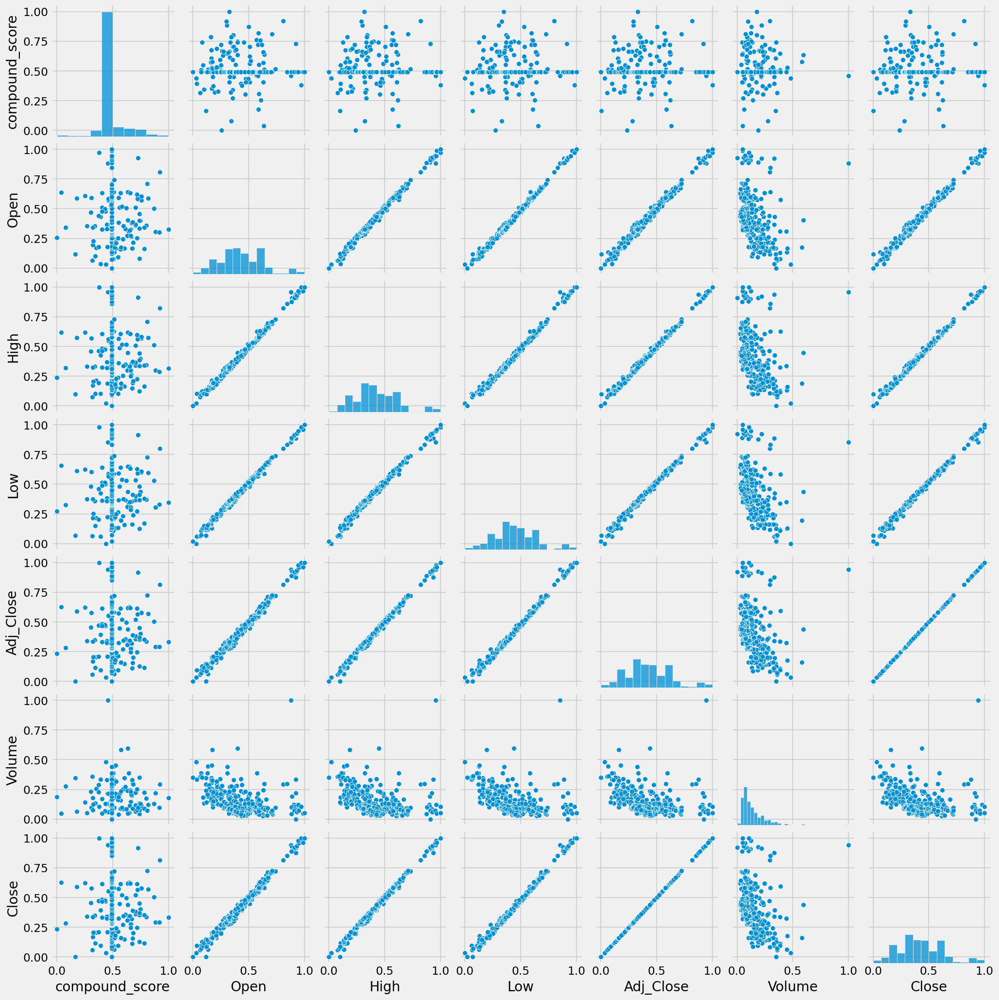

In [351]:
df = pd.DataFrame(dataset, columns=DIS_all_dates_KNN_df.columns)

sns.pairplot(df)

In [352]:
train_data = dataset[0:training_data_len , :]
x_train =[]
y_train =[]

In [353]:
for i in range(30, len(train_data)):
    x_train.append(train_data[i-30:i,:-1])
    y_train.append(train_data[i,-1])

In [354]:
x_train, y_train = np.array(x_train), np.array(y_train)

In [355]:
x_train =np.reshape(x_train,(x_train.shape[0], x_train.shape[1],6))

In [356]:
model = Sequential()
model.add(LSTM(100, return_sequences = True, input_shape =(30, 6)))
model.add(Dropout(0.2))
model.add(LSTM(units = 100, return_sequences = True))
model.add(Dropout(0.2))

model.add(LSTM(100, return_sequences = False))
model.add(Dense(100))
model.add(Dense(1))

In [357]:
model.compile(loss='mean_squared_logarithmic_error', optimizer='Adam', metrics=['accuracy'])

In [358]:
model.fit(x_train, y_train, batch_size = 5, epochs = 100)

Epoch 1/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 8s 19ms/step - accuracy: 0.0025 - loss: 0.0142
Epoch 2/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.0031 - loss: 0.0027
Epoch 3/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.0114 - loss: 0.0025
Epoch 4/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.0016 - loss: 0.0020 
Epoch 5/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.0014 - loss: 0.0016  
Epoch 6/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 2.1152e-04 - loss: 0.0016
Epoch 7/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.0049 - loss: 0.0018
Epoch 8/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 8.3676e-04 - loss: 0.0017
Epoch 9/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.0114 - loss: 0.0016
Epoch 10/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.0085 - loss: 0.0016
Epoch 11/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.0132 - loss: 0.0013
Epoch 12/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1

In [359]:
scores = model.evaluate(x_train, y_train, verbose = 0)
print(scores)

[0.0006474226829595864, 0.0037878789007663727]


In [360]:
test_data = dataset[training_data_len -30: , :]

In [361]:
x_test = []
y_test = dataset[training_data_len:, :]

In [362]:
for i in range(30,len(test_data)):
    x_test.append(test_data[i-30:i,:-1])

In [363]:
x_test = np.array(x_test)
x_test = np.reshape(x_test,(x_test.shape[0], x_test.shape[1],6))

In [364]:
predictions = model.predict(x_test)

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 259ms/step


In [365]:
array1_avg = np.mean(x_test, axis=1) 

# Now concatenate along the last axis
result = np.concatenate((array1_avg, predictions), axis=1)

In [366]:
predictions = scaler.inverse_transform(result)

In [367]:
y_test = scaler.inverse_transform(y_test)
rmse = np.sqrt(mean_squared_error(y_test,predictions))
r2_value = r2_score(scaler.inverse_transform(y_test),predictions)

In [368]:
print("Root Mean Square Error: ", rmse)
print("R^2 Value: ", r2_value)

Root Mean Square Error:  4092422.655231698
R^2 Value:  -46.25865281689316


In [369]:
predictions = predictions[:,-1]
train = DIS_all_dates_KNN_df[:training_data_len]
valid = DIS_all_dates_KNN_df[training_data_len:]
valid['Predictions'] = predictions

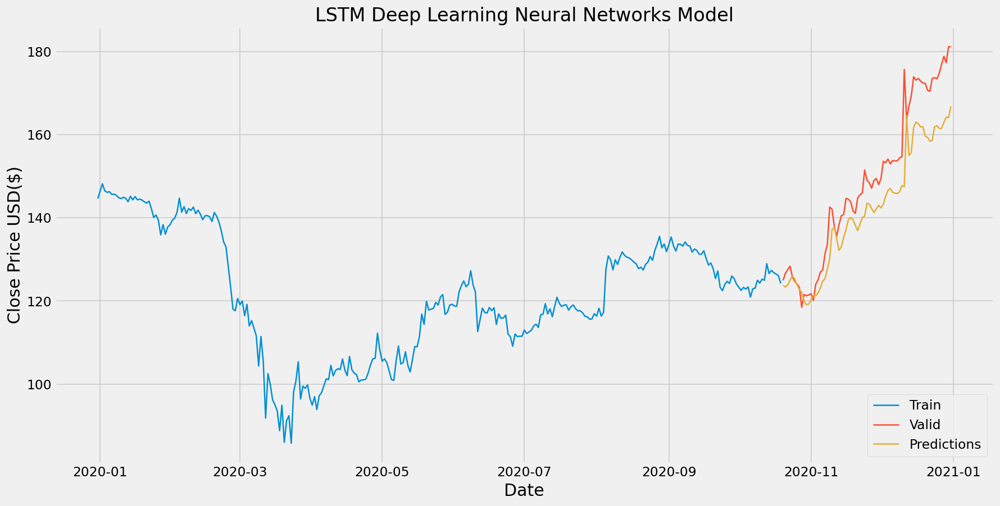

In [370]:
plt.figure(figsize=(16,8))
plt.title('LSTM Deep Learning Neural Networks Model')
plt.xlabel('Date',fontsize=18)
plt.ylabel('Close Price USD($)', fontsize=18)
plt.plot(train['Close'])
plt.plot(valid[['Close', 'Predictions']])
plt.legend(['Train', 'Valid', 'Predictions'], loc = 'lower right')
# plt.ylim(0, 200) 
plt.show()

In [371]:
close_price_pred = DIS_all_dates_KNN_df
# new_df = close_price_pred['Close']
last_30_days = close_price_pred[-7:].values

In [372]:
last_30_days_scaled = scaler.transform(last_30_days)

In [373]:
X_test2 = []
X_test2.append(last_30_days_scaled)
X_test2 = np.array(X_test2)
X_test2 = X_test2[: , :, :-1]

In [374]:
X_test2 = np.reshape(X_test2,(X_test2.shape[0],X_test2.shape[1], 6))

In [375]:
pred_price = model.predict(X_test2)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


In [376]:
array1_avg = np.mean(X_test2, axis=1) 

# Now concatenate along the last axis
result = np.concatenate((array1_avg, pred_price), axis=1)

In [377]:
pred_price = scaler.inverse_transform(result)

In [378]:
print('The predicted stock price 7 Days from the end, is: ', pred_price[:,-1])

The predicted stock price 7 Days from the end, is:  [164.69373837]


In [379]:
valid[['Close', 'Predictions']]

,Close,Predictions
2020-10-20,124.950000,123.766550
2020-10-21,126.630000,123.369391
2020-10-22,127.560000,123.869138
2020-10-23,128.350000,124.997707
2020-10-24,125.810000,126.031582
2020-10-25,124.730000,125.297843
2020-10-26,124.060000,123.829491
2020-10-27,123.310000,122.801329
2020-10-28,118.470000,121.993195
2020-10-29,121.540000,120.025281


## 5. TSLA

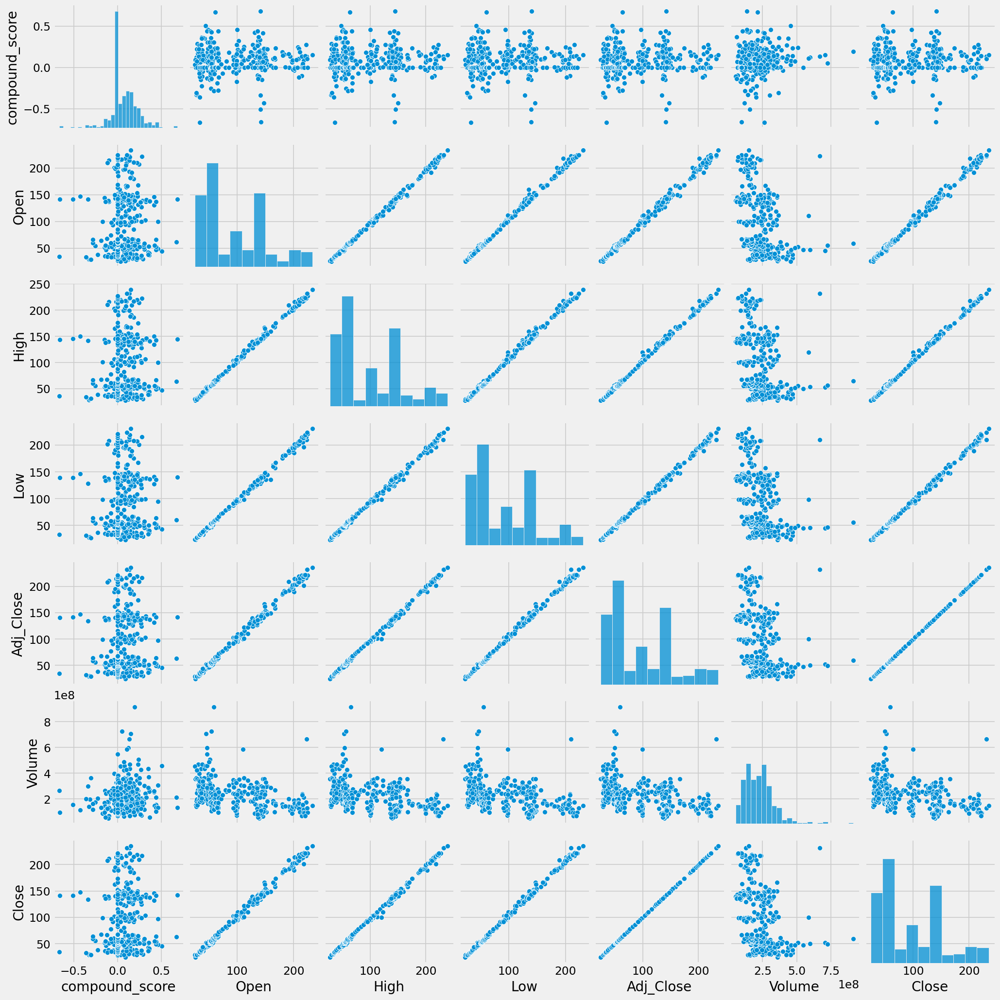

In [381]:
sns.pairplot(TSLA_all_dates_KNN_df)

In [382]:
training_data_len = math.ceil( len(TSLA_all_dates_KNN_df) * .8 )
scaler = MinMaxScaler()
dataset = scaler.fit_transform(TSLA_all_dates_KNN_df)

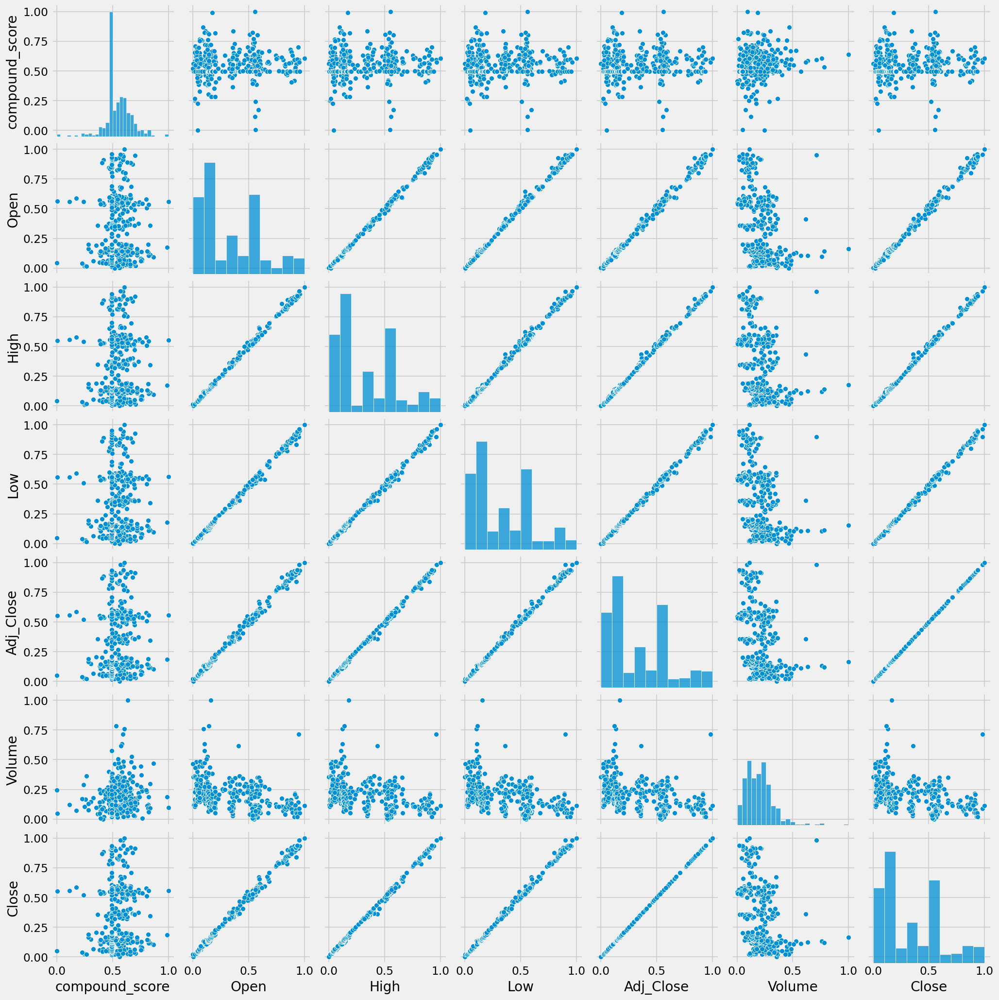

In [383]:
df = pd.DataFrame(dataset, columns=TSLA_all_dates_KNN_df.columns)

sns.pairplot(df)

In [384]:
train_data = dataset[0:training_data_len , :]
x_train =[]
y_train =[]

In [385]:
for i in range(30, len(train_data)):
    x_train.append(train_data[i-30:i,:-1])
    y_train.append(train_data[i,-1])

In [386]:
x_train, y_train = np.array(x_train), np.array(y_train)

In [387]:
x_train =np.reshape(x_train,(x_train.shape[0], x_train.shape[1],6))

In [388]:
model = Sequential()

model.add(LSTM(100, return_sequences = True, input_shape =(30, 6)))
model.add(Dropout(0.2))
model.add(LSTM(units = 100, return_sequences = True))
model.add(Dropout(0.2))
model.add(LSTM(100, return_sequences = False))
model.add(Dropout(0.2))

model.add(Dense(100, ))
model.add(Dense(1))

In [389]:
model.compile(loss='mean_squared_logarithmic_error', optimizer='Adam', metrics=['accuracy'])

In [390]:
model.fit(x_train, y_train, batch_size = 5, epochs = 100)

Epoch 1/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 8s 20ms/step - accuracy: 0.0019 - loss: 0.0146
Epoch 2/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 9.2289e-04 - loss: 0.0017
Epoch 3/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.0030 - loss: 0.0016
Epoch 4/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.0058 - loss: 0.0015
Epoch 5/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.0017 - loss: 0.0012 
Epoch 6/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 9.2289e-04 - loss: 0.0012
Epoch 7/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.0073 - loss: 0.0016
Epoch 8/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.0030 - loss: 0.0017
Epoch 9/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.0013 - loss: 0.0011  
Epoch 10/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.0085 - loss: 0.0011
Epoch 11/100
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.0014 - loss: 7.3118e-04  
Epoch 12/100
53/53 ━━━━━━━━━━━━━━━━

In [391]:
scores = model.evaluate(x_train, y_train, verbose = 0)
print(scores)

[0.000282442313618958, 0.0037878789007663727]


In [392]:
test_data = dataset[training_data_len -30: , :]

In [393]:
x_test = []
y_test = dataset[training_data_len:, :]

In [394]:
for i in range(30,len(test_data)):
    x_test.append(test_data[i-30:i,:-1])

In [395]:
x_test = np.array(x_test)
x_test = np.reshape(x_test,(x_test.shape[0], x_test.shape[1],6))

In [396]:
predictions = model.predict(x_test)

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 261ms/step


In [397]:
array1_avg = np.mean(x_test, axis=1) 

# Now concatenate along the last axis
result = np.concatenate((array1_avg, predictions), axis=1)

In [398]:
predictions = scaler.inverse_transform(result)

In [399]:
y_test = scaler.inverse_transform(y_test)
rmse = np.sqrt(mean_squared_error(y_test,predictions))
r2_value = r2_score(scaler.inverse_transform(y_test),predictions)

In [400]:
print("Root Mean Square Error: ", rmse)
print("R^2 Value: ", r2_value)

Root Mean Square Error:  29126786.82914898
R^2 Value:  -21.610236093548956


In [401]:
predictions = predictions[:,-1]
train = TSLA_all_dates_KNN_df[:training_data_len]
valid = TSLA_all_dates_KNN_df[training_data_len:]
valid['Predictions'] = predictions

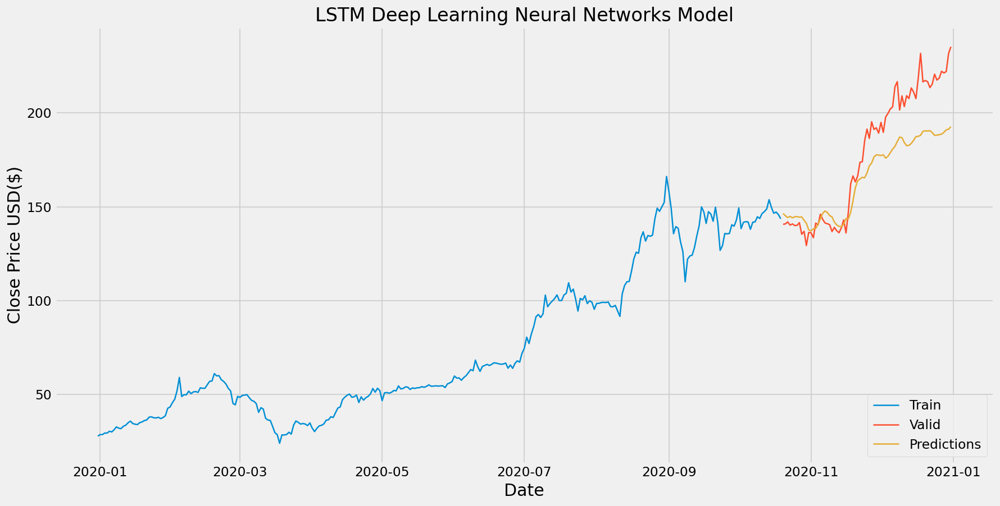

In [402]:
plt.figure(figsize=(16,8))
plt.title('LSTM Deep Learning Neural Networks Model')
plt.xlabel('Date',fontsize=18)
plt.ylabel('Close Price USD($)', fontsize=18)
plt.plot(train['Close'])
plt.plot(valid[['Close', 'Predictions']])
plt.legend(['Train', 'Valid', 'Predictions'], loc = 'lower right')
# plt.ylim(0, 200) 
plt.show()

In [403]:
close_price_pred = TSLA_all_dates_KNN_df
# new_df = close_price_pred['Close']
last_30_days = close_price_pred[-7:].values

In [404]:
last_30_days_scaled = scaler.transform(last_30_days)

In [405]:
X_test2 = []
X_test2.append(last_30_days_scaled)
X_test2 = np.array(X_test2)
X_test2 = X_test2[: , :, :-1]

In [406]:
X_test2 = np.reshape(X_test2,(X_test2.shape[0],X_test2.shape[1], 6))

In [407]:
pred_price = model.predict(X_test2)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step


In [408]:
array1_avg = np.mean(X_test2, axis=1) 

# Now concatenate along the last axis
result = np.concatenate((array1_avg, pred_price), axis=1)

In [409]:
pred_price = scaler.inverse_transform(result)

In [410]:
print('The predicted stock price 7 Days from the end, is: ', pred_price[:,-1])

The predicted stock price 7 Days from the end, is:  [186.39771772]


In [411]:
valid[['Close', 'Predictions']]

,Close,Predictions
2020-10-20,140.647000,146.396225
2020-10-21,140.880000,145.221086
2020-10-22,141.930000,144.261389
2020-10-23,140.210000,144.876671
2020-10-24,140.886667,144.139780
2020-10-25,140.002167,144.667093
2020-10-26,140.093000,144.788677
2020-10-27,141.560000,144.432269
2020-10-28,135.340000,144.613153
2020-10-29,136.943000,142.824481


# 5. Optimisations

## 1. AAPL

In [414]:
x = AAPL_detrended_stationary.iloc[:, :6] 
y = AAPL_detrended_stationary.iloc[:, 6]
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.33,random_state=42)

In [415]:
model = lgb.LGBMRegressor(random_state=42)
model.fit(x_train,y_train,eval_set=[(x_test,y_test),(x_train,y_train)])

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000559 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 245, number of used features: 6
[LightGBM] [Info] Start training from score -0.040871
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

LGBMRegressor(random_state=42)

In [416]:
print('Testing accuracy {:.4f}'.format(model.score(x_test,y_test)))

Testing accuracy 0.9397


<Axes: title={'center': 'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

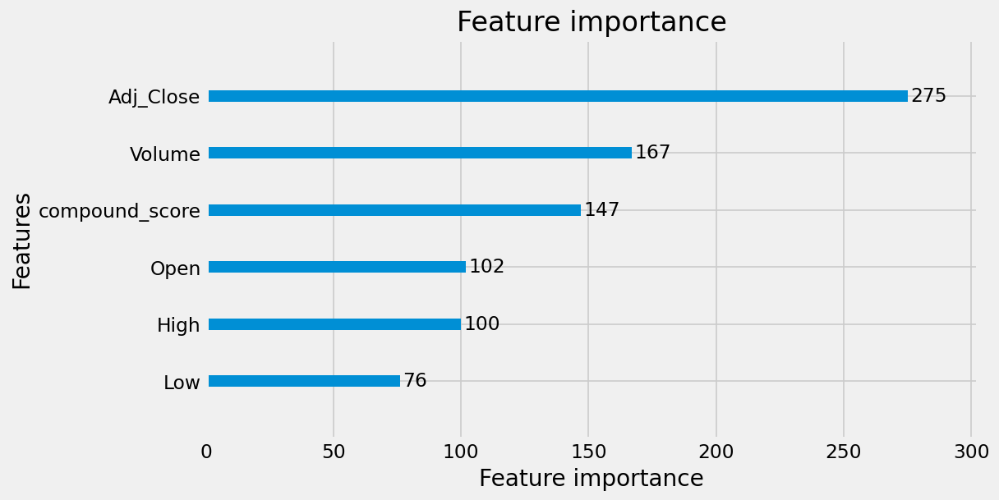

In [417]:
lgb.plot_importance(model)

<Axes: title={'center': 'Metric during training'}, xlabel='Iterations', ylabel='l2'>

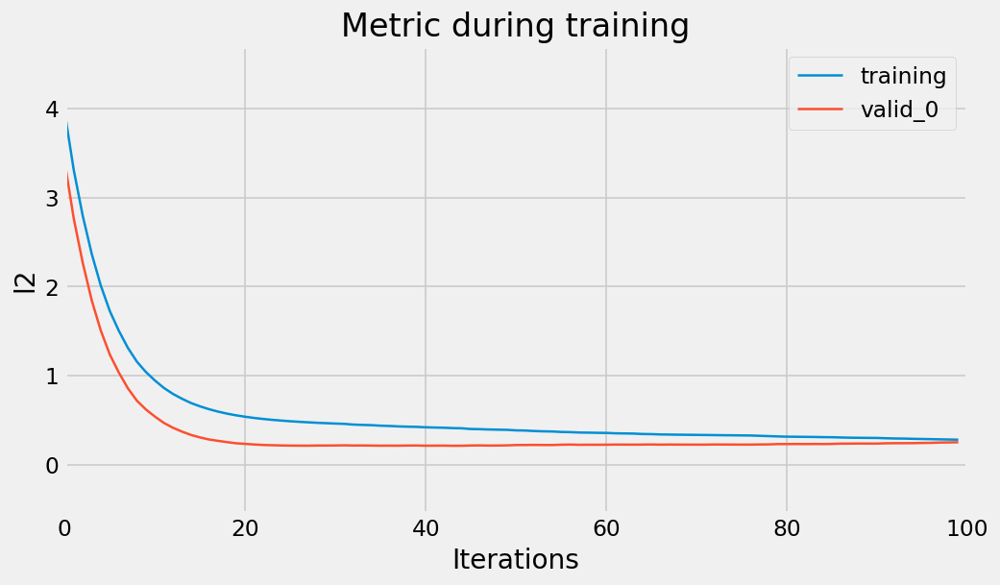

In [418]:
lgb.plot_metric(model)

In [419]:
from sklearn.model_selection import GridSearchCV
# Define a range of values for the hyperparameters to search through
param_grid = {
    'num_leaves': [5, 10, 20, 30],
    'learning_rate': [0.05, 0.1, 0.2, 0.3],
    'n_estimators': [50, 100, 150, 200]
}

In [420]:
# Initialize an empty dictionary to store the best hyperparameters and their values
best_hyperparameters = {}
best_values = {}
 
# Initialize the LightGBM classifier
lgb_regressor = lgb.LGBMRegressor(objective='regression', boosting_type='gbdt')
 
# Initialize GridSearchCV for hyperparameters
grid_search = GridSearchCV(estimator=lgb_regressor, param_grid=param_grid,
                           scoring='accuracy', cv=5)
 
# Fit the model to the training data to search for the best hyperparameters
grid_search.fit(x_train, y_train)
 
# Get the best hyperparameters and their values
best_params = grid_search.best_params_
best_hyperparameters = list(best_params.keys())
best_values = list(best_params.values())

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000037 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 402
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training from score -0.079673
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000040 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 402
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training from score 0.005423
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000040 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 402
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training from 

In [421]:
best_model = lgb.LGBMRegressor(**best_params)
best_model.fit(x_train, y_train)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 245, number of used features: 6
[LightGBM] [Info] Start training from score -0.040871


LGBMRegressor(learning_rate=0.05, n_estimators=50, num_leaves=5)

In [422]:
y_pred = best_model.predict(x_test)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Print metrics
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
print("R-squared (R2):", r2)

Mean Absolute Error (MAE): 0.19447992929288427
Mean Squared Error (MSE): 0.21247082164060374
Root Mean Squared Error (RMSE): 0.4609455734038496
R-squared (R2): 0.9487988662969243


In [423]:
X = AAPL_detrended_stationary.iloc[:, :6]
y = AAPL_detrended_stationary.iloc[:, 6]
n_features = X.shape[1]

# gradient boosted trees tend to do well on problems like this
reg = GradientBoostingRegressor(n_estimators=50, random_state=0)

In [424]:
space  = [Integer(1, 5, name='max_depth'),
          Real(10**-5, 10**0, "log-uniform", name='learning_rate'),
          Integer(1, n_features, name='max_features'),
          Integer(2, 100, name='min_samples_split'),
          Integer(1, 100, name='min_samples_leaf')]

# this decorator allows your objective function to receive a the parameters as
# keyword arguments. This is particularly convenient when you want to set
# scikit-learn estimator parameters
@use_named_args(space)
def objective(**params):
    reg.set_params(**params)

    return -np.mean(cross_val_score(reg, X, y, cv=5, n_jobs=-1,
                                    scoring="neg_mean_absolute_error"))

In [425]:
res_gp = gp_minimize(objective, space, n_calls=50, random_state=0)

"Best score=%.4f" % res_gp.fun

'Best score=0.0597'

In [426]:
print("""Best parameters:
- max_depth=%d
- learning_rate=%.6f
- max_features=%d
- min_samples_split=%d
- min_samples_leaf=%d""" % (res_gp.x[0], res_gp.x[1],
                            res_gp.x[2], res_gp.x[3],
                            res_gp.x[4]))

Best parameters:
- max_depth=5
- learning_rate=0.168888
- max_features=6
- min_samples_split=2
- min_samples_leaf=1


<Axes: title={'center': 'Convergence plot'}, xlabel='Number of calls $n$', ylabel='$\\min f(x)$ after $n$ calls'>

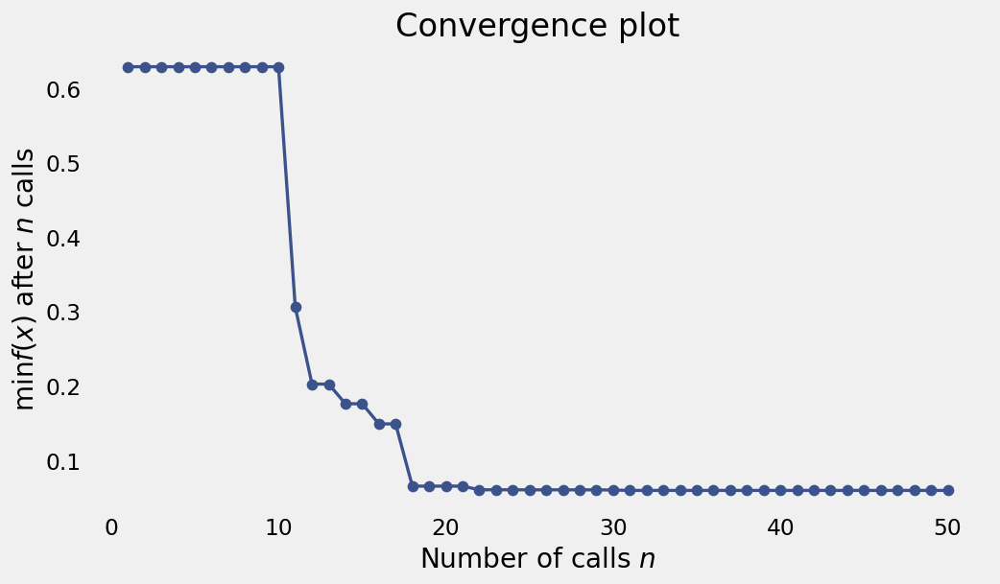

In [427]:
plot_convergence(res_gp)

## 2. AMZN

In [429]:
x = AAPL_detrended_stationary.iloc[:, :6] 
y = AAPL_detrended_stationary.iloc[:, 6]
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.33,random_state=42)

In [430]:
model = lgb.LGBMRegressor(random_state=42)
model.fit(x_train,y_train,eval_set=[(x_test,y_test),(x_train,y_train)])

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000038 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 245, number of used features: 6
[LightGBM] [Info] Start training from score -0.040871
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

LGBMRegressor(random_state=42)

In [431]:
print('Testing accuracy {:.4f}'.format(model.score(x_test,y_test)))

Testing accuracy 0.9397


<Axes: title={'center': 'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

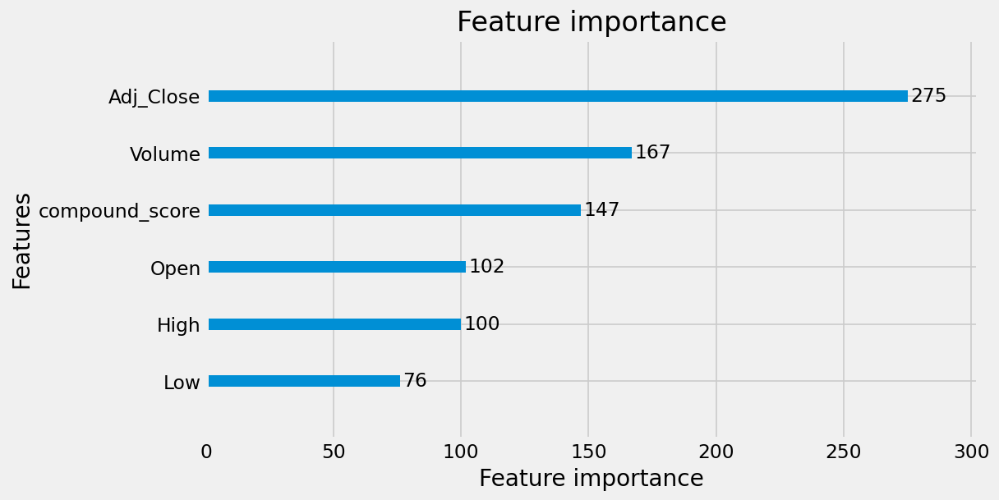

In [432]:
lgb.plot_importance(model)

<Axes: title={'center': 'Metric during training'}, xlabel='Iterations', ylabel='l2'>

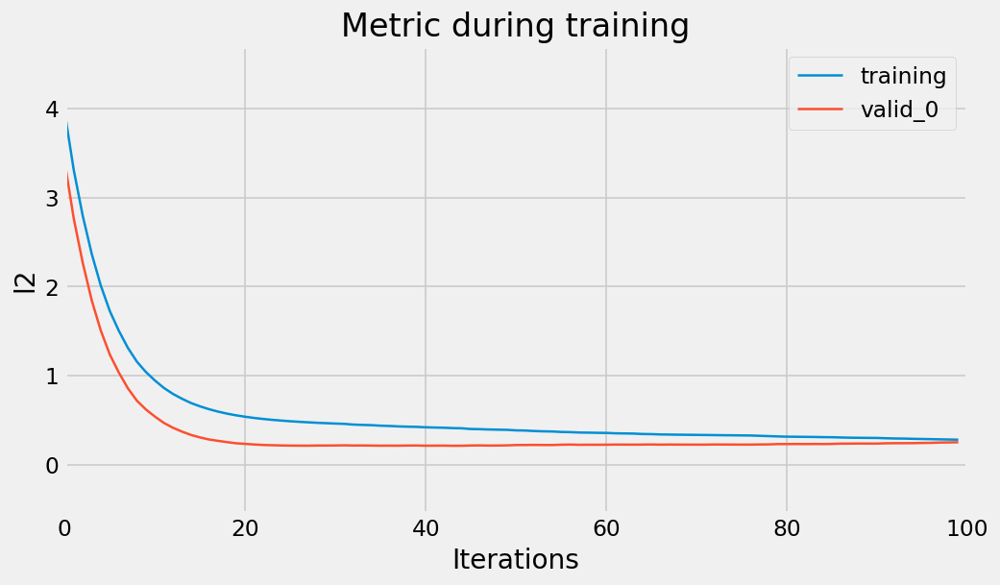

In [433]:
lgb.plot_metric(model)

In [434]:
param_grid = {
    'num_leaves': [5, 10, 20, 30],
    'learning_rate': [0.05, 0.1, 0.2, 0.3],
    'n_estimators': [50, 100, 150, 200]
}

In [435]:
# Initialize an empty dictionary to store the best hyperparameters and their values
best_hyperparameters = {}
best_values = {}
 
# Initialize the LightGBM classifier
lgb_regressor = lgb.LGBMRegressor(objective='regression', boosting_type='gbdt')
 
# Initialize GridSearchCV for hyperparameters
grid_search = GridSearchCV(estimator=lgb_regressor, param_grid=param_grid,
                           scoring='accuracy', cv=5)
 
# Fit the model to the training data to search for the best hyperparameters
grid_search.fit(x_train, y_train)
 
# Get the best hyperparameters and their values
best_params = grid_search.best_params_
best_hyperparameters = list(best_params.keys())
best_values = list(best_params.values())

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000044 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 402
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training from score -0.079673
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000107 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 402
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training from score 0.005423
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000028 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 402
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training from 

In [436]:
best_model = lgb.LGBMRegressor(**best_params)
best_model.fit(x_train, y_train)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 245, number of used features: 6
[LightGBM] [Info] Start training from score -0.040871


LGBMRegressor(learning_rate=0.05, n_estimators=50, num_leaves=5)

In [437]:
y_pred = best_model.predict(x_test)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Print metrics
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
print("R-squared (R2):", r2)

Mean Absolute Error (MAE): 0.19447992929288427
Mean Squared Error (MSE): 0.21247082164060374
Root Mean Squared Error (RMSE): 0.4609455734038496
R-squared (R2): 0.9487988662969243


In [438]:
X = AMZN_detrended_stationary.iloc[:, :6]
y = AMZN_detrended_stationary.iloc[:, 6]
n_features = X.shape[1]

# gradient boosted trees tend to do well on problems like this
reg = GradientBoostingRegressor(n_estimators=50, random_state=0)

In [439]:
space  = [Integer(1, 5, name='max_depth'),
          Real(10**-5, 10**0, "log-uniform", name='learning_rate'),
          Integer(1, n_features, name='max_features'),
          Integer(2, 100, name='min_samples_split'),
          Integer(1, 100, name='min_samples_leaf')]

# this decorator allows your objective function to receive a the parameters as
# keyword arguments. This is particularly convenient when you want to set
# scikit-learn estimator parameters
@use_named_args(space)
def objective(**params):
    reg.set_params(**params)

    return -np.mean(cross_val_score(reg, X, y, cv=5, n_jobs=-1,
                                    scoring="neg_mean_absolute_error"))

In [440]:
res_gp = gp_minimize(objective, space, n_calls=50, random_state=0)

"Best score=%.4f" % res_gp.fun

'Best score=0.1328'

In [441]:
print("""Best parameters:
- max_depth=%d
- learning_rate=%.6f
- max_features=%d
- min_samples_split=%d
- min_samples_leaf=%d""" % (res_gp.x[0], res_gp.x[1],
                            res_gp.x[2], res_gp.x[3],
                            res_gp.x[4]))

Best parameters:
- max_depth=5
- learning_rate=1.000000
- max_features=1
- min_samples_split=2
- min_samples_leaf=1


<Axes: title={'center': 'Convergence plot'}, xlabel='Number of calls $n$', ylabel='$\\min f(x)$ after $n$ calls'>

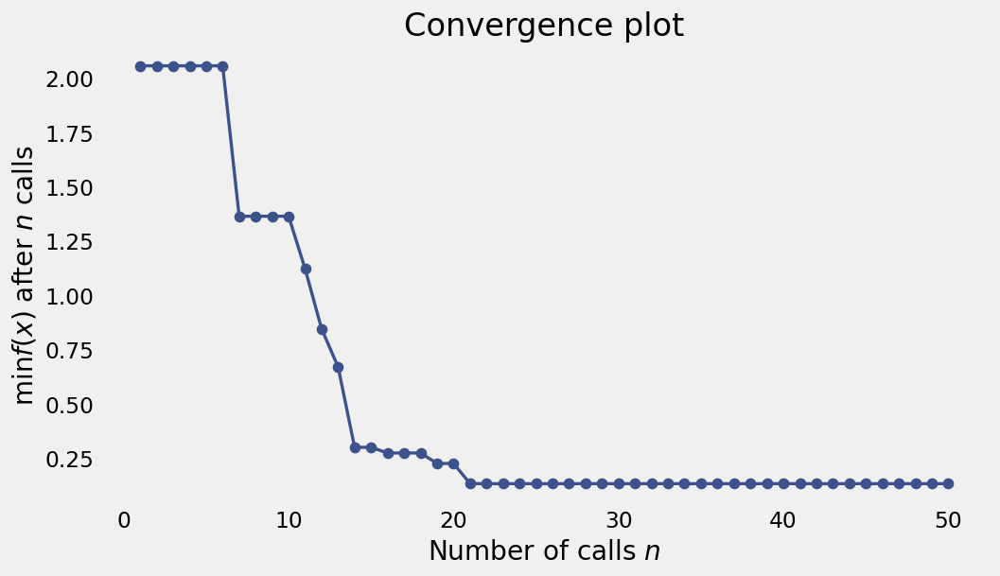

In [442]:
plot_convergence(res_gp)

## BA

In [444]:
x = BA_deseasonalised_stationary.iloc[:, :6] 
y = BA_deseasonalised_stationary.iloc[:, 6]
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.33,random_state=42)

In [445]:
model = lgb.LGBMRegressor(random_state=42)
model.fit(x_train,y_train,eval_set=[(x_test,y_test),(x_train,y_train)])

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 457
[LightGBM] [Info] Number of data points in the train set: 245, number of used features: 6
[LightGBM] [Info] Start training from score 197.201252
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

LGBMRegressor(random_state=42)

In [446]:
print('Testing accuracy {:.4f}'.format(model.score(x_test,y_test)))

Testing accuracy 0.9961


<Axes: title={'center': 'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

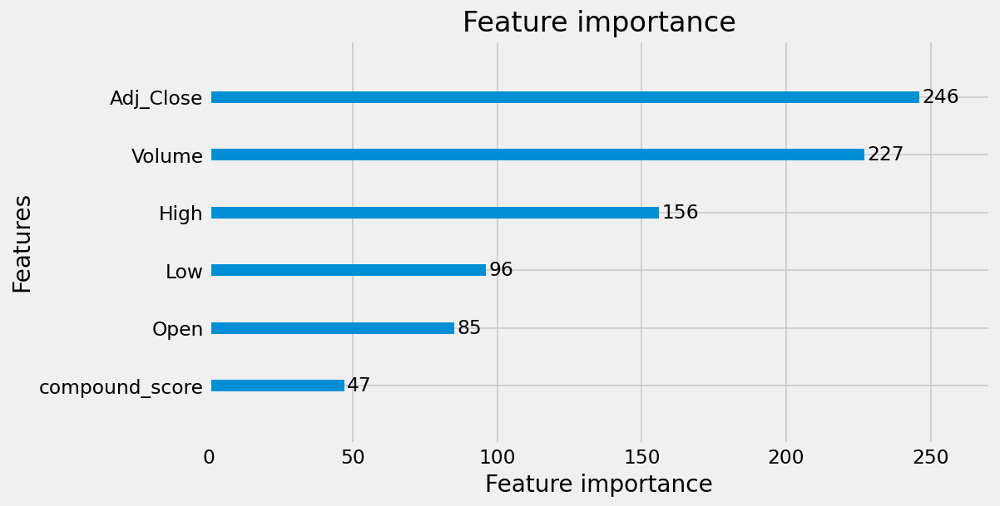

In [447]:
lgb.plot_importance(model)

<Axes: title={'center': 'Metric during training'}, xlabel='Iterations', ylabel='l2'>

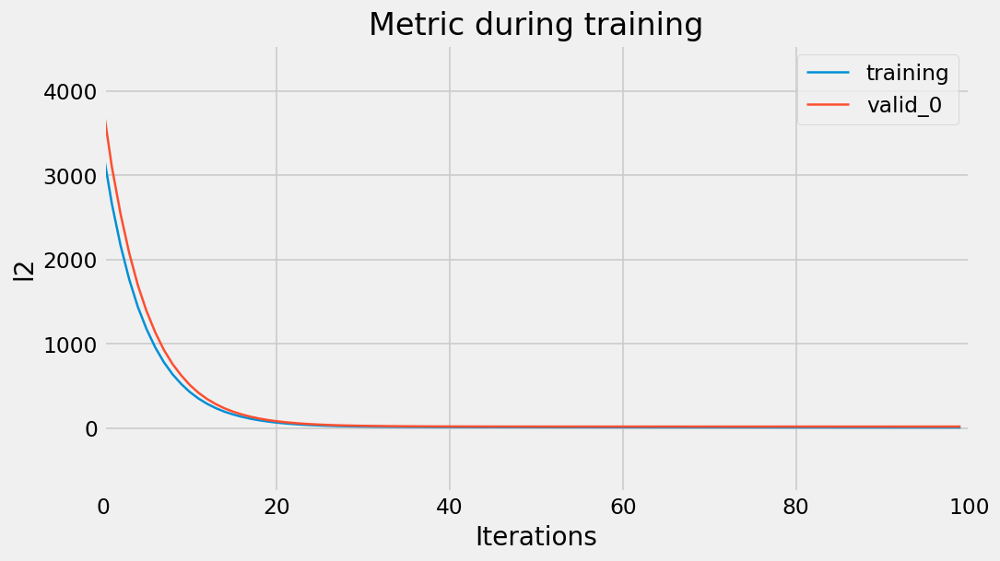

In [448]:
lgb.plot_metric(model)

In [449]:
param_grid = {
    'num_leaves': [5, 10, 20, 30],
    'learning_rate': [0.05, 0.1, 0.2, 0.3],
    'n_estimators': [50, 100, 150, 200]
}

In [450]:
# Initialize an empty dictionary to store the best hyperparameters and their values
best_hyperparameters = {}
best_values = {}
 
# Initialize the LightGBM classifier
lgb_regressor = lgb.LGBMRegressor(objective='regression', boosting_type='gbdt')
 
# Initialize GridSearchCV for hyperparameters
grid_search = GridSearchCV(estimator=lgb_regressor, param_grid=param_grid,
                           scoring='accuracy', cv=5)
 
# Fit the model to the training data to search for the best hyperparameters
grid_search.fit(x_train, y_train)
 
# Get the best hyperparameters and their values
best_params = grid_search.best_params_
best_hyperparameters = list(best_params.keys())
best_values = list(best_params.values())

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 370
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training from score 198.588994
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000104 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 365
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training from score 200.739074
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 369
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training fr

In [451]:
best_model = lgb.LGBMRegressor(**best_params)
best_model.fit(x_train, y_train)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000049 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 457
[LightGBM] [Info] Number of data points in the train set: 245, number of used features: 6
[LightGBM] [Info] Start training from score 197.201252


LGBMRegressor(learning_rate=0.05, n_estimators=50, num_leaves=5)

In [452]:
y_pred = best_model.predict(x_test)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Print metrics
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
print("R-squared (R2):", r2)

Mean Absolute Error (MAE): 4.835990227240491
Mean Squared Error (MSE): 53.54566678851583
Root Mean Squared Error (RMSE): 7.317490470681586
R-squared (R2): 0.9884546599056949


In [453]:
X = BA_deseasonalised_stationary.iloc[:, :6]
y = BA_deseasonalised_stationary.iloc[:, 6]
n_features = X.shape[1]

# gradient boosted trees tend to do well on problems like this
reg = GradientBoostingRegressor(n_estimators=50, random_state=0)

In [454]:
space  = [Integer(1, 5, name='max_depth'),
          Real(10**-5, 10**0, "log-uniform", name='learning_rate'),
          Integer(1, n_features, name='max_features'),
          Integer(2, 100, name='min_samples_split'),
          Integer(1, 100, name='min_samples_leaf')]

# this decorator allows your objective function to receive a the parameters as
# keyword arguments. This is particularly convenient when you want to set
# scikit-learn estimator parameters
@use_named_args(space)
def objective(**params):
    reg.set_params(**params)

    return -np.mean(cross_val_score(reg, X, y, cv=5, n_jobs=-1,
                                    scoring="neg_mean_absolute_error"))

In [455]:
res_gp = gp_minimize(objective, space, n_calls=50, random_state=0)

"Best score=%.4f" % res_gp.fun

'Best score=18.1321'

In [456]:
print("""Best parameters:
- max_depth=%d
- learning_rate=%.6f
- max_features=%d
- min_samples_split=%d
- min_samples_leaf=%d""" % (res_gp.x[0], res_gp.x[1],
                            res_gp.x[2], res_gp.x[3],
                            res_gp.x[4]))

Best parameters:
- max_depth=5
- learning_rate=0.154405
- max_features=6
- min_samples_split=2
- min_samples_leaf=1


<Axes: title={'center': 'Convergence plot'}, xlabel='Number of calls $n$', ylabel='$\\min f(x)$ after $n$ calls'>

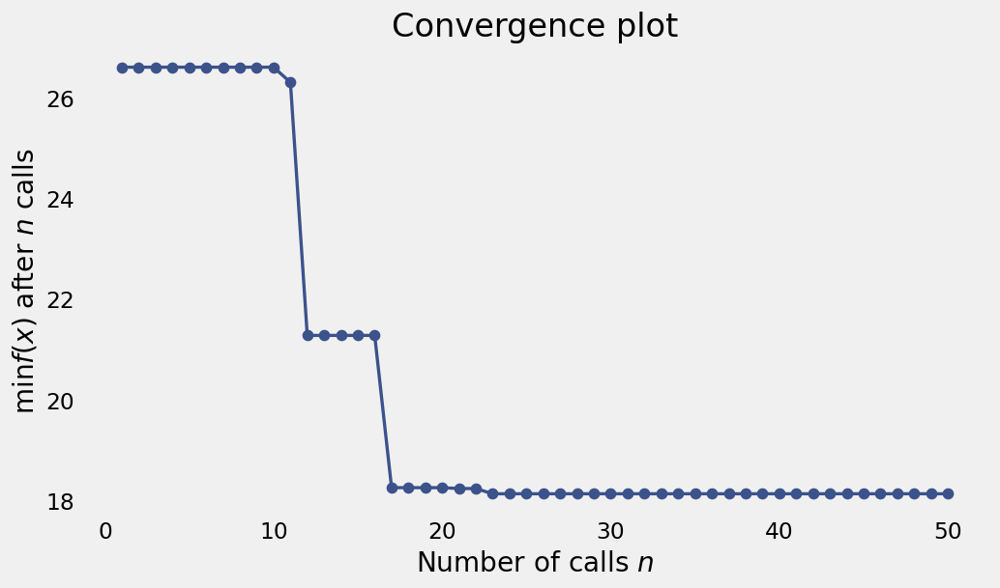

In [457]:
plot_convergence(res_gp)

## 4. DIS

In [459]:
x = DIS_deseasonalised_stationary.iloc[:, :6] 
y = DIS_deseasonalised_stationary.iloc[:, 6]
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.33,random_state=42)

In [460]:
model = lgb.LGBMRegressor(random_state=42)
model.fit(x_train,y_train,eval_set=[(x_test,y_test),(x_train,y_train)])

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000056 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 438
[LightGBM] [Info] Number of data points in the train set: 245, number of used features: 6
[LightGBM] [Info] Start training from score 125.895680
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

LGBMRegressor(random_state=42)

In [461]:
print('Testing accuracy {:.4f}'.format(model.score(x_test,y_test)))

Testing accuracy 0.9549


<Axes: title={'center': 'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

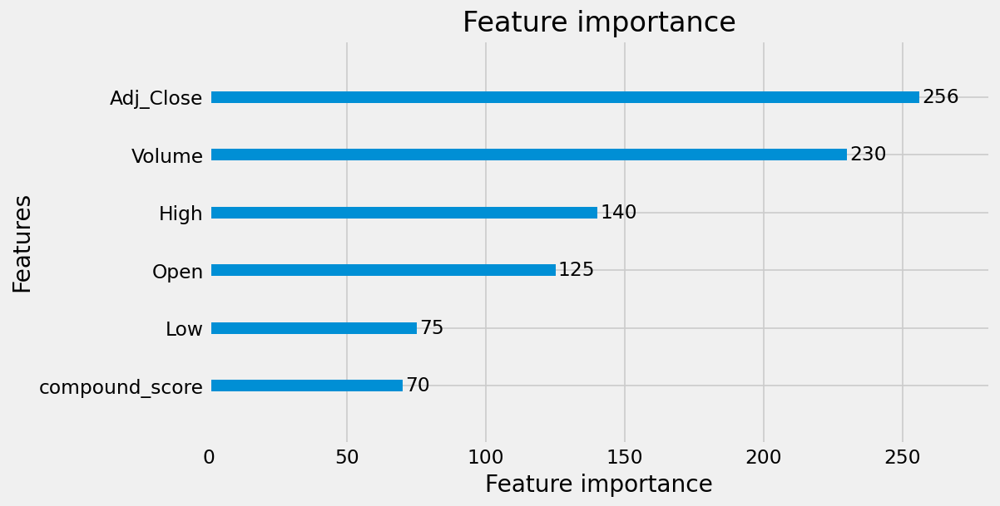

In [462]:
lgb.plot_importance(model)

<Axes: title={'center': 'Metric during training'}, xlabel='Iterations', ylabel='l2'>

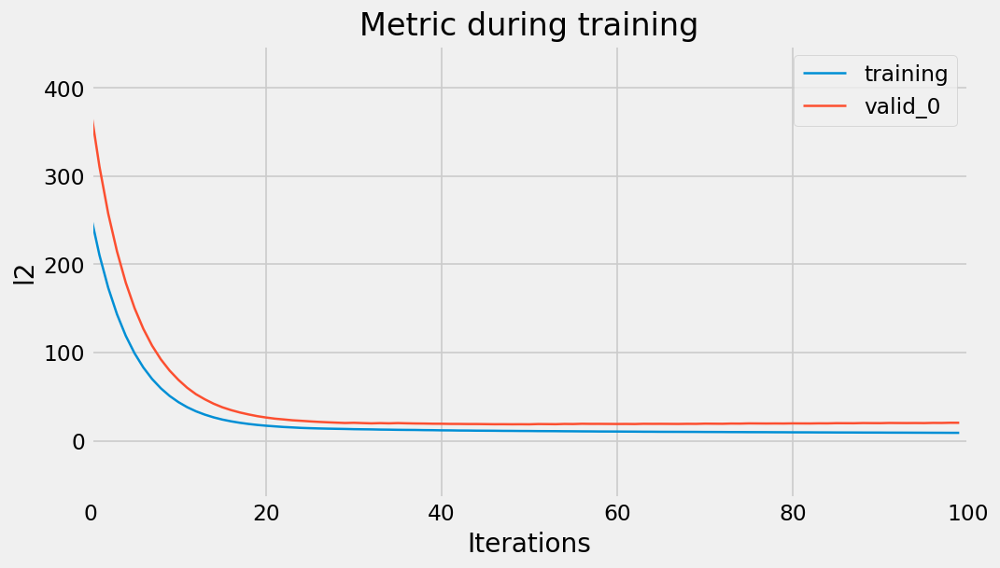

In [463]:
lgb.plot_metric(model)

In [464]:
param_grid = {
    'num_leaves': [5, 10, 20, 30],
    'learning_rate': [0.05, 0.1, 0.2, 0.3],
    'n_estimators': [50, 100, 150, 200]
}

In [465]:
# Initialize an empty dictionary to store the best hyperparameters and their values
best_hyperparameters = {}
best_values = {}
 
# Initialize the LightGBM classifier
lgb_regressor = lgb.LGBMRegressor(objective='regression', boosting_type='gbdt')
 
# Initialize GridSearchCV for hyperparameters
grid_search = GridSearchCV(estimator=lgb_regressor, param_grid=param_grid,
                           scoring='accuracy', cv=5)
 
# Fit the model to the training data to search for the best hyperparameters
grid_search.fit(x_train, y_train)
 
# Get the best hyperparameters and their values
best_params = grid_search.best_params_
best_hyperparameters = list(best_params.keys())
best_values = list(best_params.values())

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 354
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training from score 126.845330
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000273 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 354
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training from score 126.223117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000037 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 354
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training fr

In [466]:
best_model = lgb.LGBMRegressor(**best_params)
best_model.fit(x_train, y_train)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 438
[LightGBM] [Info] Number of data points in the train set: 245, number of used features: 6
[LightGBM] [Info] Start training from score 125.895680


LGBMRegressor(learning_rate=0.05, n_estimators=50, num_leaves=5)

In [467]:
y_pred = best_model.predict(x_test)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Print metrics
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
print("R-squared (R2):", r2)

Mean Absolute Error (MAE): 2.7312259748657572
Mean Squared Error (MSE): 23.69751820653775
Root Mean Squared Error (RMSE): 4.8680096760932745
R-squared (R2): 0.9475127261039484


In [468]:
X = DIS_deseasonalised_stationary.iloc[:, :6]
y = DIS_deseasonalised_stationary.iloc[:, 6]
n_features = X.shape[1]

# gradient boosted trees tend to do well on problems like this
reg = GradientBoostingRegressor(n_estimators=50, random_state=0)

In [469]:
space  = [Integer(1, 5, name='max_depth'),
          Real(10**-5, 10**0, "log-uniform", name='learning_rate'),
          Integer(1, n_features, name='max_features'),
          Integer(2, 100, name='min_samples_split'),
          Integer(1, 100, name='min_samples_leaf')]

# this decorator allows your objective function to receive a the parameters as
# keyword arguments. This is particularly convenient when you want to set
# scikit-learn estimator parameters
@use_named_args(space)
def objective(**params):
    reg.set_params(**params)

    return -np.mean(cross_val_score(reg, X, y, cv=5, n_jobs=-1,
                                    scoring="neg_mean_absolute_error"))

In [470]:
res_gp = gp_minimize(objective, space, n_calls=50, random_state=0)

"Best score=%.4f" % res_gp.fun

'Best score=2.1151'

In [471]:
print("""Best parameters:
- max_depth=%d
- learning_rate=%.6f
- max_features=%d
- min_samples_split=%d
- min_samples_leaf=%d""" % (res_gp.x[0], res_gp.x[1],
                            res_gp.x[2], res_gp.x[3],
                            res_gp.x[4]))

Best parameters:
- max_depth=5
- learning_rate=0.253172
- max_features=6
- min_samples_split=2
- min_samples_leaf=1


<Axes: title={'center': 'Convergence plot'}, xlabel='Number of calls $n$', ylabel='$\\min f(x)$ after $n$ calls'>

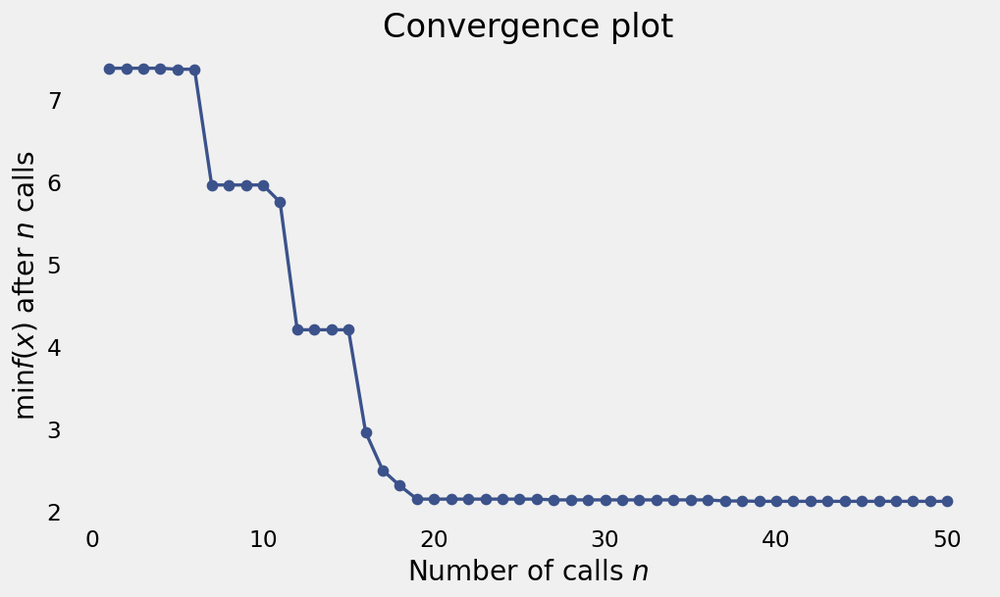

In [472]:
plot_convergence(res_gp)

## 5. TSLA

In [474]:
x = TSLA_detrended_stationary.iloc[:, :6] 
y = TSLA_detrended_stationary.iloc[:, 6]
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.33,random_state=42)

In [475]:
model = lgb.LGBMRegressor(random_state=42)
model.fit(x_train,y_train,eval_set=[(x_test,y_test),(x_train,y_train)])

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000113 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 245, number of used features: 6
[LightGBM] [Info] Start training from score -0.029513
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

LGBMRegressor(random_state=42)

In [476]:
print('Testing accuracy {:.4f}'.format(model.score(x_test,y_test)))

Testing accuracy 0.9394


<Axes: title={'center': 'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

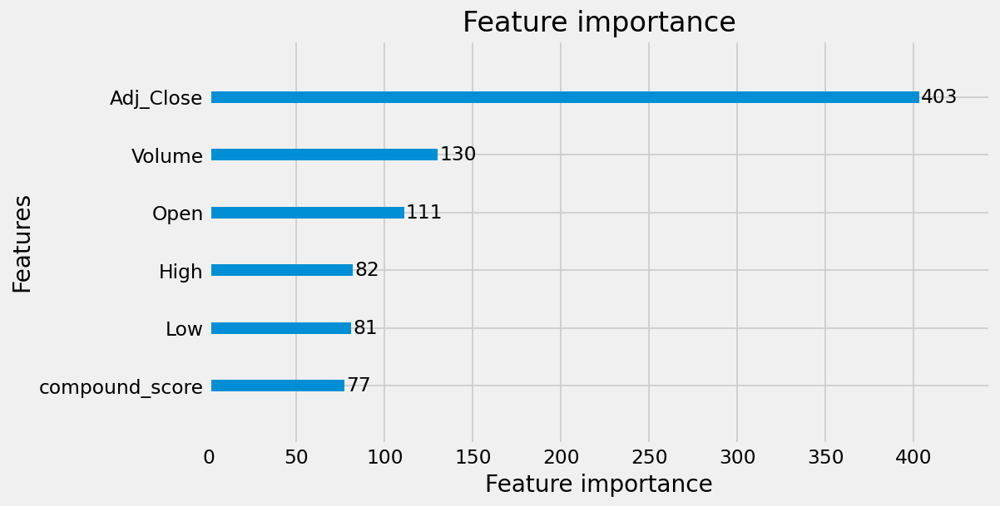

In [477]:
lgb.plot_importance(model)

<Axes: title={'center': 'Metric during training'}, xlabel='Iterations', ylabel='l2'>

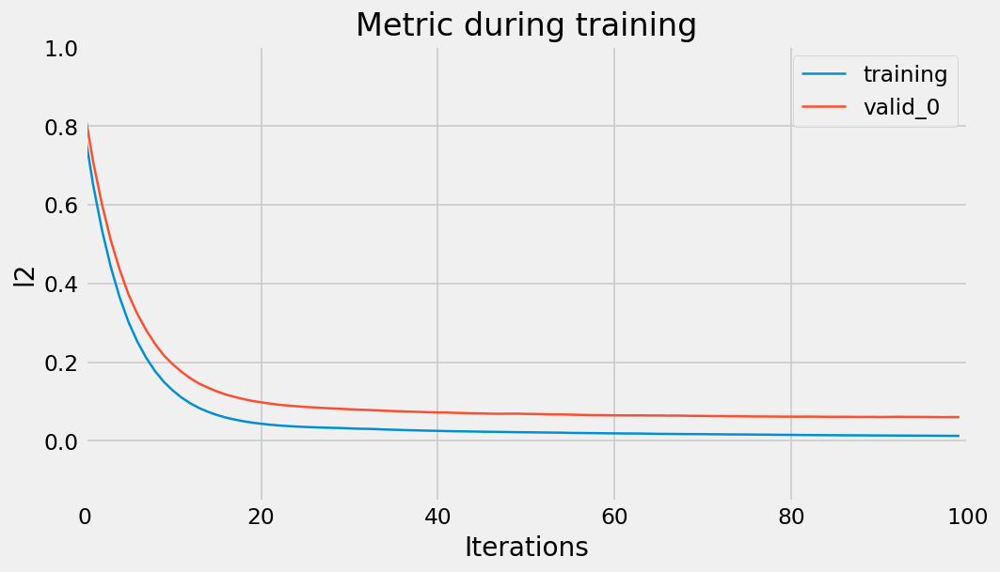

In [478]:
lgb.plot_metric(model)

In [479]:
param_grid = {
    'num_leaves': [5, 10, 20, 30],
    'learning_rate': [0.05, 0.1, 0.2, 0.3],
    'n_estimators': [50, 100, 150, 200]
}

In [480]:
# Initialize an empty dictionary to store the best hyperparameters and their values
best_hyperparameters = {}
best_values = {}
 
# Initialize the LightGBM classifier
lgb_regressor = lgb.LGBMRegressor(objective='regression', boosting_type='gbdt')
 
# Initialize GridSearchCV for hyperparameters
grid_search = GridSearchCV(estimator=lgb_regressor, param_grid=param_grid,
                           scoring='accuracy', cv=5)
 
# Fit the model to the training data to search for the best hyperparameters
grid_search.fit(x_train, y_train)
 
# Get the best hyperparameters and their values
best_params = grid_search.best_params_
best_hyperparameters = list(best_params.keys())
best_values = list(best_params.values())

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000033 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 402
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training from score -0.001524
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000033 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 402
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training from score -0.050733
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 402
[LightGBM] [Info] Number of data points in the train set: 196, number of used features: 6
[LightGBM] [Info] Start training from

In [481]:
best_model = lgb.LGBMRegressor(**best_params)
best_model.fit(x_train, y_train)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000039 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 245, number of used features: 6
[LightGBM] [Info] Start training from score -0.029513


LGBMRegressor(learning_rate=0.05, n_estimators=50, num_leaves=5)

In [482]:
y_pred = best_model.predict(x_test)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Print metrics
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
print("R-squared (R2):", r2)

Mean Absolute Error (MAE): 0.10314988914420459
Mean Squared Error (MSE): 0.08997782585614067
Root Mean Squared Error (RMSE): 0.2999630408169324
R-squared (R2): 0.9093754364295996


In [483]:
X = TSLA_detrended_stationary.iloc[:, :6]
y = TSLA_detrended_stationary.iloc[:, 6]
n_features = X.shape[1]

# gradient boosted trees tend to do well on problems like this
reg = GradientBoostingRegressor(n_estimators=50, random_state=0)

In [484]:
space  = [Integer(1, 5, name='max_depth'),
          Real(10**-5, 10**0, "log-uniform", name='learning_rate'),
          Integer(1, n_features, name='max_features'),
          Integer(2, 100, name='min_samples_split'),
          Integer(1, 100, name='min_samples_leaf')]

# this decorator allows your objective function to receive a the parameters as
# keyword arguments. This is particularly convenient when you want to set
# scikit-learn estimator parameters
@use_named_args(space)
def objective(**params):
    reg.set_params(**params)

    return -np.mean(cross_val_score(reg, X, y, cv=5, n_jobs=-1,
                                    scoring="neg_mean_absolute_error"))

In [485]:
res_gp = gp_minimize(objective, space, n_calls=50, random_state=0)

"Best score=%.4f" % res_gp.fun

'Best score=0.0200'

In [486]:
print("""Best parameters:
- max_depth=%d
- learning_rate=%.6f
- max_features=%d
- min_samples_split=%d
- min_samples_leaf=%d""" % (res_gp.x[0], res_gp.x[1],
                            res_gp.x[2], res_gp.x[3],
                            res_gp.x[4]))

Best parameters:
- max_depth=4
- learning_rate=0.111412
- max_features=6
- min_samples_split=2
- min_samples_leaf=1


<Axes: title={'center': 'Convergence plot'}, xlabel='Number of calls $n$', ylabel='$\\min f(x)$ after $n$ calls'>

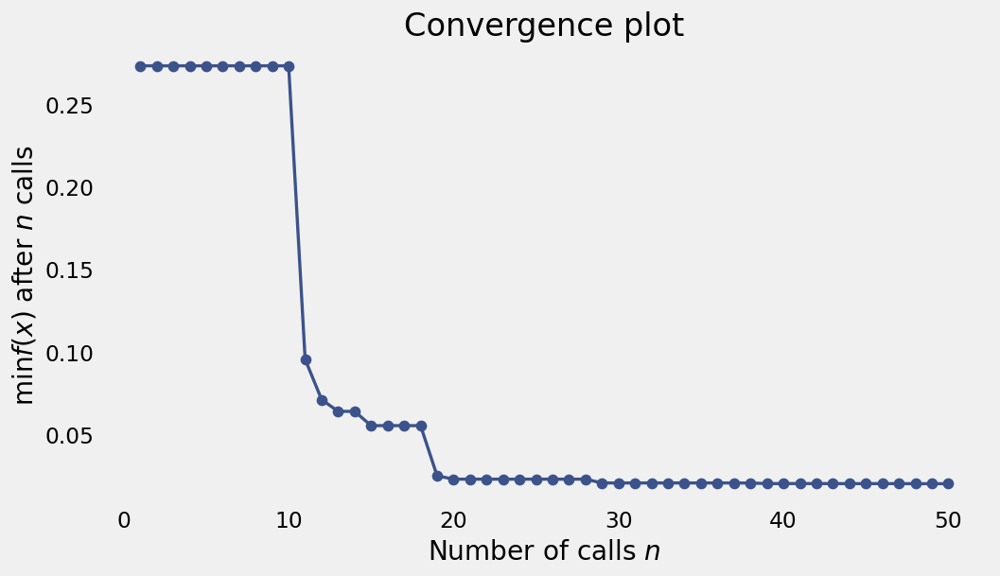

In [487]:
plot_convergence(res_gp)